In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import keras
import sklearn
import os

In [ ]:
from google.colab import files
uploaded = files.upload()


Saving test_FD001.txt to test_FD001.txt
Saving test_FD002.txt to test_FD002.txt
Saving test_FD003.txt to test_FD003.txt
Saving test_FD004.txt to test_FD004.txt
Saving train_FD001.txt to train_FD001.txt
Saving train_FD002.txt to train_FD002.txt
Saving train_FD003.txt to train_FD003.txt
Saving train_FD004.txt to train_FD004.txt


In [ ]:
test_1 = pd.read_csv("test_FD001.txt",sep=" ",header=None)
test_2 = pd.read_csv("test_FD002.txt",sep=" ",header=None)
test_3 = pd.read_csv("test_FD003.txt",sep=" ",header=None)
test_4 = pd.read_csv("test_FD004.txt",sep=" ",header=None)

train_1 = pd.read_csv("train_FD001.txt",sep=" ",header=None)
train_2 = pd.read_csv("train_FD002.txt",sep=" ",header=None)
train_3 = pd.read_csv("train_FD003.txt",sep=" ",header=None)
train_4 = pd.read_csv("train_FD004.txt",sep=" ",header=None)

In [ ]:
test_1.head(10)

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735,NaN,NaN
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916,NaN,NaN
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166,NaN,NaN
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737,NaN,NaN
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130,NaN,NaN
5,1,6,0.0012,0.0003,100.0,518.67,642.11,1579.12,1395.13,14.62,...,8127.46,8.4238,0.03,392,2388,100.0,38.91,23.3467,NaN,NaN
6,1,7,-0.0000,0.0002,100.0,518.67,642.11,1583.34,1404.84,14.62,...,8134.97,8.3914,0.03,391,2388,100.0,38.85,23.3952,NaN,NaN
7,1,8,0.0006,-0.0000,100.0,518.67,642.54,1580.89,1400.89,14.62,...,8125.93,8.4213,0.03,393,2388,100.0,39.05,23.3224,NaN,NaN
8,1,9,-0.0036,0.0000,100.0,518.67,641.88,1593.29,1412.28,14.62,...,8134.15,8.4353,0.03,391,2388,100.0,39.10,23.4521,NaN,NaN
9,1,10,-0.0025,-0.0001,100.0,518.67,642.07,1585.25,1398.64,14.62,...,8134.08,8.4093,0.03,391,2388,100.0,38.87,23.3820,NaN,NaN


In [ ]:
test_2.head(10)

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,9.9987,0.2502,100.0,489.05,605.03,1497.17,1304.99,10.52,...,8114.10,8.6476,0.03,369,2319,100.00,28.42,17.1551,NaN,NaN
1,1,2,20.0026,0.7000,100.0,491.19,607.82,1481.20,1246.11,9.35,...,8053.06,9.2405,0.02,364,2324,100.00,24.29,14.8039,NaN,NaN
2,1,3,35.0045,0.8400,100.0,449.44,556.00,1359.08,1128.36,5.48,...,8053.04,9.3472,0.02,333,2223,100.00,14.98,8.9125,NaN,NaN
3,1,4,42.0066,0.8410,100.0,445.00,550.17,1349.69,1127.89,3.91,...,8066.90,9.3961,0.02,332,2212,100.00,10.35,6.4181,NaN,NaN
4,1,5,24.9985,0.6213,60.0,462.54,536.72,1253.18,1050.69,7.05,...,7865.66,10.8682,0.02,305,1915,84.93,14.31,8.5740,NaN,NaN
5,1,6,25.0006,0.6206,60.0,462.54,536.62,1258.90,1047.35,7.05,...,7859.98,10.9378,0.02,307,1915,84.93,14.26,8.4941,NaN,NaN
6,1,7,42.0017,0.8400,100.0,445.00,549.47,1351.28,1124.43,3.91,...,8069.15,9.3595,0.02,330,2212,100.00,10.57,6.3555,NaN,NaN
7,1,8,41.9994,0.8404,100.0,445.00,549.49,1349.20,1126.95,3.91,...,8068.88,9.3753,0.02,330,2212,100.00,10.67,6.2992,NaN,NaN
8,1,9,35.0005,0.8408,100.0,449.44,555.64,1357.76,1133.32,5.48,...,8054.19,9.3341,0.02,336,2223,100.00,14.84,8.9374,NaN,NaN
9,1,10,20.0001,0.7000,100.0,491.19,607.33,1483.66,1261.66,9.35,...,8045.67,9.2522,0.02,365,2324,100.00,24.47,14.6186,NaN,NaN


In [ ]:
test_3.head(10)

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,-0.0017,-0.0004,100.0,518.67,641.94,1581.93,1396.93,14.62,...,8133.48,8.3760,0.03,391,2388,100.0,39.07,23.4468,NaN,NaN
1,1,2,0.0006,-0.0002,100.0,518.67,642.02,1584.86,1398.90,14.62,...,8137.44,8.4062,0.03,391,2388,100.0,39.04,23.4807,NaN,NaN
2,1,3,0.0014,-0.0003,100.0,518.67,641.68,1581.78,1391.92,14.62,...,8138.25,8.3553,0.03,391,2388,100.0,39.10,23.4244,NaN,NaN
3,1,4,0.0027,0.0001,100.0,518.67,642.20,1584.53,1395.34,14.62,...,8137.07,8.3709,0.03,392,2388,100.0,38.97,23.4782,NaN,NaN
4,1,5,-0.0001,0.0001,100.0,518.67,642.46,1589.03,1395.86,14.62,...,8134.20,8.4146,0.03,391,2388,100.0,39.09,23.3950,NaN,NaN
5,1,6,-0.0034,0.0001,100.0,518.67,641.74,1582.87,1397.04,14.62,...,8134.28,8.3647,0.03,390,2388,100.0,38.98,23.4050,NaN,NaN
6,1,7,0.0009,-0.0003,100.0,518.67,642.21,1582.20,1396.77,14.62,...,8140.20,8.3942,0.03,390,2388,100.0,39.00,23.3512,NaN,NaN
7,1,8,-0.0004,-0.0003,100.0,518.67,641.90,1582.12,1400.20,14.62,...,8137.84,8.3864,0.03,391,2388,100.0,39.12,23.4069,NaN,NaN
8,1,9,-0.0018,0.0005,100.0,518.67,642.61,1582.37,1399.10,14.62,...,8135.78,8.3710,0.03,392,2388,100.0,39.19,23.3813,NaN,NaN
9,1,10,-0.0026,-0.0005,100.0,518.67,641.36,1587.44,1397.07,14.62,...,8142.22,8.3950,0.03,392,2388,100.0,39.23,23.4534,NaN,NaN


In [ ]:
test_4.head(10)

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,20.0072,0.7000,100.0,491.19,606.67,1481.04,1227.81,9.35,...,8048.98,9.2229,0.02,362,2324,100.00,24.31,14.7007,NaN,NaN
1,1,2,24.9984,0.6200,60.0,462.54,536.22,1256.17,1031.48,7.05,...,7863.46,10.8632,0.02,306,1915,84.93,14.36,8.5748,NaN,NaN
2,1,3,42.0000,0.8420,100.0,445.00,549.23,1340.13,1105.88,3.91,...,8071.13,9.3960,0.02,328,2212,100.00,10.39,6.4365,NaN,NaN
3,1,4,42.0035,0.8402,100.0,445.00,549.19,1339.70,1107.26,3.91,...,8078.89,9.3594,0.02,328,2212,100.00,10.56,6.2367,NaN,NaN
4,1,5,35.0079,0.8400,100.0,449.44,555.10,1353.04,1117.80,5.48,...,8057.83,9.3030,0.02,333,2223,100.00,14.85,8.9326,NaN,NaN
5,1,6,25.0010,0.6203,60.0,462.54,536.40,1255.38,1043.74,7.05,...,7867.38,10.8661,0.02,304,1915,84.93,14.17,8.6135,NaN,NaN
6,1,7,19.9996,0.7015,100.0,491.19,607.29,1473.03,1230.62,9.35,...,8052.97,9.1925,0.02,362,2324,100.00,24.52,14.6965,NaN,NaN
7,1,8,35.0015,0.8414,100.0,449.44,554.81,1361.07,1115.14,5.48,...,8055.81,9.3004,0.02,331,2223,100.00,14.84,8.9004,NaN,NaN
8,1,9,19.9980,0.7000,100.0,491.19,607.35,1481.89,1240.15,9.35,...,8052.46,9.1965,0.02,362,2324,100.00,24.34,14.6079,NaN,NaN
9,1,10,42.0033,0.8416,100.0,445.00,549.30,1342.24,1106.32,3.91,...,8075.89,9.3860,0.02,328,2212,100.00,10.45,6.3830,NaN,NaN


In [ ]:
train_1.head(10)

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,NaN,NaN
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,NaN,NaN
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,NaN,NaN
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,NaN,NaN
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,NaN,NaN
5,1,6,-0.0043,-0.0001,100.0,518.67,642.10,1584.47,1398.37,14.62,...,8132.85,8.4108,0.03,391,2388,100.0,38.98,23.3669,NaN,NaN
6,1,7,0.0010,0.0001,100.0,518.67,642.48,1592.32,1397.77,14.62,...,8132.32,8.3974,0.03,392,2388,100.0,39.10,23.3774,NaN,NaN
7,1,8,-0.0034,0.0003,100.0,518.67,642.56,1582.96,1400.97,14.62,...,8131.07,8.4076,0.03,391,2388,100.0,38.97,23.3106,NaN,NaN
8,1,9,0.0008,0.0001,100.0,518.67,642.12,1590.98,1394.80,14.62,...,8125.69,8.3728,0.03,392,2388,100.0,39.05,23.4066,NaN,NaN
9,1,10,-0.0033,0.0001,100.0,518.67,641.71,1591.24,1400.46,14.62,...,8129.38,8.4286,0.03,393,2388,100.0,38.95,23.4694,NaN,NaN


In [ ]:
train_2.head(10)

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,34.9983,0.8400,100.0,449.44,555.32,1358.61,1137.23,5.48,...,8048.56,9.3461,0.02,334,2223,100.00,14.73,8.8071,NaN,NaN
1,1,2,41.9982,0.8408,100.0,445.00,549.90,1353.22,1125.78,3.91,...,8072.30,9.3774,0.02,330,2212,100.00,10.41,6.2665,NaN,NaN
2,1,3,24.9988,0.6218,60.0,462.54,537.31,1256.76,1047.45,7.05,...,7864.87,10.8941,0.02,309,1915,84.93,14.08,8.6723,NaN,NaN
3,1,4,42.0077,0.8416,100.0,445.00,549.51,1354.03,1126.38,3.91,...,8068.66,9.3528,0.02,329,2212,100.00,10.59,6.4701,NaN,NaN
4,1,5,25.0005,0.6203,60.0,462.54,537.07,1257.71,1047.93,7.05,...,7861.23,10.8963,0.02,309,1915,84.93,14.13,8.5286,NaN,NaN
5,1,6,25.0045,0.6205,60.0,462.54,537.02,1266.38,1048.72,7.05,...,7868.87,10.8912,0.02,306,1915,84.93,14.28,8.5590,NaN,NaN
6,1,7,42.0043,0.8409,100.0,445.00,549.74,1347.45,1127.19,3.91,...,8075.54,9.3753,0.02,330,2212,100.00,10.62,6.4227,NaN,NaN
7,1,8,20.0020,0.7002,100.0,491.19,607.44,1481.69,1252.36,9.35,...,8049.26,9.2369,0.02,365,2324,100.00,24.33,14.7989,NaN,NaN
8,1,9,41.9995,0.8407,100.0,445.00,549.33,1348.23,1127.45,3.91,...,8065.78,9.3878,0.02,331,2212,100.00,10.69,6.3802,NaN,NaN
9,1,10,42.0011,0.8400,100.0,445.00,549.33,1356.40,1127.11,3.91,...,8069.11,9.3957,0.02,329,2212,100.00,10.57,6.2847,NaN,NaN


In [ ]:
train_3.head(10)

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,-0.0005,0.0004,100.0,518.67,642.36,1583.23,1396.84,14.62,...,8145.32,8.4246,0.03,391,2388,100.0,39.11,23.3537,NaN,NaN
1,1,2,0.0008,-0.0003,100.0,518.67,642.50,1584.69,1396.89,14.62,...,8152.85,8.4403,0.03,392,2388,100.0,38.99,23.4491,NaN,NaN
2,1,3,-0.0014,-0.0002,100.0,518.67,642.18,1582.35,1405.61,14.62,...,8150.17,8.3901,0.03,391,2388,100.0,38.85,23.3669,NaN,NaN
3,1,4,-0.0020,0.0001,100.0,518.67,642.92,1585.61,1392.27,14.62,...,8146.56,8.3878,0.03,392,2388,100.0,38.96,23.2951,NaN,NaN
4,1,5,0.0016,0.0000,100.0,518.67,641.68,1588.63,1397.65,14.62,...,8147.80,8.3869,0.03,392,2388,100.0,39.14,23.4583,NaN,NaN
5,1,6,0.0011,-0.0005,100.0,518.67,642.24,1584.09,1400.01,14.62,...,8144.92,8.4152,0.03,393,2388,100.0,38.92,23.4281,NaN,NaN
6,1,7,-0.0038,0.0002,100.0,518.67,642.58,1585.61,1401.09,14.62,...,8147.05,8.3842,0.03,391,2388,100.0,38.84,23.4087,NaN,NaN
7,1,8,-0.0007,-0.0005,100.0,518.67,642.32,1588.32,1397.08,14.62,...,8157.34,8.4190,0.03,391,2388,100.0,39.05,23.4590,NaN,NaN
8,1,9,-0.0026,0.0000,100.0,518.67,641.64,1587.81,1406.51,14.62,...,8147.20,8.4091,0.03,392,2388,100.0,38.99,23.4693,NaN,NaN
9,1,10,0.0019,-0.0002,100.0,518.67,642.42,1587.39,1402.25,14.62,...,8152.86,8.3987,0.03,391,2388,100.0,38.94,23.4781,NaN,NaN


In [ ]:
train_4.head(10)

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,42.0049,0.8400,100.0,445.00,549.68,1343.43,1112.93,3.91,...,8074.83,9.3335,0.02,330,2212,100.00,10.62,6.3670,NaN,NaN
1,1,2,20.0020,0.7002,100.0,491.19,606.07,1477.61,1237.50,9.35,...,8046.13,9.1913,0.02,361,2324,100.00,24.37,14.6552,NaN,NaN
2,1,3,42.0038,0.8409,100.0,445.00,548.95,1343.12,1117.05,3.91,...,8066.62,9.4007,0.02,329,2212,100.00,10.48,6.4213,NaN,NaN
3,1,4,42.0000,0.8400,100.0,445.00,548.70,1341.24,1118.03,3.91,...,8076.05,9.3369,0.02,328,2212,100.00,10.54,6.4176,NaN,NaN
4,1,5,25.0063,0.6207,60.0,462.54,536.10,1255.23,1033.59,7.05,...,7865.80,10.8366,0.02,305,1915,84.93,14.03,8.6754,NaN,NaN
5,1,6,34.9996,0.8400,100.0,449.44,554.77,1352.87,1117.01,5.48,...,8054.10,9.3346,0.02,330,2223,100.00,14.91,8.9057,NaN,NaN
6,1,7,0.0019,0.0001,100.0,518.67,641.83,1583.47,1393.89,14.62,...,8127.92,8.3960,0.03,391,2388,100.00,38.93,23.4578,NaN,NaN
7,1,8,41.9981,0.8400,100.0,445.00,549.05,1344.16,1110.77,3.91,...,8075.99,9.3679,0.02,329,2212,100.00,10.55,6.2787,NaN,NaN
8,1,9,42.0016,0.8400,100.0,445.00,549.55,1342.85,1101.67,3.91,...,8071.13,9.3384,0.02,328,2212,100.00,10.63,6.3055,NaN,NaN
9,1,10,25.0019,0.6217,60.0,462.54,536.35,1251.91,1041.37,7.05,...,7869.41,10.9141,0.02,305,1915,84.93,14.34,8.6119,NaN,NaN


In [ ]:
test_1.drop(columns=[26,27],inplace=True)
test_2.drop(columns=[26,27],inplace=True)
test_3.drop(columns=[26,27],inplace=True)
test_4.drop(columns=[26,27],inplace=True)

In [ ]:
train_1.drop(columns=[26,27],inplace=True)
train_2.drop(columns=[26,27],inplace=True)
train_3.drop(columns=[26,27],inplace=True)
train_4.drop(columns=[26,27],inplace=True)

In [ ]:
# Printing the shape of each DataFrame
print(f"Shape of test_1: {test_1.shape}")
print(f"Shape of test_2: {test_2.shape}")
print(f"Shape of test_3: {test_3.shape}")
print(f"Shape of test_4: {test_4.shape}")

print(f"Shape of train_1: {train_1.shape}")
print(f"Shape of train_2: {train_2.shape}")
print(f"Shape of train_3: {train_3.shape}")
print(f"Shape of train_4: {train_4.shape}")

Shape of test_1: (13096, 26)
Shape of test_2: (33991, 26)
Shape of test_3: (16596, 26)
Shape of test_4: (41214, 26)
Shape of train_1: (20631, 26)
Shape of train_2: (53759, 26)
Shape of train_3: (24720, 26)
Shape of train_4: (61249, 26)


In [ ]:
columns = ['engine', 'cycle', 'setting1', 'setting2', 'setting3', 'sensor1',
       'sensor2', 'sensor3', 'sensor4', 'sensor5', 'sensor6', 'sensor7',
       'sensor8', 'sensor9', 'sensor10', 'sensor11', 'sensor12', 'sensor13',
       'sensor14', 'sensor15', 'sensor16', 'sensor17', 'sensor18', 'sensor19',
       'sensor20', 'sensor21', ]

In [ ]:
test_1.columns = columns
test_2.columns = columns
test_3.columns = columns
test_4.columns = columns

train_1.columns = columns
train_2.columns = columns
train_3.columns = columns
train_4.columns = columns

In [ ]:
test_1.head()

,engine,cycle,setting1,setting2,setting3,sensor1,sensor2,sensor3,sensor4,sensor5,...,sensor12,sensor13,sensor14,sensor15,sensor16,sensor17,sensor18,sensor19,sensor20,sensor21
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130


Complete column descriptions¶
Here are the complete column names and explanations:

engine: engine number

cycle: cycle number

setting1: operation setting 1

setting2: operation setting 2

setting3: Operational setting 3

sensor1: Total fan inlet temperature (°R)

sensor2: Total temperature at the outlet of the low-pressure compressor (°R)

sensor3: Total temperature at the outlet of the high pressure compressor (°R)

sensor4: Low pressure turbine outlet total temperature (°R)

sensor5: Fan inlet pressure (psia)

sensor6: Total pressure in the bypass duct (psia)

sensor7: total pressure at the outlet of the high pressure compressor (psia)

sensor8: physical fan speed (rpm

sensor9: physical core speed (rpm)

sensor10: engine pressure ratio (ratio)

sensor11: High Pressure Compressor Outlet Static Pressure (Ps30) (psia)

sensor12: Ratio of Fuel Flow to High Pressure Compressor Outlet Static Pressure (pps/psi)

sensor13: Fan Conversion Speed (rpm)

sensor14: Core Conversion Speed (rpm)

sensor15: Culvert ratio (ratio)

sensor16: burner flow ratio (ratio)

sensor17: Sensor 17 data (unit not provided)

sensor18: Sensor 18 data (unit not supplied)

sensor19: sensor19 data (unit not supplied)

sensor20: sensor20 data (unit not provided)

sensor21: sensor21 data (unit not provided)

ruler_value: Remaining useful life (RUL)

In [ ]:
test_1.describe()

,engine,cycle,setting1,setting2,setting3,sensor1,sensor2,sensor3,sensor4,sensor5,...,sensor12,sensor13,sensor14,sensor15,sensor16,sensor17,sensor18,sensor19,sensor20,sensor21
count,13096.000000,13096.000000,13096.000000,13096.000000,13096.0,1.309600e+04,13096.000000,13096.000000,13096.000000,1.309600e+04,...,13096.000000,13096.000000,13096.000000,13096.000000,1.309600e+04,13096.000000,13096.0,13096.0,13096.000000,13096.000000
mean,51.543907,76.836515,-0.000011,0.000004,100.0,5.186700e+02,642.475088,1588.099204,1404.735362,1.462000e+01,...,521.747724,2388.071025,8138.947817,8.425844,3.000000e-02,392.571625,2388.0,100.0,38.892502,23.335743
std,28.289423,53.057749,0.002203,0.000294,0.0,6.014263e-11,0.400899,5.003274,6.688309,2.671743e-12,...,0.559627,0.056934,10.188605,0.029009,8.823140e-15,1.233577,0.0,0.0,0.141681,0.084120
min,1.000000,1.000000,-0.008200,-0.000600,100.0,5.186700e+02,641.130000,1569.040000,1384.390000,1.462000e+01,...,519.380000,2387.890000,8108.500000,8.332800,3.000000e-02,389.000000,2388.0,100.0,38.310000,22.935400
25%,28.000000,33.000000,-0.001500,-0.000200,100.0,5.186700e+02,642.197500,1584.600000,1399.950000,1.462000e+01,...,521.380000,2388.030000,8132.310000,8.405600,3.000000e-02,392.000000,2388.0,100.0,38.800000,23.281600
50%,52.000000,69.000000,-0.000000,-0.000000,100.0,5.186700e+02,642.460000,1587.990000,1404.440000,1.462000e+01,...,521.780000,2388.070000,8138.390000,8.424900,3.000000e-02,393.000000,2388.0,100.0,38.900000,23.339200
75%,76.000000,113.000000,0.001500,0.000300,100.0,5.186700e+02,642.740000,1591.362500,1409.050000,1.462000e+01,...,522.150000,2388.110000,8144.360000,8.444300,3.000000e-02,393.000000,2388.0,100.0,38.990000,23.393600
max,100.000000,303.000000,0.007800,0.000700,100.0,5.186700e+02,644.300000,1607.550000,1433.360000,1.462000e+01,...,523.760000,2388.320000,8220.480000,8.541400,3.000000e-02,397.000000,2388.0,100.0,39.410000,23.641900


In [ ]:
variances = train_1.iloc[:, 2:-2].var().sort_values()
print(variances)

setting3    0.000000e+00
sensor19    0.000000e+00
sensor18    0.000000e+00
sensor16    2.422479e-28
sensor10    2.172333e-25
sensor5     1.152399e-23
sensor1     4.273435e-21
setting2    8.588541e-08
sensor6     1.929279e-06
setting1    4.784340e-06
sensor15    1.406628e-03
sensor8     5.038938e-03
sensor13    5.172330e-03
sensor11    7.133568e-02
sensor2     2.500533e-01
sensor12    5.439850e-01
sensor7     7.833883e-01
sensor17    2.398667e+00
sensor3     3.759099e+01
sensor4     8.101089e+01
sensor14    3.639005e+02
sensor9     4.876536e+02
dtype: float64


In [ ]:
variances = train_2.iloc[:, 2:-2].var().sort_values()
print(variances)

sensor16         0.000022
sensor10         0.016248
setting2         0.096110
sensor15         0.561504
sensor11        10.448229
sensor5         13.059831
sensor19        28.773210
sensor6         29.504469
setting3       202.713087
setting1       217.485101
sensor1        696.416652
sensor17       770.313126
sensor2       1390.499279
sensor14      7197.477708
sensor3      11224.627089
sensor4      14190.391000
sensor13     16401.482048
sensor12     18950.139854
sensor8      21085.890683
sensor18     21120.221812
sensor7      21317.549421
sensor9     112769.707858
dtype: float64


In [ ]:
 variances = train_3.iloc[:, 2:-2].var().sort_values()
 print(variances)

setting3    0.000000e+00
sensor19    0.000000e+00
sensor18    0.000000e+00
sensor16    3.063800e-28
sensor5     1.297818e-23
sensor1     4.468817e-21
setting2    8.646122e-08
setting1    4.811638e-06
sensor10    1.214417e-05
sensor6     3.281895e-04
sensor15    3.661655e-03
sensor13    2.500215e-02
sensor8     2.505412e-02
sensor11    9.004450e-02
sensor2     2.735616e-01
sensor17    3.102736e+00
sensor12    1.059707e+01
sensor7     1.181533e+01
sensor3     4.638179e+01
sensor4     9.551501e+01
sensor14    2.723859e+02
sensor9     3.992122e+02
dtype: float64


In [ ]:
 variances = train_4.iloc[:, 2:-2].var().sort_values()
 print(variances)

sensor16         0.000022
sensor10         0.016302
setting2         0.096537
sensor15         0.563061
sensor11        10.520237
sensor5         13.125202
sensor19        28.830710
sensor6         29.637316
setting3       203.118191
setting1       218.469733
sensor1        698.906067
sensor17       773.300629
sensor2       1394.473263
sensor14      7339.442015
sensor3      11271.558809
sensor4      14239.073899
sensor13     16434.691116
sensor12     19176.463675
sensor8      21126.111710
sensor18     21162.245693
sensor7      21573.795950
sensor9     113520.171620
dtype: float64


In [ ]:
 variances = test_1.iloc[:, 2:-2].var().sort_values()
 print(variances)

setting3    0.000000e+00
sensor19    0.000000e+00
sensor18    0.000000e+00
sensor16    7.784781e-29
sensor10    9.970405e-26
sensor5     7.138209e-24
sensor1     3.617136e-21
setting2    8.645397e-08
sensor6     2.903905e-06
setting1    4.851822e-06
sensor15    8.415411e-04
sensor13    3.241516e-03
sensor8     3.299559e-03
sensor11    3.838357e-02
sensor2     1.607203e-01
sensor12    3.131821e-01
sensor7     4.641508e-01
sensor17    1.521712e+00
sensor3     2.503275e+01
sensor4     4.473348e+01
sensor14    1.038077e+02
sensor9     1.307881e+02
dtype: float64


In [ ]:
 variances = test_2.iloc[:, 2:-2].var().sort_values()
 print(variances)

sensor16         0.000022
sensor10         0.016308
setting2         0.096720
sensor15         0.558920
sensor11        10.416856
sensor5         13.132151
sensor19        28.691140
sensor6         29.668456
setting3       202.134891
setting1       218.417614
sensor1        699.850393
sensor17       770.587900
sensor2       1394.195642
sensor14      7027.307566
sensor3      11231.584364
sensor4      14170.382266
sensor13     16355.451111
sensor12     19072.933064
sensor8      21061.479964
sensor18     21093.403596
sensor7      21458.522999
sensor9     112758.795273
dtype: float64


In [ ]:
 variances = test_3.iloc[:, 2:-2].var().sort_values()
 print(variances)

setting3    0.000000e+00
sensor19    0.000000e+00
sensor18    0.000000e+00
sensor16    1.616943e-28
sensor5     9.543018e-24
sensor1     3.981370e-21
setting2    8.655042e-08
sensor10    4.498166e-06
setting1    4.845981e-06
sensor6     2.721474e-04
sensor15    1.708339e-03
sensor13    2.243123e-02
sensor8     2.256201e-02
sensor11    4.720402e-02
sensor2     1.754351e-01
sensor17    1.934629e+00
sensor12    4.466831e+00
sensor7     5.000511e+00
sensor3     3.067584e+01
sensor4     5.112772e+01
sensor14    9.948611e+01
sensor9     1.440429e+02
dtype: float64


In [ ]:
 variances = test_4.iloc[:, 2:-2].var().sort_values()
 print(variances)

sensor16         0.000021
sensor10         0.016108
setting2         0.095400
sensor15         0.554039
sensor11        10.326729
sensor5         12.975177
sensor19        28.666135
sensor6         29.274831
setting3       201.958728
setting1       216.516857
sensor1        692.819018
sensor17       762.029139
sensor2       1378.612431
sensor14      7077.308679
sensor3      11114.035224
sensor4      13972.745258
sensor13     16339.954693
sensor12     18899.943599
sensor8      20949.285929
sensor18     20986.935704
sensor7      21265.945314
sensor9     111861.043394
dtype: float64


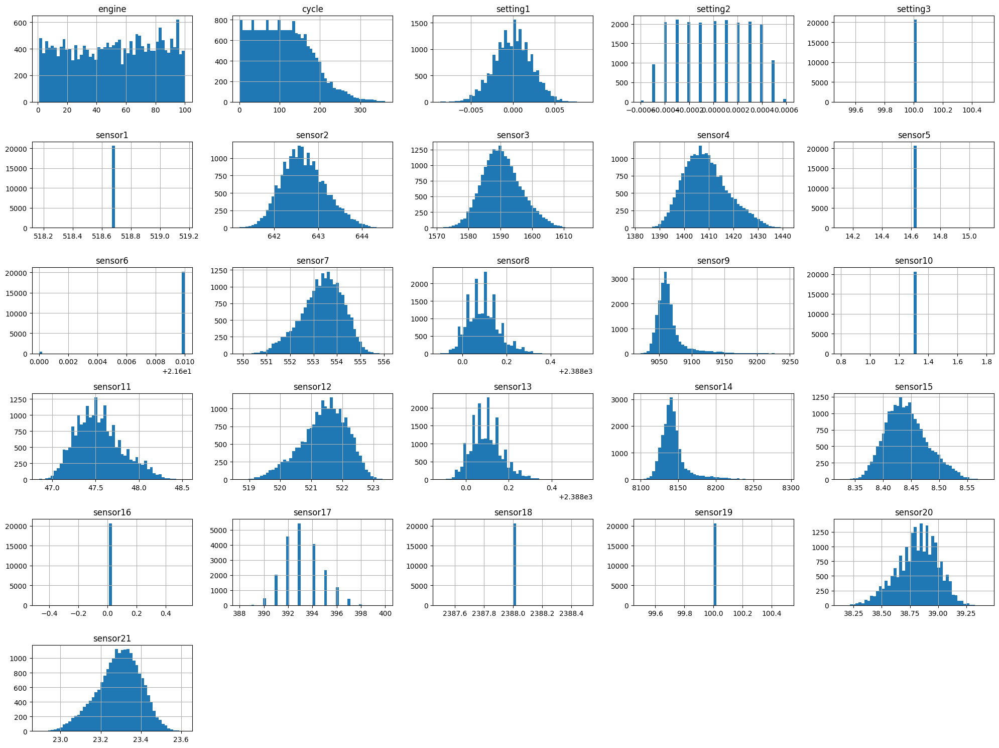

In [ ]:
train_1.hist(bins=50, figsize=(20,15))
plt.tight_layout()
plt.show()

Sensors 1,5,10,16,18,19 are single point spikes means constant values means no predictive values, we can consider dropping. Sensors 2,3,4,7,12,15,20,21 etc ( proper bell shape ) best for modelling. Skewed sensors indicate engine failure relatively.

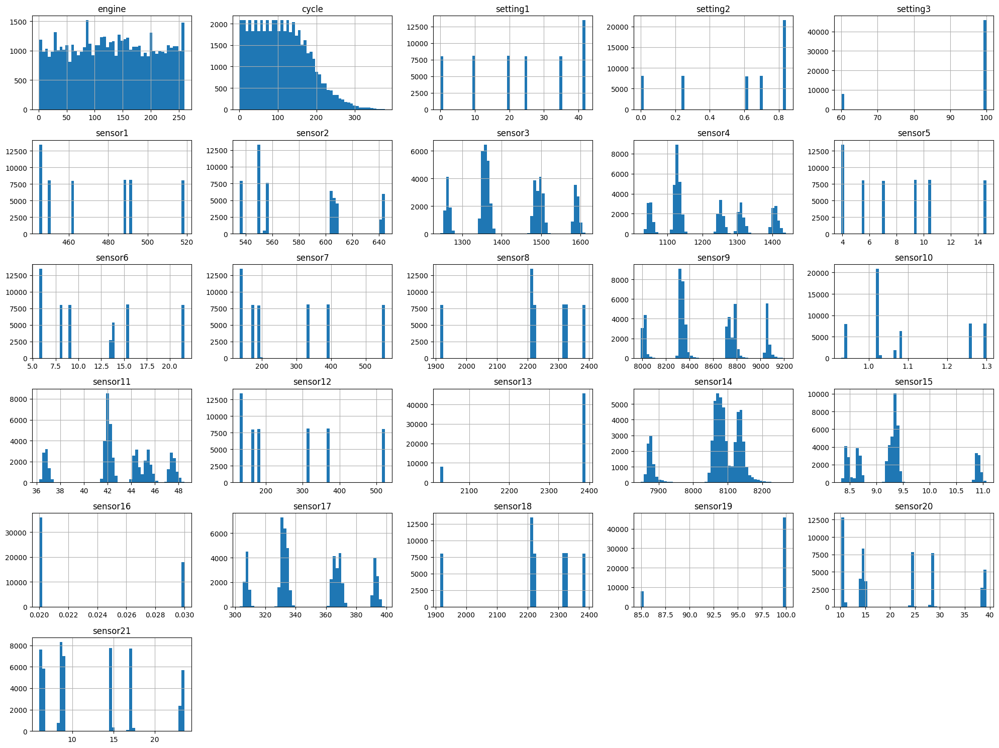

In [ ]:
 train_2.hist(bins=50, figsize=(20,15))
 plt.tight_layout()
 plt.show()

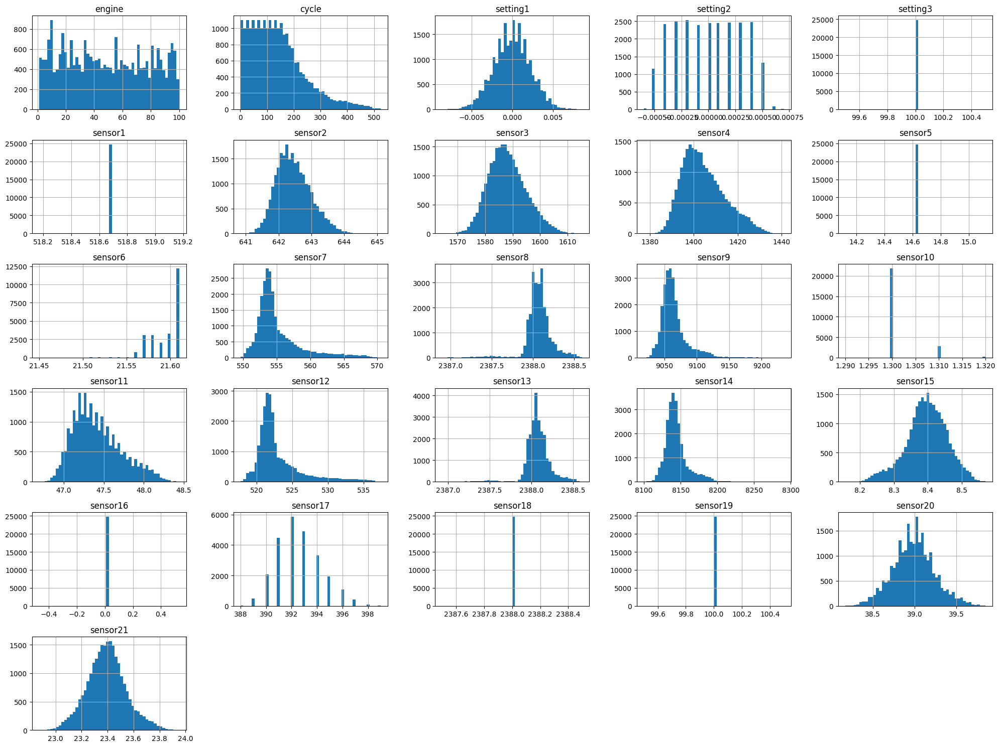

In [ ]:
 train_3.hist(bins=50, figsize=(20,15))
 plt.tight_layout()
 plt.show()

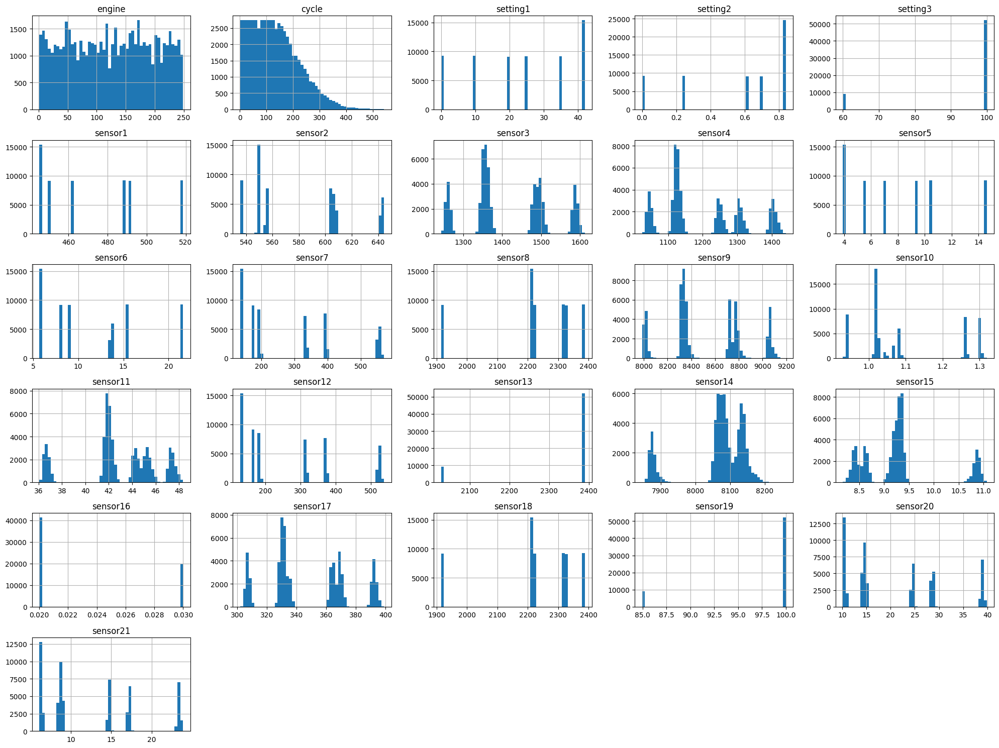

In [ ]:
 train_4.hist(bins=50, figsize=(20,15))
 plt.tight_layout()
 plt.show()

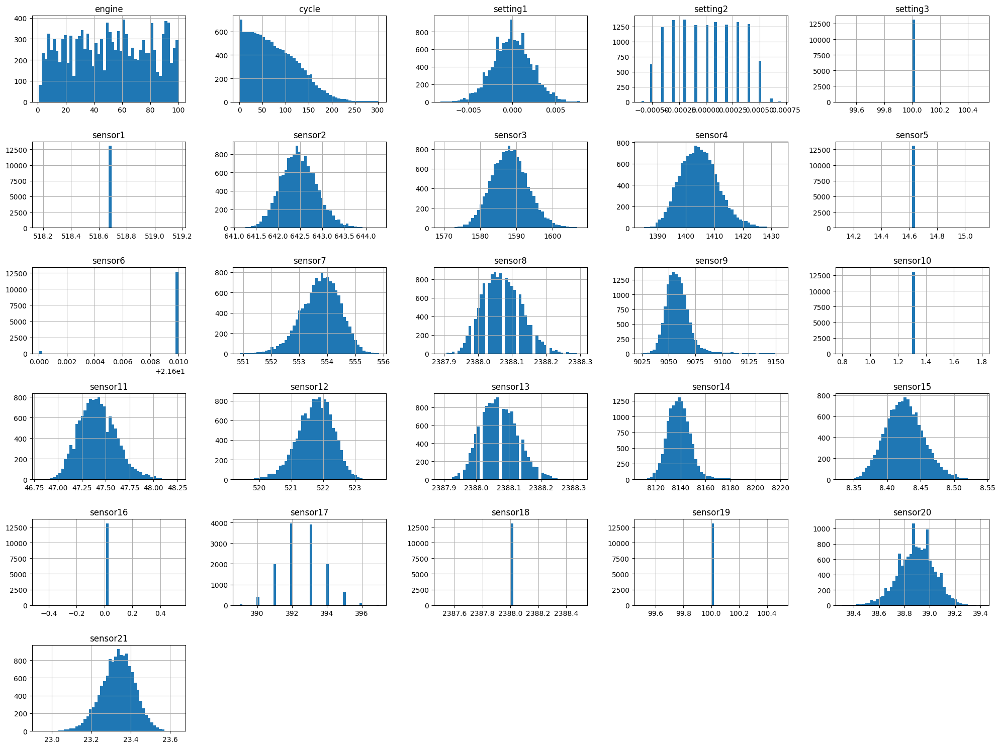

In [ ]:
 test_1.hist(bins=50, figsize=(20,15))
 plt.tight_layout()
 plt.show()

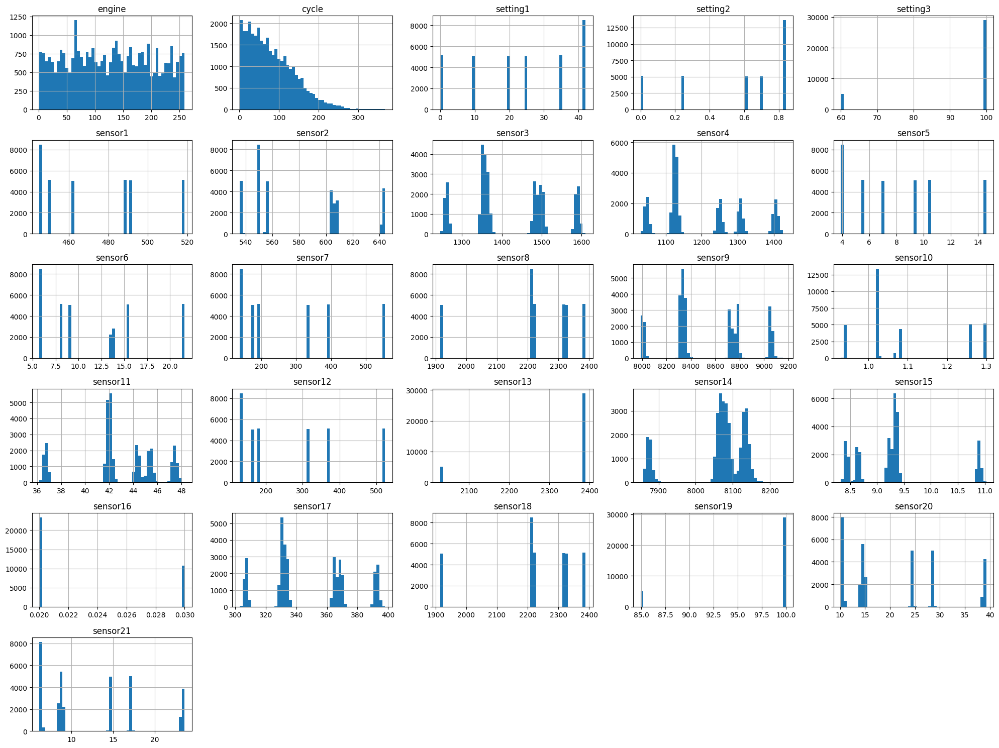

In [ ]:
 test_2.hist(bins=50, figsize=(20,15))
 plt.tight_layout()
 plt.show()

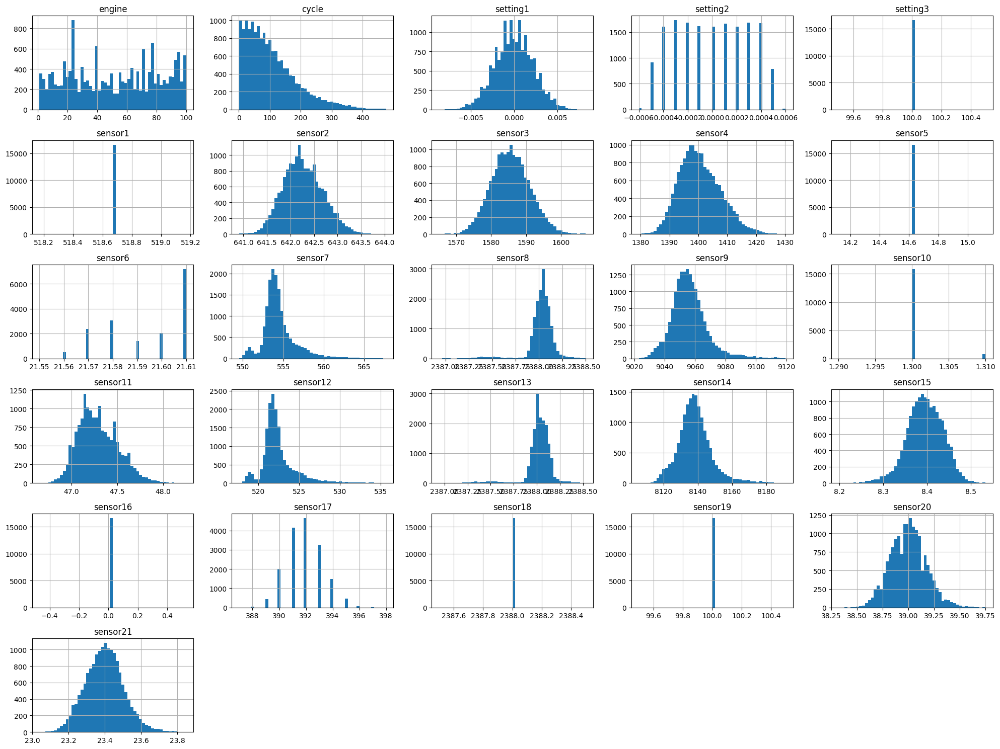

In [ ]:
test_3.hist(bins=50, figsize=(20,15))
plt.tight_layout()
plt.show()

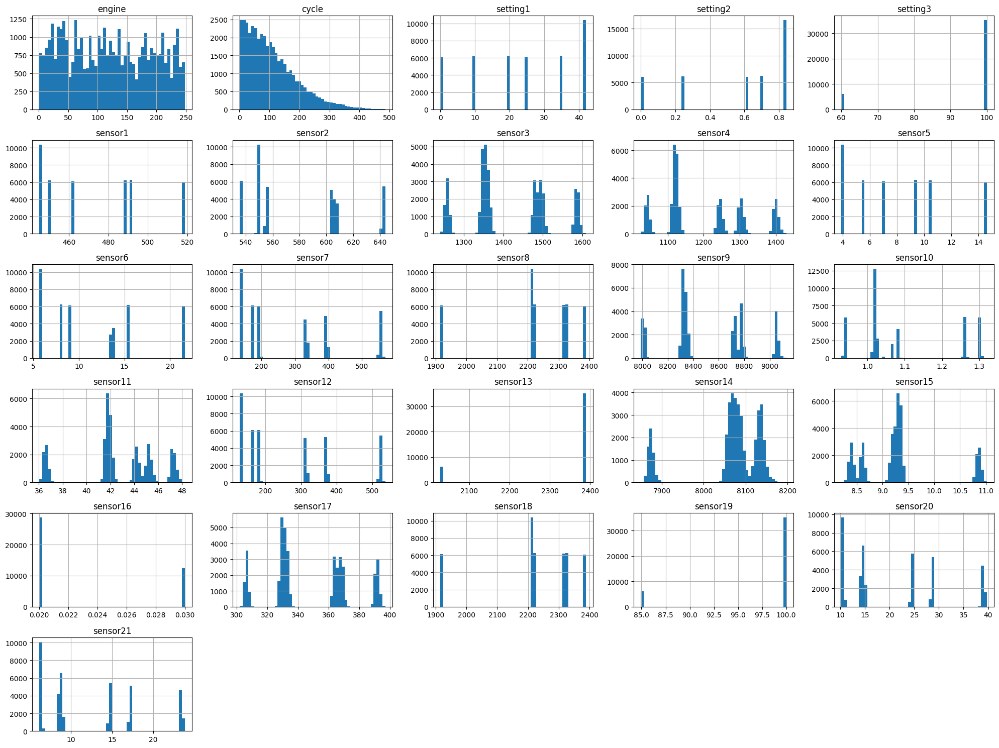

In [ ]:
test_4.hist(bins=50, figsize=(20,15))
plt.tight_layout()
plt.show()

In [ ]:
test_1['engine']

,engine
0,1
1,1
2,1
3,1
4,1
...,...
13091,100
13092,100
13093,100
13094,100


In [ ]:
engine_counts = test_1['engine'].value_counts()

print(engine_counts)

engine
49    303
93    244
91    234
62    232
12    217
     ... 
14     46
22     39
39     37
85     34
1      31
Name: count, Length: 100, dtype: int64


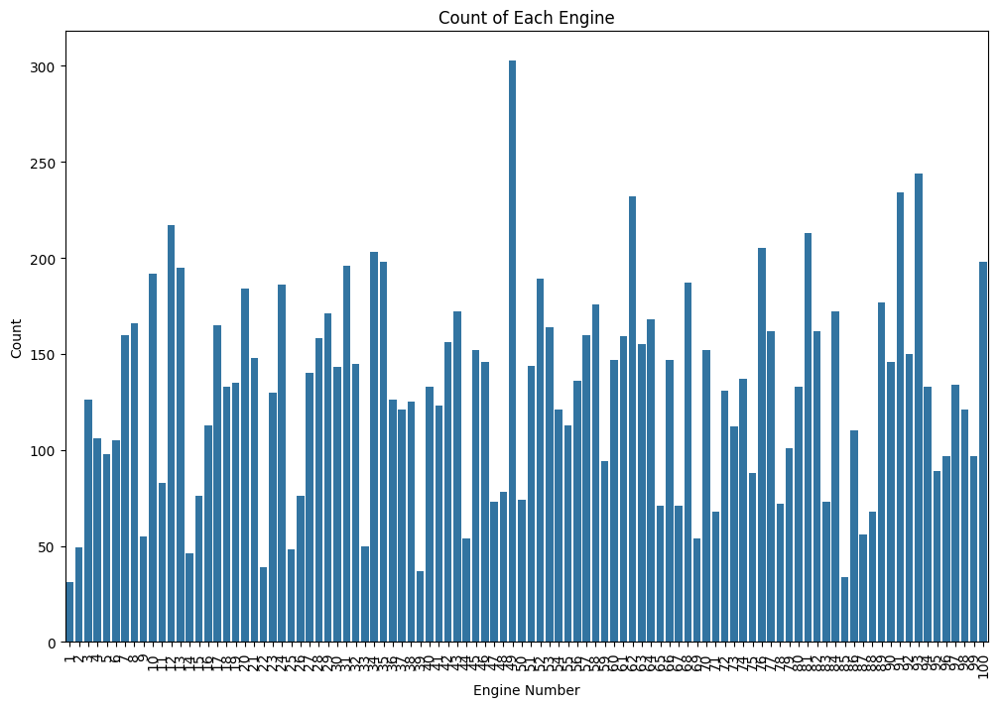

In [ ]:
engine_counts = test_1['engine'].value_counts().reset_index()
engine_counts.columns = ['engine', 'count']


plt.figure(figsize=(12, 8))
sns.barplot(x='engine', y='count', data=engine_counts)
plt.title('Count of Each Engine')
plt.xlabel('Engine Number')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()


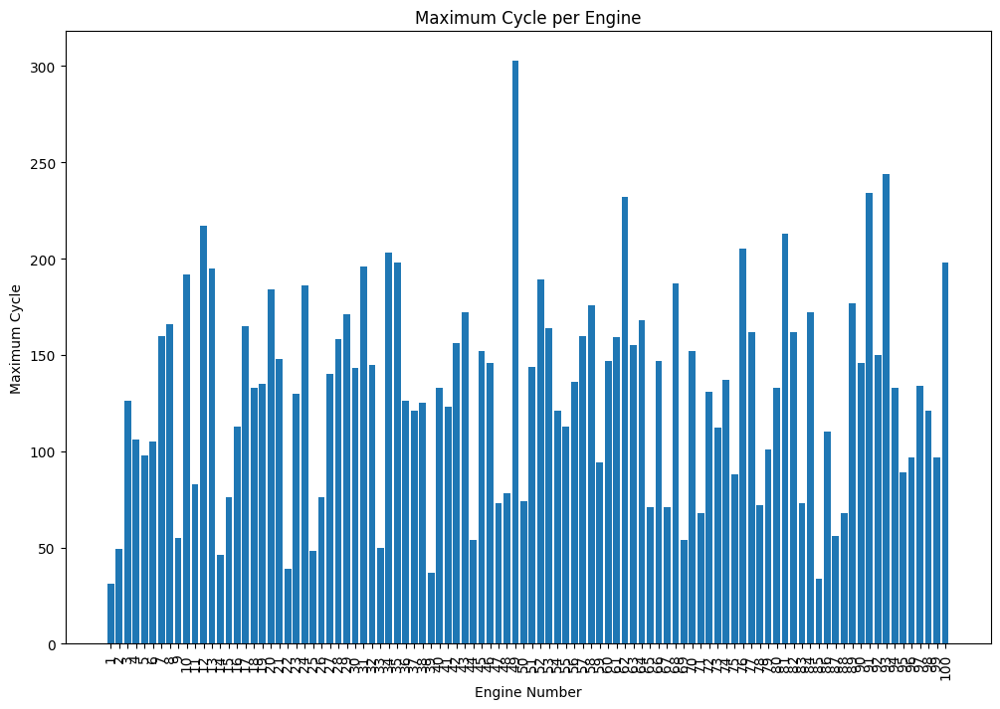

In [ ]:
# Getting the maximum cycle value for each engine
max_cycle_per_engine = test_1.groupby('engine')['cycle'].max().reset_index()

# Renaming columns
max_cycle_per_engine.columns = ['engine', 'max_cycle']


max_cycle_per_engine = max_cycle_per_engine.sort_values('engine')


plt.figure(figsize=(12, 8))
plt.bar(max_cycle_per_engine['engine'].astype(str), max_cycle_per_engine['max_cycle'])
plt.title('Maximum Cycle per Engine')
plt.xlabel('Engine Number')
plt.ylabel('Maximum Cycle')
plt.xticks(rotation=90)
plt.show()

In [ ]:
# Getting the maximum cycle value for each engine
max_cycle_per_engine = test_1.groupby('engine')['cycle'].max().reset_index()


print(max_cycle_per_engine.columns)

# Calculating the number of records per engine
engine_counts = test_1['engine'].value_counts().reset_index()
engine_counts.columns = ['engine', 'count']


comparison_df = pd.merge(max_cycle_per_engine, engine_counts, on='engine')

comparison_df['count_equals_max_cycle'] = comparison_df['cycle'] == comparison_df['count']

# Checking for a value of False
false_values = comparison_df[comparison_df['count_equals_max_cycle'] == False]
print("Rows where count_equals_max_cycle is False:")
print(false_values)

Index(['engine', 'cycle'], dtype='object')
Rows where count_equals_max_cycle is False:
Empty DataFrame
Columns: [engine, cycle, count, count_equals_max_cycle]
Index: []


1.   Each engine's number of records matches its maximum cycle value, meaning that no records were overlooked and that each cycle in the dataset has a matching record.
2.   The dataset was flawless, with no duplicates or missing records, since there were no instances when the number of records did not match the maximum cycle value.

An overview of the dataset shows that every engine's consumption at every cycle was thoroughly recorded, free of errors or missing information.


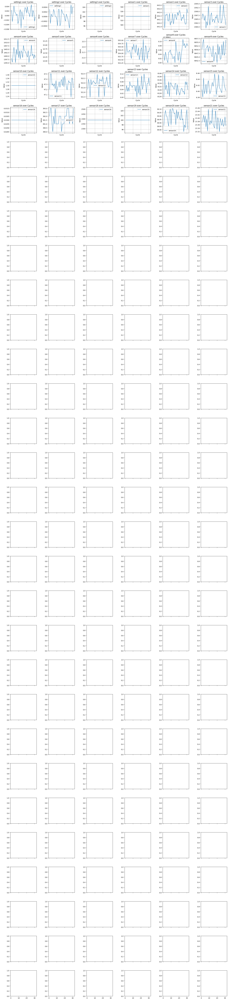

In [ ]:
# Selecting a specific engine number
engine_number = 1
engine_data = test_1[test_1['engine'] == engine_number]


columns_to_plot = ['setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


num_columns = 6
num_rows = (len(columns_to_plot) + num_columns - 1)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(20, num_rows * 3), sharex=True)


for ax, column in zip(axes.flatten(), columns_to_plot):
    ax.plot(engine_data['cycle'], engine_data[column], label=column)
    ax.set_title(f'{column} over Cycles')
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Value')
    ax.legend()
    ax.grid(True)


plt.tight_layout()
plt.show()

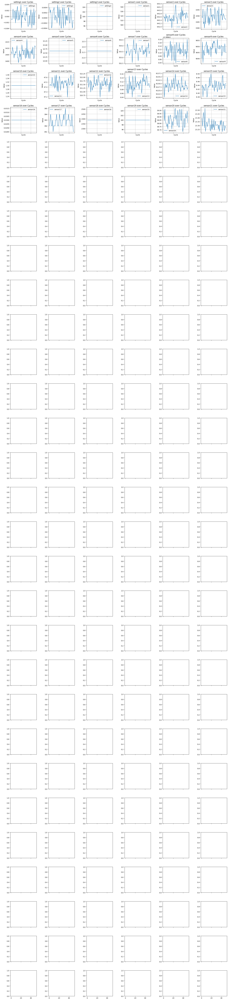

In [ ]:
# Selecting a specific engine number
engine_number = 2
engine_data = test_1[test_1['engine'] == engine_number]


columns_to_plot = ['setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


num_columns = 6
num_rows = (len(columns_to_plot) + num_columns - 1)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(20, num_rows * 3), sharex=True)


for ax, column in zip(axes.flatten(), columns_to_plot):
    ax.plot(engine_data['cycle'], engine_data[column], label=column)
    ax.set_title(f'{column} over Cycles')
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Value')
    ax.legend()
    ax.grid(True)


plt.tight_layout()
plt.show()

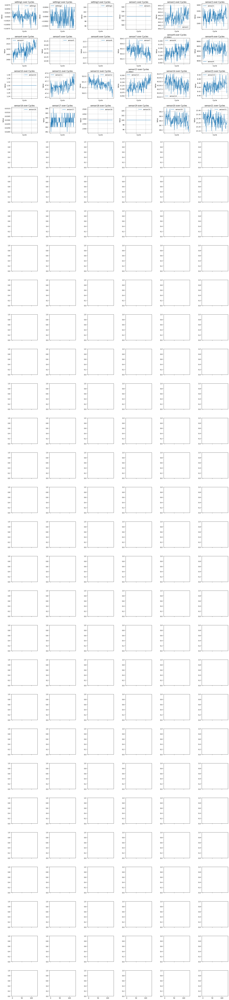

In [ ]:
# Selecting a specific engine number
engine_number = 3
engine_data = test_1[test_1['engine'] == engine_number]


columns_to_plot = ['setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


num_columns = 6
num_rows = (len(columns_to_plot) + num_columns - 1)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(20, num_rows * 3), sharex=True)


for ax, column in zip(axes.flatten(), columns_to_plot):
    ax.plot(engine_data['cycle'], engine_data[column], label=column)
    ax.set_title(f'{column} over Cycles')
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Value')
    ax.legend()
    ax.grid(True)


plt.tight_layout()
plt.show()

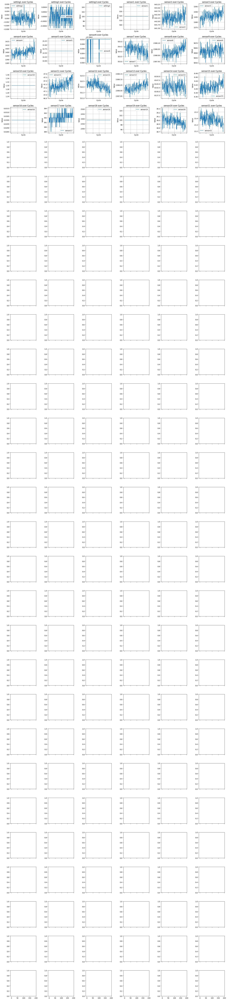

In [ ]:
# Selecting a specific engine number
engine_number = 10
engine_data = test_1[test_1['engine'] == engine_number]


columns_to_plot = ['setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


num_columns = 6
num_rows = (len(columns_to_plot) + num_columns - 1)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(20, num_rows * 3), sharex=True)


for ax, column in zip(axes.flatten(), columns_to_plot):
    ax.plot(engine_data['cycle'], engine_data[column], label=column)
    ax.set_title(f'{column} over Cycles')
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Value')
    ax.legend()
    ax.grid(True)


plt.tight_layout()
plt.show()

As we can see from the above graphs we conclude that:


1.   Setting 3, sensor 1, sensor 5, sensor 10, sensor 16, and sensor 18 all exhibit constant values throughout the cycle, suggesting that these parameters have not altered while the engine has been operating.
2.   The remaining settings and sensors exhibit fluctuation to differing degrees, suggesting that various variables influenced them while they were in use.

While the changing parameters indicate readings over time that may be used to track engine health and performance, the constant parameters may represent some fixed setting or baseline value. Potential flaws can be predicted and identified by examining these variations.



# Frequency Domain Analysis

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq

def plot_fft_for_engines(dataset, selected_engines, selected_sensors, dataset_name=""):

    for engine_id in selected_engines:
        engine_data = dataset[dataset['engine'] == engine_id]

        if engine_data.empty:
            print(f"[Warning] Engine {engine_id} not found in {dataset_name}. Skipping...")
            continue

        for sensor in selected_sensors:
            signal = engine_data[sensor].values
            N = len(signal)


            signal_demeaned = signal - np.mean(signal)

            # FFT
            yf = fft(signal_demeaned)
            xf = fftfreq(N, d=1)[:N//2]
            yf_abs = 2.0 / N * np.abs(yf[:N//2])

            # Plot
            plt.figure(figsize=(10, 4))
            plt.plot(xf, yf_abs)
            plt.title(f'FFT of {sensor} - Engine {engine_id} ({dataset_name})')
            plt.xlabel('Frequency (1/cycle)')
            plt.ylabel('Amplitude')
            plt.grid(True)
            plt.tight_layout()
            plt.show()

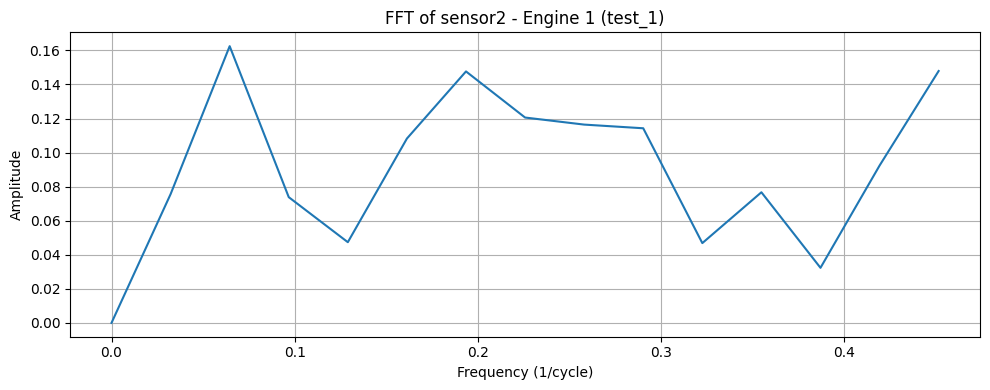

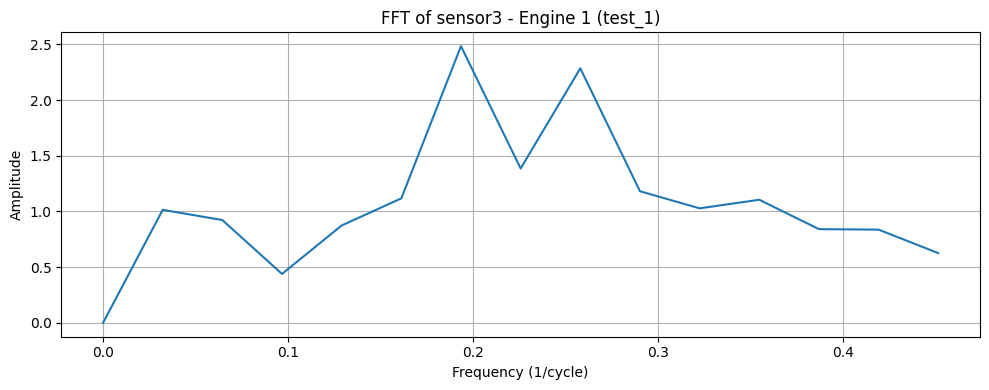

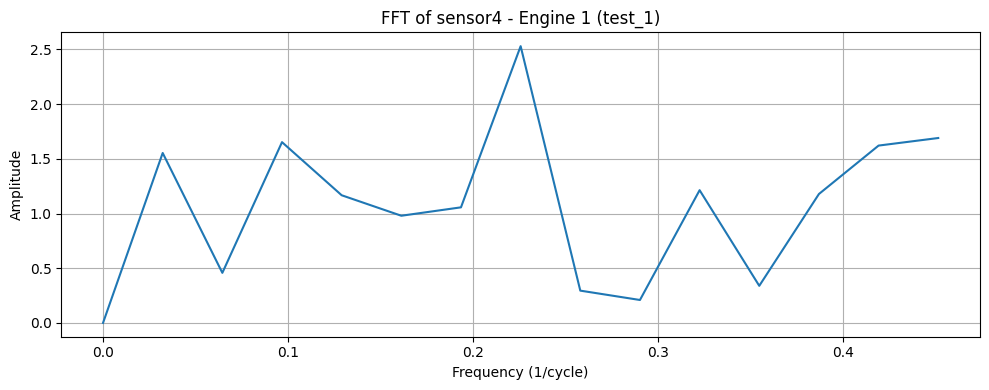

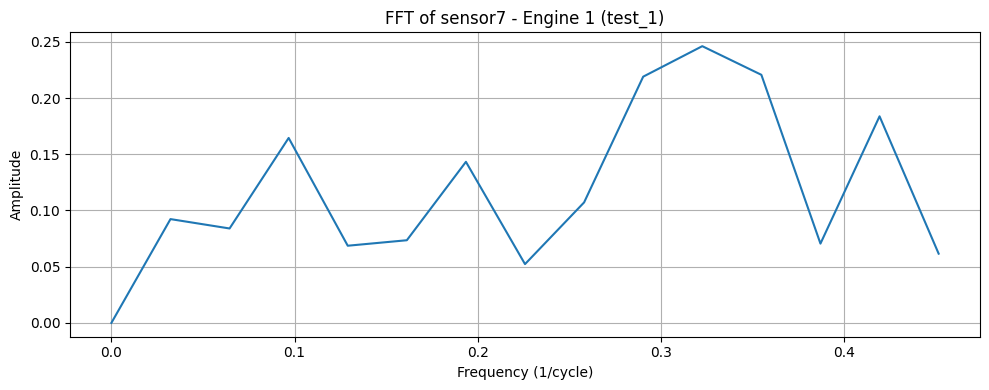

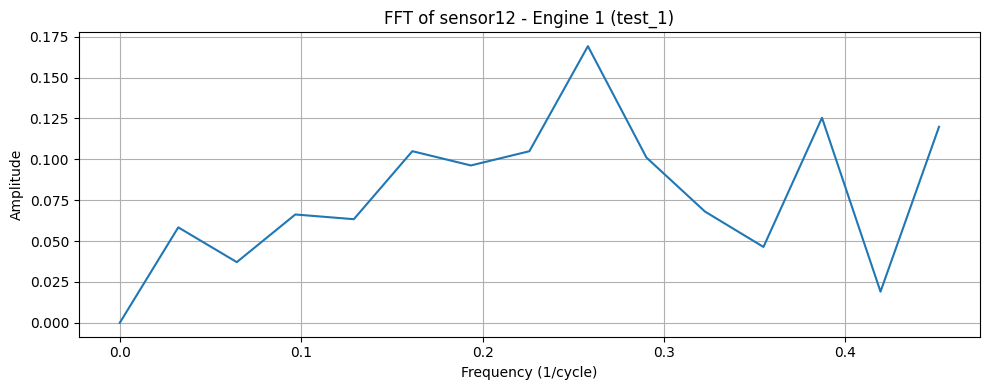

...

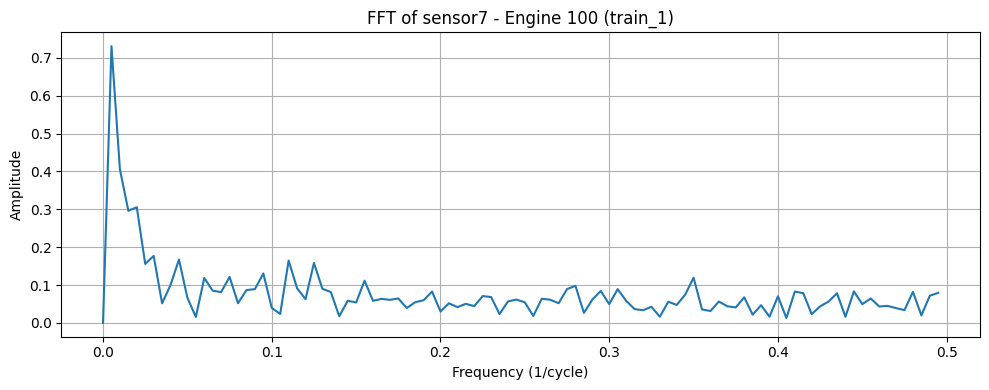

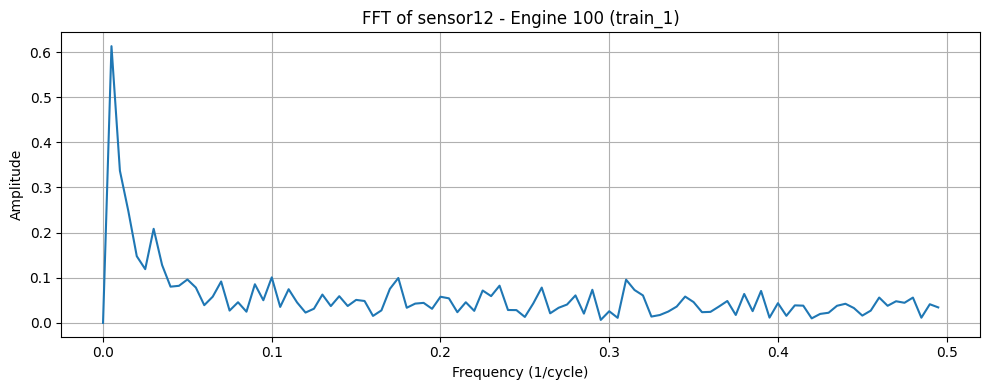

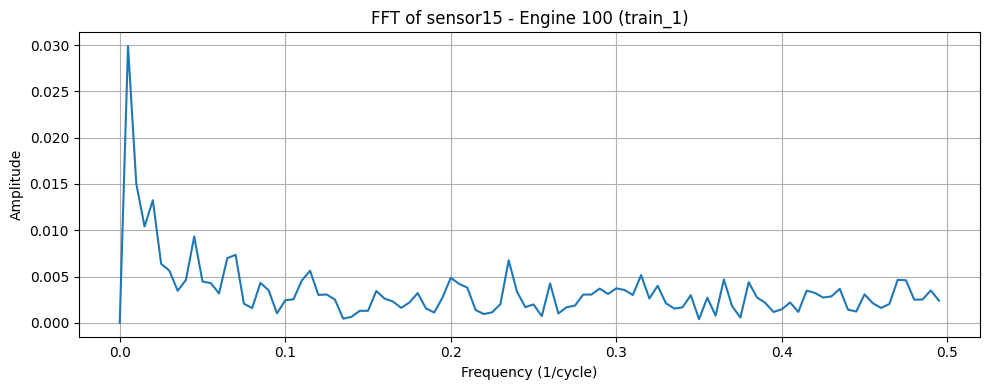

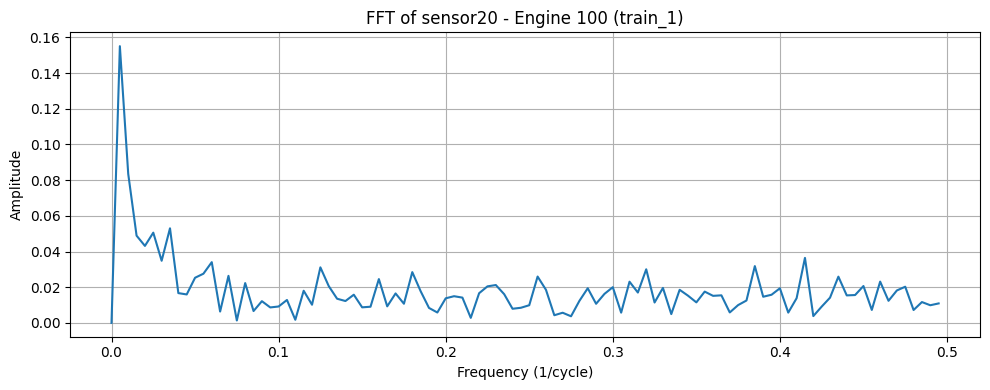

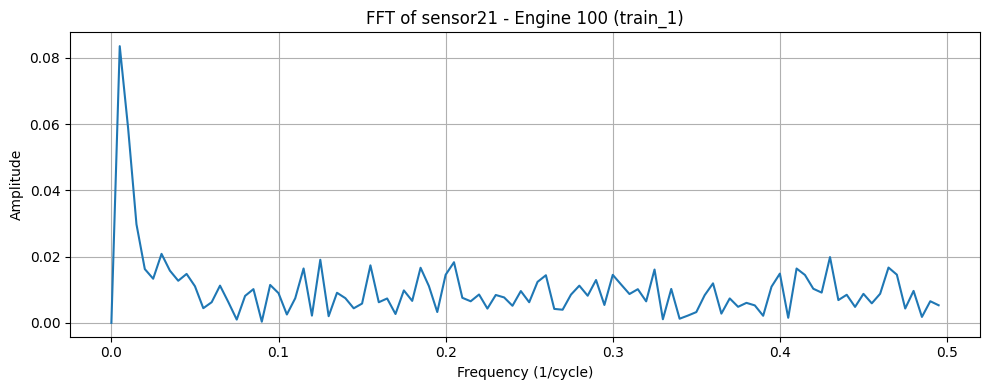

In [ ]:
selected_engines = [1, 50, 100]
selected_sensors = ['sensor2', 'sensor3', 'sensor4', 'sensor7', 'sensor12', 'sensor15', 'sensor20', 'sensor21']

# For test_1
plot_fft_for_engines(test_1, selected_engines, selected_sensors, dataset_name='test_1')

# For train_1
plot_fft_for_engines(train_1, selected_engines, selected_sensors, dataset_name='train_1')




In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq

def plot_fft_for_engines(dataset, selected_engines, selected_sensors, dataset_name=""):

    for engine_id in selected_engines:
        engine_data = dataset[dataset['engine'] == engine_id]

        if engine_data.empty:
            print(f"[Warning] Engine {engine_id} not found in {dataset_name}. Skipping...")
            continue

        for sensor in selected_sensors:
            signal = engine_data[sensor].values
            N = len(signal)


            signal_demeaned = signal - np.mean(signal)

            # FFT
            yf = fft(signal_demeaned)
            xf = fftfreq(N, d=1)[:N//2]
            yf_abs = 2.0 / N * np.abs(yf[:N//2])

            # Plot
            plt.figure(figsize=(10, 4))
            plt.plot(xf, yf_abs)
            plt.title(f'FFT of {sensor} - Engine {engine_id} ({dataset_name})')
            plt.xlabel('Frequency (1/cycle)')
            plt.ylabel('Amplitude')
            plt.grid(True)
            plt.tight_layout()
            plt.show()

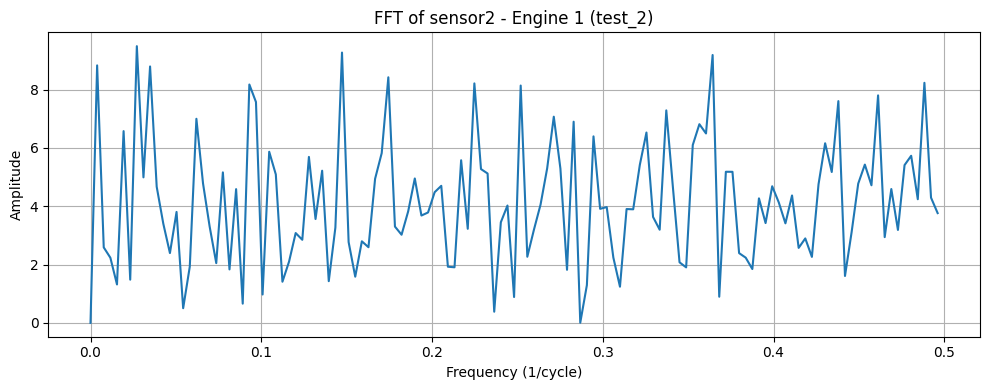

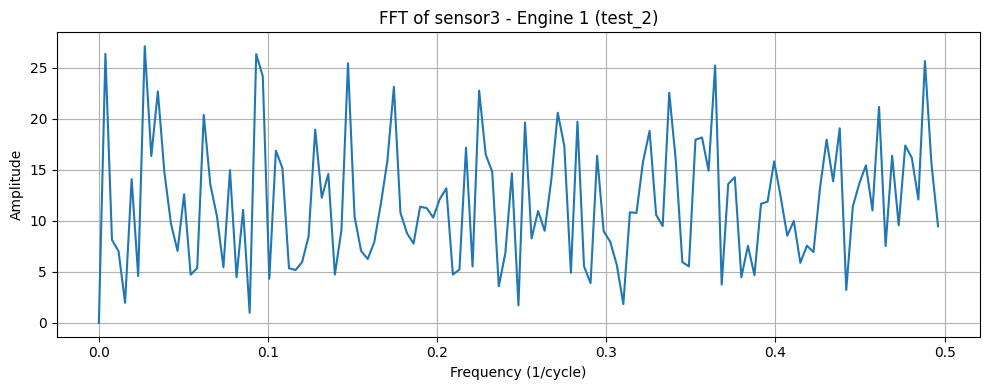

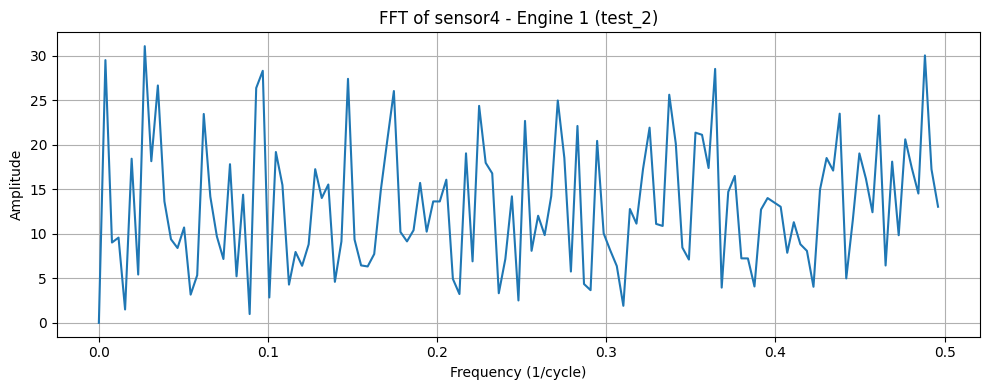

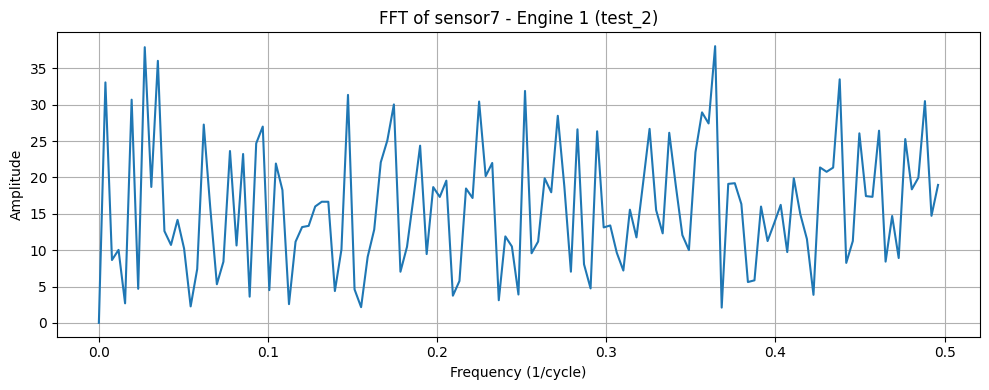

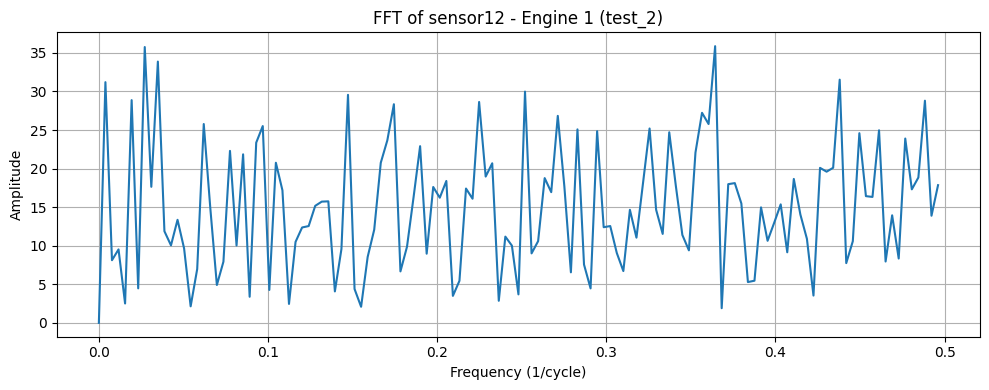

...

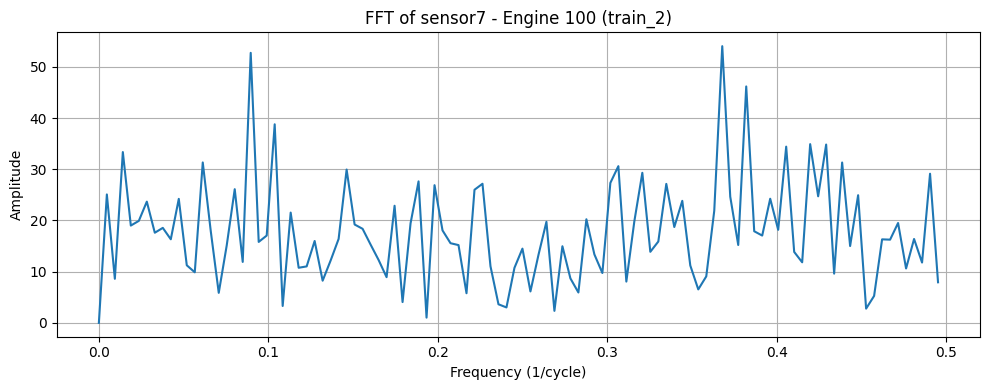

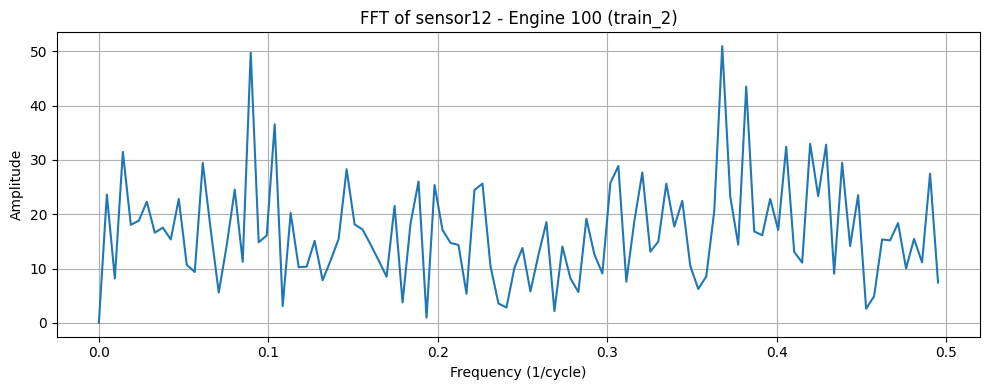

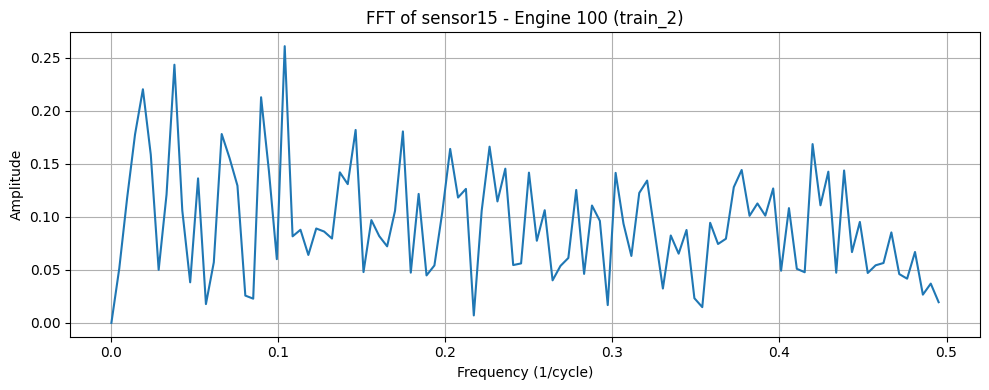

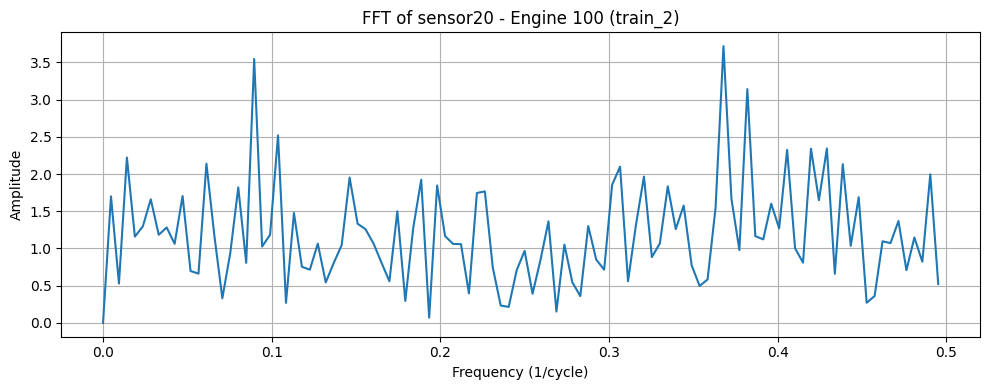

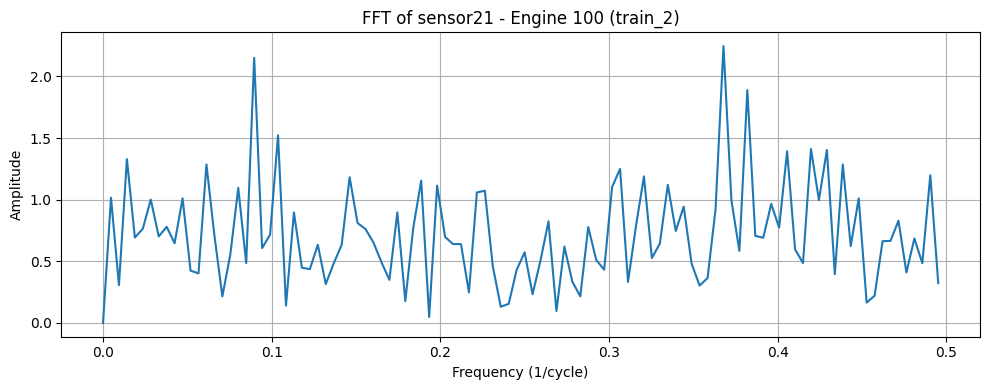

In [ ]:
selected_engines = [1, 50, 100]
selected_sensors = ['sensor2', 'sensor3', 'sensor4', 'sensor7', 'sensor12', 'sensor15', 'sensor20', 'sensor21']

# For test_2
plot_fft_for_engines(test_2, selected_engines, selected_sensors, dataset_name='test_2')

# For train_2
plot_fft_for_engines(train_2, selected_engines, selected_sensors, dataset_name='train_2')




In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq

def plot_fft_for_engines(dataset, selected_engines, selected_sensors, dataset_name=""):

    for engine_id in selected_engines:
        engine_data = dataset[dataset['engine'] == engine_id]

        if engine_data.empty:
            print(f"[Warning] Engine {engine_id} not found in {dataset_name}. Skipping...")
            continue

        for sensor in selected_sensors:
            signal = engine_data[sensor].values
            N = len(signal)


            signal_demeaned = signal - np.mean(signal)

            # FFT
            yf = fft(signal_demeaned)
            xf = fftfreq(N, d=1)[:N//2]
            yf_abs = 2.0 / N * np.abs(yf[:N//2])

            # Plot
            plt.figure(figsize=(10, 4))
            plt.plot(xf, yf_abs)
            plt.title(f'FFT of {sensor} - Engine {engine_id} ({dataset_name})')
            plt.xlabel('Frequency (1/cycle)')
            plt.ylabel('Amplitude')
            plt.grid(True)
            plt.tight_layout()
            plt.show()

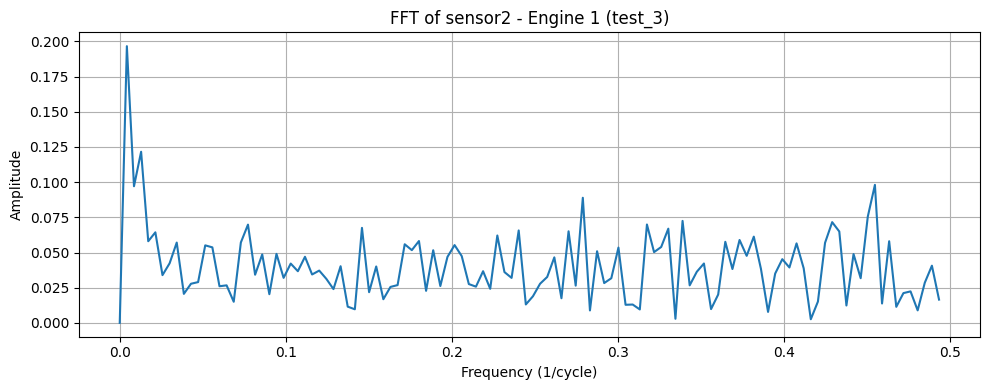

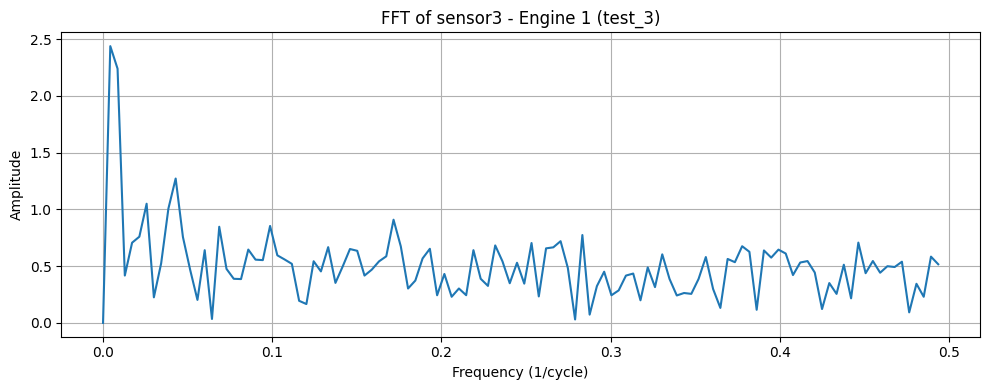

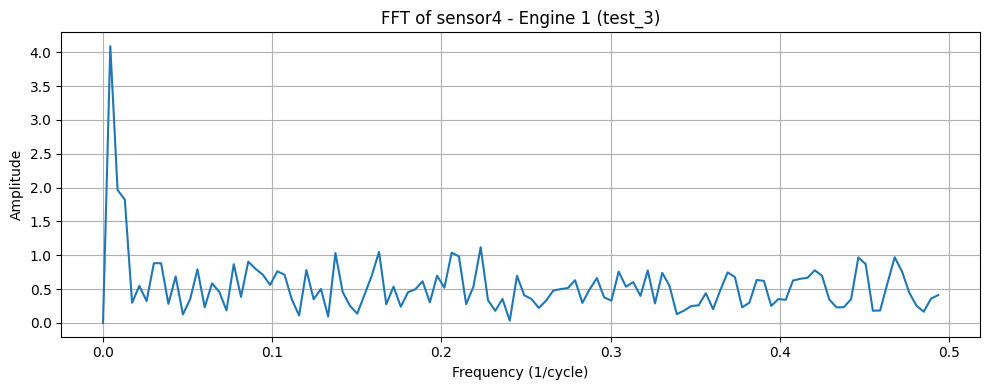

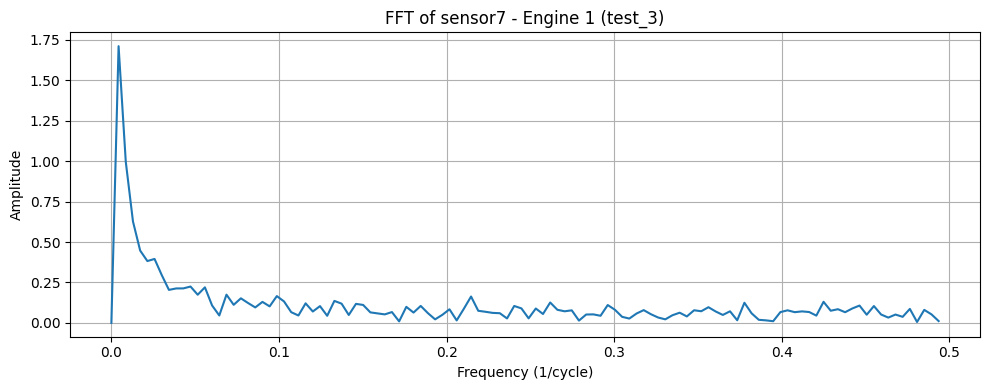

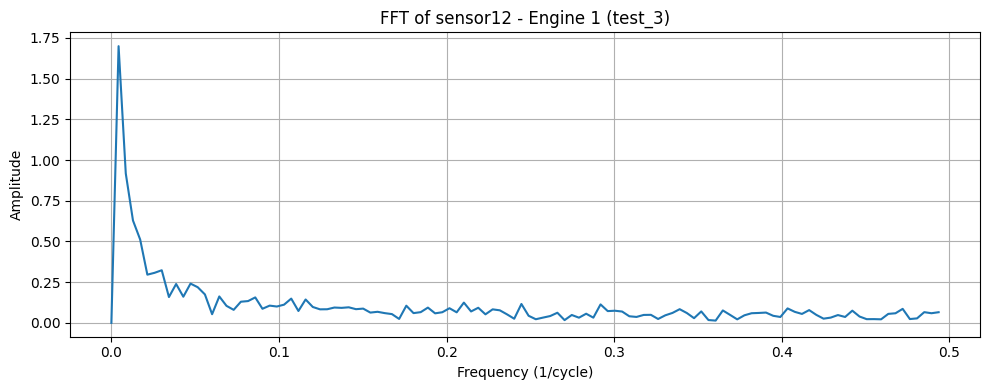

...

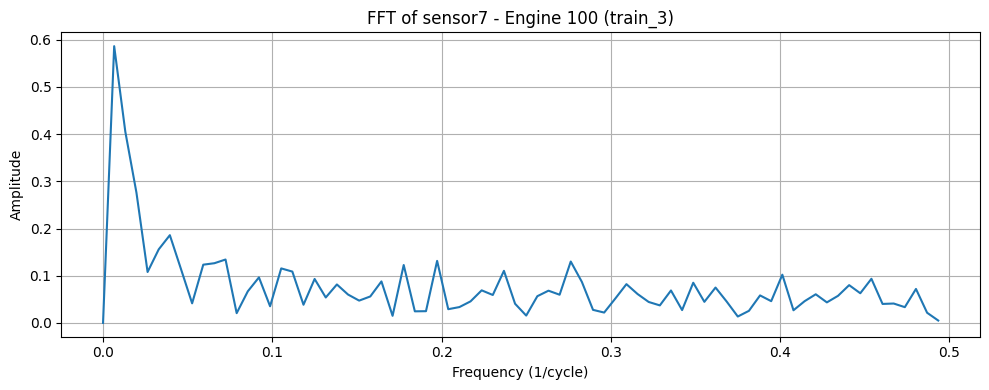

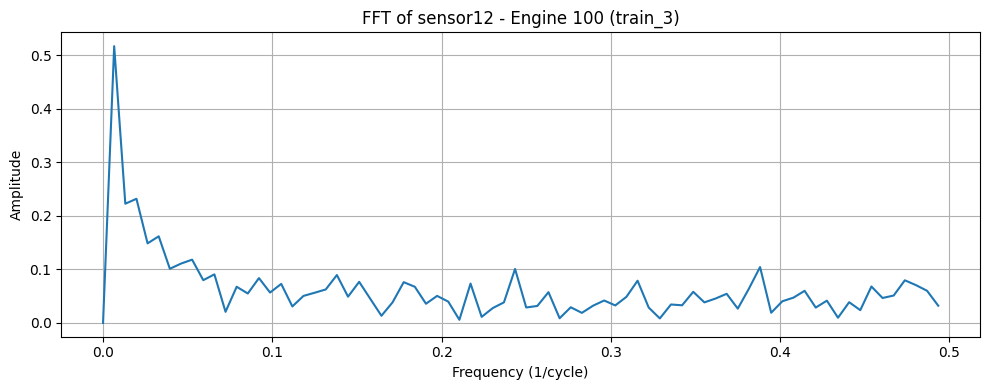

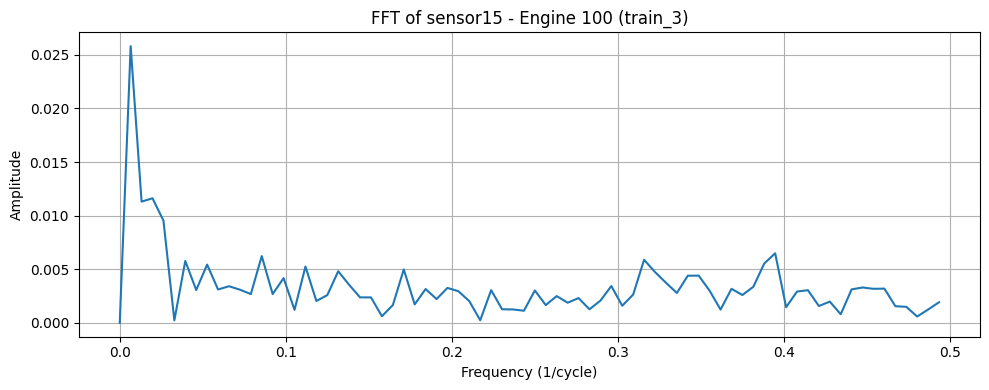

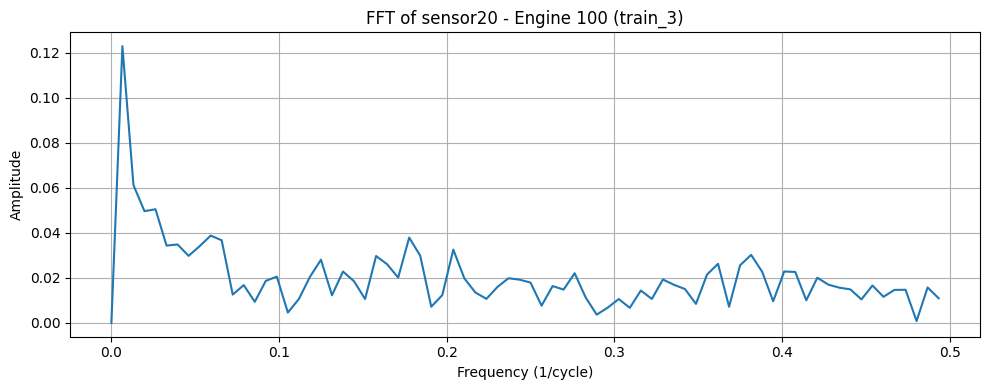

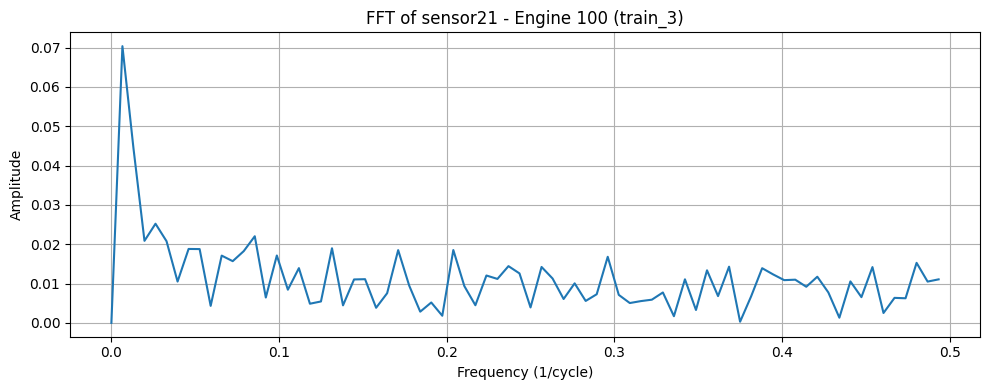

In [ ]:
selected_engines = [1, 50, 100]
selected_sensors = ['sensor2', 'sensor3', 'sensor4', 'sensor7', 'sensor12', 'sensor15', 'sensor20', 'sensor21']

# For test_3
plot_fft_for_engines(test_3, selected_engines, selected_sensors, dataset_name='test_3')

# For train_3
plot_fft_for_engines(train_3, selected_engines, selected_sensors, dataset_name='train_3')




In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq

def plot_fft_for_engines(dataset, selected_engines, selected_sensors, dataset_name=""):

    for engine_id in selected_engines:
        engine_data = dataset[dataset['engine'] == engine_id]

        if engine_data.empty:
            print(f"[Warning] Engine {engine_id} not found in {dataset_name}. Skipping...")
            continue

        for sensor in selected_sensors:
            signal = engine_data[sensor].values
            N = len(signal)


            signal_demeaned = signal - np.mean(signal)

            # FFT
            yf = fft(signal_demeaned)
            xf = fftfreq(N, d=1)[:N//2]
            yf_abs = 2.0 / N * np.abs(yf[:N//2])

            # Plot
            plt.figure(figsize=(10, 4))
            plt.plot(xf, yf_abs)
            plt.title(f'FFT of {sensor} - Engine {engine_id} ({dataset_name})')
            plt.xlabel('Frequency (1/cycle)')
            plt.ylabel('Amplitude')
            plt.grid(True)
            plt.tight_layout()
            plt.show()

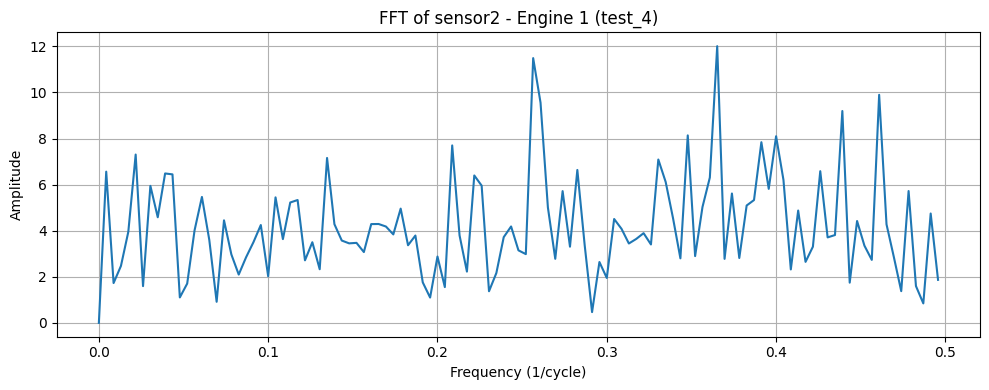

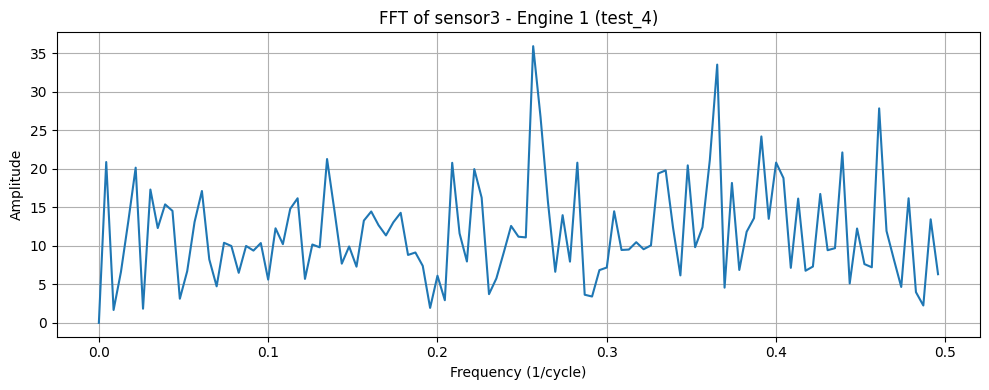

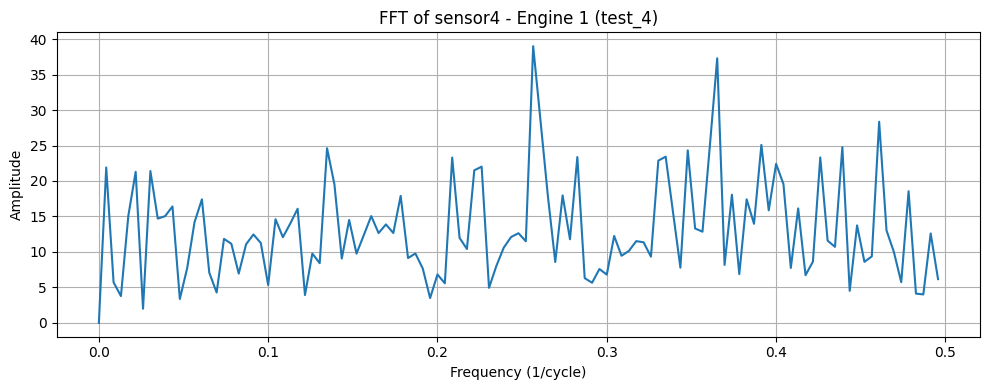

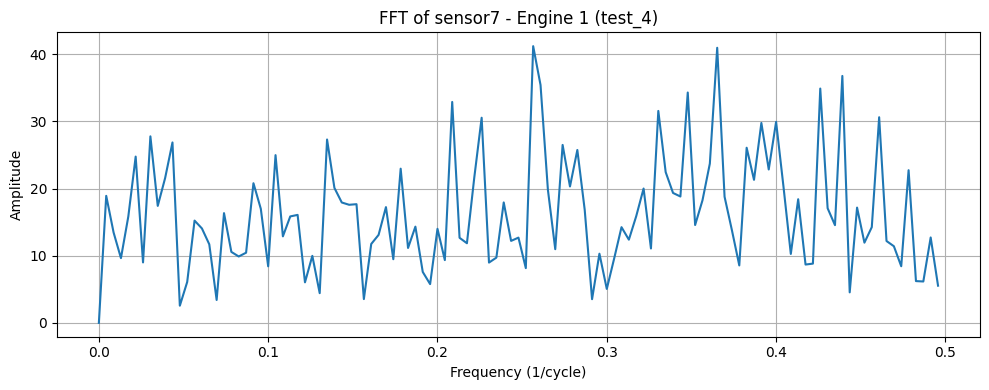

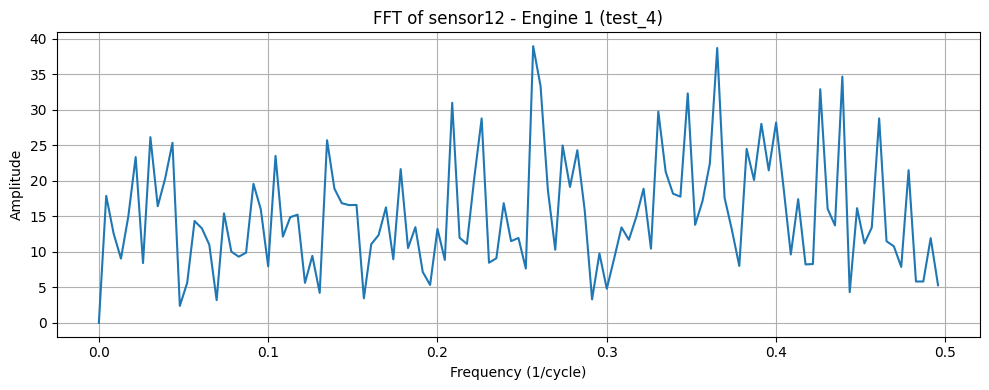

...

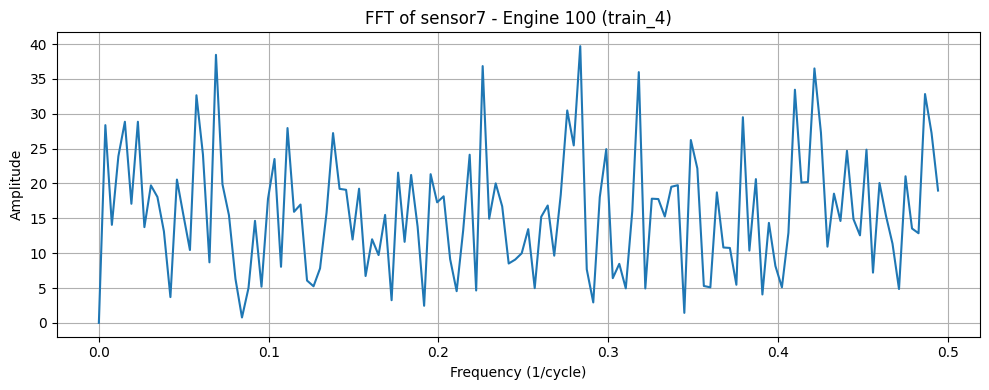

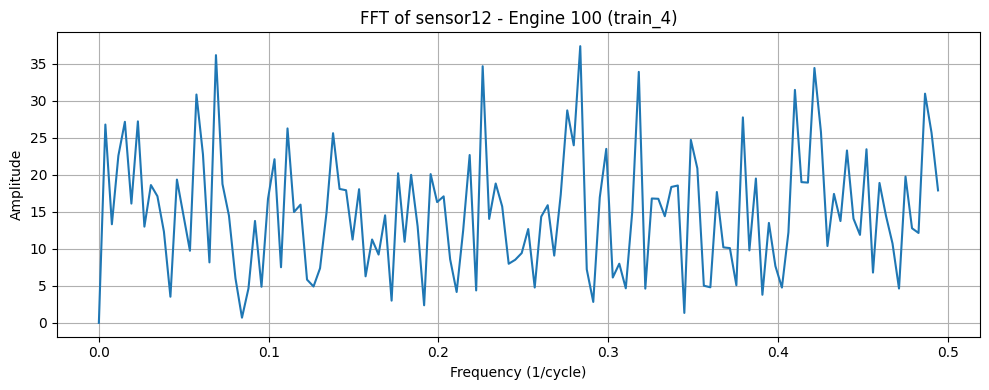

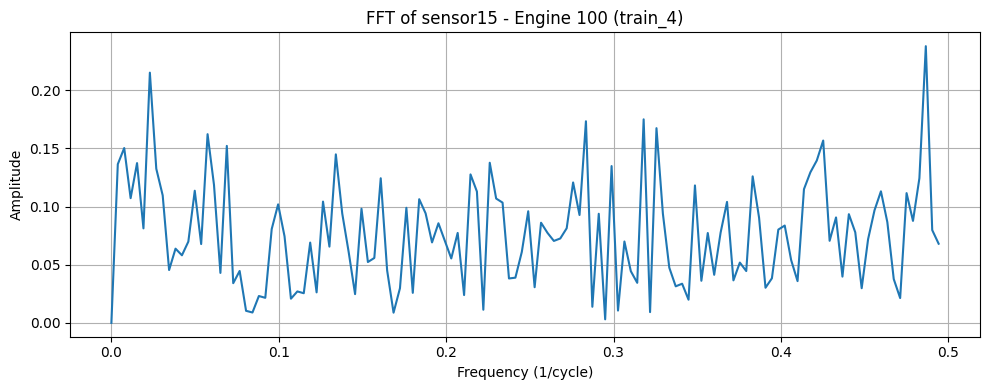

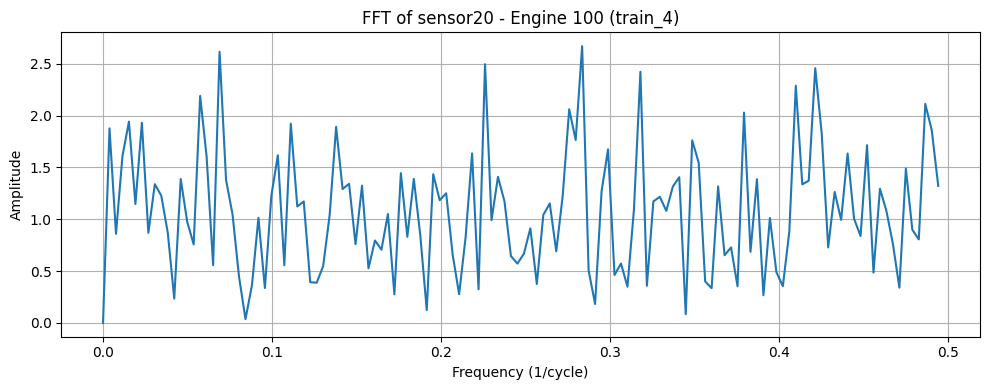

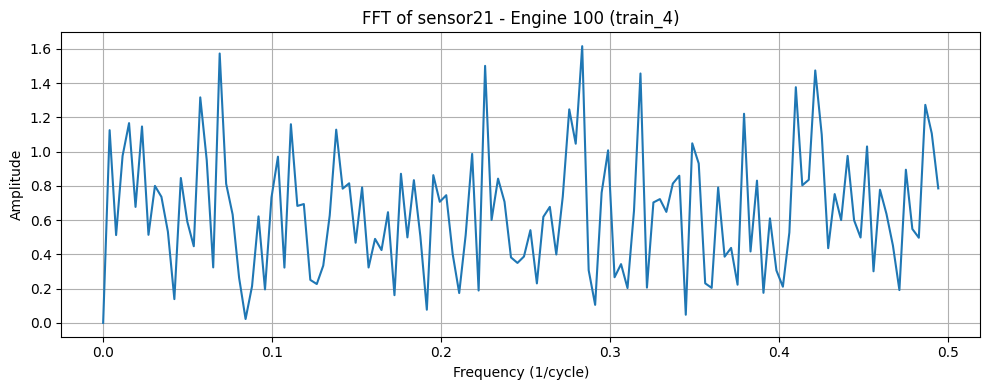

In [ ]:
selected_engines = [1, 50, 100]
selected_sensors = ['sensor2', 'sensor3', 'sensor4', 'sensor7', 'sensor12', 'sensor15', 'sensor20', 'sensor21']

# For test_4
plot_fft_for_engines(test_4, selected_engines, selected_sensors, dataset_name='test_4')

# For train_4
plot_fft_for_engines(train_4, selected_engines, selected_sensors, dataset_name='train_4')




Summary of Test Graphs: The Peaks in the graph represent repeating patterns and no strong peaks means no dominant frequency ( sensor 20 engine 1). Spike at frequency=0 means there is strong trending value. Many moderate peaks means sensor is experiencing oscillations, indicate degrading signals/maintenance ( sensor 3 engine 50). Flat graphs means not that informative. Low amplitude means noise- can ignore and clean the sensor.

HELPS US: we can drop no frequency activity sensors like sensor 1 ( represented in histogram)

FEATURE ENGINEERING: we will find based on FDA are dominant frequency, spectral energy and bandwidth ( these can be new features of ML model to predict RUL )

FAULT MODES: FDA helps us in differentiating fault types, we will understand fault modes of fans ( affected sensors 20,21 ) and compressor faults (7,12)

Summary of Train Graphs: Strong peaks means increase or decrease trend over engines life ( eg sensor 20 , engine 100). Moderate spikes presence of noise with no strong periodicity ( eg sensor 21 engine 50). Steady increase/decrease in signal indicate degradation trend of the engine wear which is best for RUL prediction ( eg sensor 12 engine 1). Performing FDA will help us to proritize required sensors, and drop/use as low variance. Sudden peaks can help us detect anomalies.

# Spectral Energy Analysis

In [ ]:
from scipy.fft import fft, fftfreq
import numpy as np
import pandas as pd

def compute_spectral_features(df, sensors, engine_col='engine', cycle_col='cycle'):
    feature_rows = []

    for engine_id in df[engine_col].unique():
        engine_data = df[df[engine_col] == engine_id].sort_values(cycle_col)

        row = {'engine': engine_id}
        for sensor in sensors:
            signal = engine_data[sensor].values
            signal = signal - np.mean(signal)
            N = len(signal)

            yf = np.abs(fft(signal))[:N // 2]
            xf = fftfreq(N, d=1)[:N // 2]

            # Normalize for spectral features
            psd = yf / np.sum(yf)

            # Spectral Centroid
            centroid = np.sum(xf * psd)

            # Spectral Entropy
            entropy = -np.sum(psd * np.log2(psd + 1e-12))

            # Spectral Bandwidth
            bandwidth = np.sqrt(np.sum(((xf - centroid) ** 2) * psd))

            # Spectral Energy
            energy = np.sum(yf ** 2)

            # Spectral Flatness
            flatness = np.exp(np.mean(np.log(yf + 1e-12))) / (np.mean(yf) + 1e-12)

            row[f'{sensor}_centroid'] = centroid
            row[f'{sensor}_entropy'] = entropy
            row[f'{sensor}_bandwidth'] = bandwidth
            row[f'{sensor}_energy'] = energy
            row[f'{sensor}_flatness'] = flatness

        feature_rows.append(row)

    return pd.DataFrame(feature_rows)

In [ ]:
selected_sensors = ['sensor2', 'sensor3', 'sensor4', 'sensor7', 'sensor12', 'sensor15', 'sensor20', 'sensor21']
spectral_df = compute_spectral_features(train_1, selected_sensors)
spectral_df.shape[0]
spectral_df.shape[1]
spectral_df['engine'].nunique()
print(f"Spectral feature matrix shape: {spectral_df.shape}")


Spectral feature matrix shape: (100, 41)


In [ ]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', None)


display(spectral_df)

print(spectral_df.shape)
print(spectral_df.columns.tolist())


,engine,sensor2_centroid,sensor2_entropy,sensor2_bandwidth,sensor2_energy,sensor2_flatness,sensor3_centroid,sensor3_entropy,sensor3_bandwidth,sensor3_energy,sensor3_flatness,sensor4_centroid,sensor4_entropy,sensor4_bandwidth,sensor4_energy,sensor4_flatness,sensor7_centroid,sensor7_entropy,sensor7_bandwidth,sensor7_energy,sensor7_flatness,sensor12_centroid,sensor12_entropy,sensor12_bandwidth,sensor12_energy,sensor12_flatness,sensor15_centroid,sensor15_entropy,sensor15_bandwidth,sensor15_energy,sensor15_flatness,sensor20_centroid,sensor20_entropy,sensor20_bandwidth,sensor20_energy,sensor20_flatness,sensor21_centroid,sensor21_entropy,sensor21_bandwidth,sensor21_energy,sensor21_flatness
0,1,0.202203,6.182430,0.159069,4338.737600,0.587318,0.216082,6.254747,0.154033,6.082782e+05,0.603798,0.178579,5.919320,0.161431,1.345217e+06,0.507182,0.174228,5.985471,0.155782,15195.003500,0.537242,0.161547,5.867987,0.154735,10279.980700,0.511900,0.190273,6.129549,0.157754,21.133540,0.576693,0.194251,6.148829,0.154332,511.308700,0.568449,0.187014,6.114541,0.156703,202.408356,0.571645
1,2,0.179201,6.618055,0.156092,12874.021361,0.598395,0.199419,6.711514,0.152691,1.785550e+06,0.631619,0.172289,6.474180,0.157555,3.878955e+06,0.567281,0.171947,6.481472,0.159484,36207.036042,0.562018,0.170889,6.465665,0.159578,26189.281666,0.581182,0.183948,6.572999,0.160623,69.247593,0.617797,0.183807,6.665801,0.158171,1629.259390,0.630660,0.183258,6.579205,0.155925,539.133617,0.586172
2,3,0.201175,6.038613,0.158024,3565.070146,0.553529,0.184938,6.022361,0.153514,6.472497e+05,0.528817,0.181454,5.952866,0.159618,1.176907e+06,0.540067,0.187318,6.046152,0.154378,8499.039686,0.568767,0.188806,6.047377,0.155673,5599.113822,0.586764,0.173998,5.899692,0.150360,21.263764,0.535915,0.191158,6.049899,0.153010,438.005048,0.571975,0.185578,5.967878,0.154731,174.601084,0.557321
3,4,0.208083,6.201450,0.156224,3394.788314,0.609220,0.197791,6.093515,0.158775,6.607530e+05,0.543773,0.187756,6.126266,0.156723,1.062717e+06,0.578765,0.203260,6.127809,0.159711,8899.318395,0.584105,0.188035,5.987914,0.161958,4984.273133,0.529490,0.190776,6.084975,0.158245,18.012171,0.560609,0.195752,6.186725,0.152481,449.178697,0.608011,0.192018,6.139170,0.152458,154.977496,0.578850
4,5,0.197362,6.618252,0.155521,10914.412509,0.637275,0.194559,6.621523,0.158428,1.796867e+06,0.634473,0.172511,6.443101,0.158169,3.447860e+06,0.570517,0.174419,6.431371,0.158250,28823.546984,0.588091,0.170146,6.433942,0.157506,20440.067356,0.593499,0.190193,6.544414,0.159485,53.628645,0.622909,0.186651,6.580081,0.160058,1258.190221,0.621817,0.198071,6.595145,0.159041,457.787216,0.636882
5,6,0.204607,6.195693,0.157113,3656.505200,0.611123,0.214389,6.203009,0.156850,4.920728e+05,0.603810,0.182263,6.056609,0.157148,8.910072e+05,0.571556,0.183724,6.050432,0.154051,8776.491200,0.567857,0.194024,6.092911,0.161339,6245.736100,0.581425,0.212178,6.182882,0.156593,16.166288,0.596526,0.206256,6.192436,0.155237,382.709000,0.600174,0.201535,6.147616,0.157655,151.691299,0.584091
6,7,0.190286,6.534799,0.155998,8420.517992,0.612755,0.214783,6.619408,0.157491,1.097602e+06,0.650384,0.186835,6.402512,0.159668,2.925761e+06,0.571959,0.181186,6.375835,0.159841,28913.487912,0.571338,0.169520,6.342725,0.157250,20917.391218,0.569543,0.189791,6.505073,0.155600,48.785491,0.612877,0.196573,6.518758,0.159618,1116.267891,0.615562,0.193611,6.568570,0.156300,412.156498,0.633984
7,8,0.218115,5.804435,0.156132,2039.335000,0.527343,0.215223,5.919894,0.151487,3.131937e+05,0.565243,0.207339,5.838483,0.155614,4.621826e+05,0.539128,0.201274,5.703490,0.164825,5588.035000,0.518425,0.187598,5.746385,0.154886,3605.691800,0.534192,0.211570,5.837373,0.152340,10.754971,0.553641,0.202177,5.868325,0.152816,245.236000,0.561598,0.207173,5.815157,0.155856,73.733026,0.524842
8,9,0.190392,6.127330,0.157455,4593.940036,0.567888,0.191146,6.196693,0.151594,7.490369e+05,0.577681,0.175226,6.135948,0.149252,1.513768e+06,0.566383,0.191997,6.180876,0.158892,9438.098464,0.568858,0.170285,6

(100, 41)
['engine', 'sensor2_centroid', 'sensor2_entropy', 'sensor2_bandwidth', 'sensor2_energy', 'sensor2_flatness', 'sensor3_centroid', 'sensor3_entropy', 'sensor3_bandwidth', 'sensor3_energy', 'sensor3_flatness', 'sensor4_centroid', 'sensor4_entropy', 'sensor4_bandwidth', 'sensor4_energy', 'sensor4_flatness', 'sensor7_centroid', 'sensor7_entropy', 'sensor7_bandwidth', 'sensor7_energy', 'sensor7_flatness', 'sensor12_centroid', 'sensor12_entropy', 'sensor12_bandwidth', 'sensor12_energy', 'sensor12_flatness', 'sensor15_centroid', 'sensor15_entropy', 'sensor15_bandwidth', 'sensor15_energy', 'sensor15_flatness', 'sensor20_centroid', 'sensor20_entropy', 'sensor20_bandwidth', 'sensor20_energy', 'sensor20_flatness', 'sensor21_centroid', 'sensor21_entropy', 'sensor21_bandwidth', 'sensor21_energy', 'sensor21_flatness']


Summary of Spectral Analysis:
This will help us to know engine failing. We calculated centroid,entropy,bandwidth, energy and flatness.

Centroid: Higher means more activity

Entropy: high means more noise

Bandwidth: large means more variation

Energy: high values means strong significance activity

Flatness: high means flat or white noise.

--INTERPRET OUTPUT--

Sensor 3 energy: very high = active and degradation info is captured.

Sensor 20 energy: more noise

Sensor 3,4 centroid: more variance and frequency shifts to different stages.

Sensor 7,12 bandwidth n energy: faults ( compressor issues )

Flatness < 0.6 means not flat, sensor has information.

Sensors 20,21 - fan issues

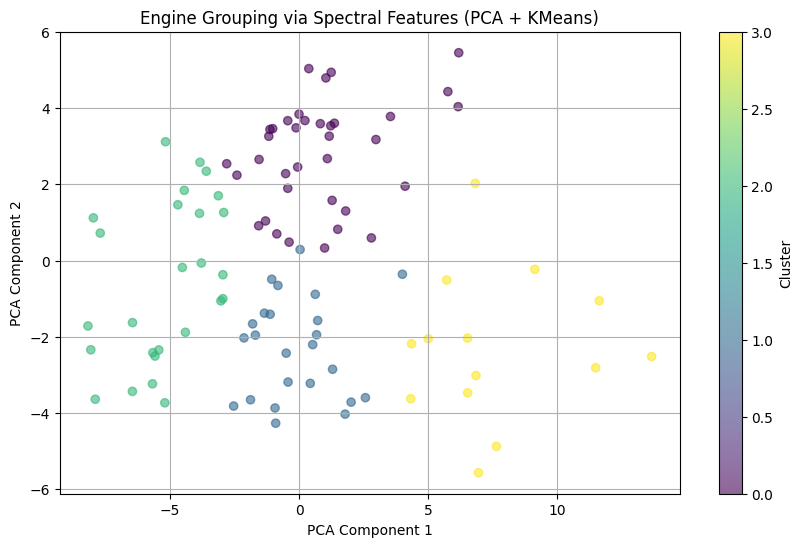

In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt



# Dropping engine column for clustering
X = spectral_df.drop(columns=['engine'])

# Standardizing features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Reducing to 2D for visualization using PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Apply KMeans clustering (choosing k=4 )
kmeans = KMeans(n_clusters=4, random_state=42)
clusters = kmeans.fit_predict(X_scaled)


spectral_df['cluster'] = clusters

# Plot PCA-reduced data with clusters
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=clusters, cmap='viridis', alpha=0.6)
plt.title("Engine Grouping via Spectral Features (PCA + KMeans)")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.colorbar(label='Cluster')
plt.grid(True)
plt.show()

Clustering: Every dot represents one engine. 4 different colors means 4 different type of clusters with similar engine behavior.
Dots which are away from cluster means outlier detected so engine is anomolous ( we observe few in every color )

In [ ]:
import pandas as pd
import numpy as np
from scipy.fft import fft, fftfreq

# Defining the sensors to analyze
selected_sensors = ['sensor2', 'sensor3', 'sensor4', 'sensor7', 'sensor12', 'sensor15', 'sensor20', 'sensor21']


def compute_spectral_features(df, sensors, engine_col='engine', cycle_col='cycle'):
    feature_rows = []

    for engine_id in df[engine_col].unique():
        engine_data = df[df[engine_col] == engine_id].sort_values(cycle_col)

        row = {'engine': engine_id}
        for sensor in sensors:
            signal = engine_data[sensor].values
            signal = signal - np.mean(signal)
            N = len(signal)

            yf = np.abs(fft(signal))[:N // 2]
            xf = fftfreq(N, d=1)[:N // 2]

            # Normalize for spectral features
            psd = yf / np.sum(yf)

            # Spectral Centroid
            centroid = np.sum(xf * psd)

            # Spectral Entropy
            entropy = -np.sum(psd * np.log2(psd + 1e-12))

            # Spectral Bandwidth
            bandwidth = np.sqrt(np.sum(((xf - centroid) ** 2) * psd))

            # Spectral Energy
            energy = np.sum(yf ** 2)

            # Spectral Flatness
            flatness = np.exp(np.mean(np.log(yf + 1e-12))) / (np.mean(yf) + 1e-12)

            row[f'{sensor}_centroid'] = centroid
            row[f'{sensor}_entropy'] = entropy
            row[f'{sensor}_bandwidth'] = bandwidth
            row[f'{sensor}_energy'] = energy
            row[f'{sensor}_flatness'] = flatness

        feature_rows.append(row)

    return pd.DataFrame(feature_rows)


In [ ]:
selected_sensors = ['sensor2', 'sensor3', 'sensor4', 'sensor7', 'sensor12', 'sensor15', 'sensor20', 'sensor21']
spectral_df1 = compute_spectral_features(test_1, selected_sensors)
spectral_df1.shape[0]
spectral_df1.shape[1]
spectral_df1['engine'].nunique()
print(f"Spectral feature matrix shape: {spectral_df1.shape}")


Spectral feature matrix shape: (100, 41)


In [ ]:

pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', None)


display(spectral_df1)

print(spectral_df1.shape)
print(spectral_df1.columns.tolist())


,engine,sensor2_centroid,sensor2_entropy,sensor2_bandwidth,sensor2_energy,sensor2_flatness,sensor3_centroid,sensor3_entropy,sensor3_bandwidth,sensor3_energy,sensor3_flatness,sensor4_centroid,sensor4_entropy,sensor4_bandwidth,sensor4_energy,sensor4_flatness,sensor7_centroid,sensor7_entropy,sensor7_bandwidth,sensor7_energy,sensor7_flatness,sensor12_centroid,sensor12_entropy,sensor12_bandwidth,sensor12_energy,sensor12_flatness,sensor15_centroid,sensor15_entropy,sensor15_bandwidth,sensor15_energy,sensor15_flatness,sensor20_centroid,sensor20_entropy,sensor20_bandwidth,sensor20_energy,sensor20_flatness,sensor21_centroid,sensor21_entropy,sensor21_bandwidth,sensor21_energy,sensor21_flatness
0,1,0.237073,3.683873,0.130816,37.009099,0.169328,0.237726,3.661167,0.112131,5.495949e+03,0.140194,0.242854,3.563415,0.138277,5.715064e+03,0.130510,0.260539,3.625564,0.121035,69.058765,0.147255,0.254348,3.648291,0.118312,28.968445,0.161040,0.235724,3.693952,0.121417,0.192299,0.182099,0.220046,3.542247,0.124891,4.023282,0.139786,0.283714,3.621571,0.120408,0.525457,0.167536
1,2,0.224750,4.289100,0.148947,78.885911,0.275690,0.258349,4.312143,0.135826,2.567308e+04,0.245240,0.230701,4.339084,0.134048,1.384401e+04,0.280168,0.236356,4.230864,0.131065,160.389446,0.271885,0.250585,4.393648,0.134039,112.330475,0.297323,0.219604,4.280313,0.134713,0.699215,0.299247,0.233839,4.396519,0.136719,10.841085,0.309331,0.235788,4.366230,0.134632,4.177178,0.303910
2,3,0.225707,5.732696,0.142075,752.932800,0.559817,0.240584,5.723624,0.147648,1.107406e+05,0.532788,0.224567,5.712547,0.156074,1.687924e+05,0.540073,0.241998,5.749312,0.149273,1489.464800,0.555067,0.217864,5.752219,0.146572,931.314200,0.552124,0.236561,5.814668,0.151524,3.774502,0.607426,0.230123,5.755112,0.137521,89.664200,0.562696,0.241654,5.739609,0.151056,31.265768,0.551134
3,4,0.237004,5.421342,0.140645,645.510400,0.490595,0.248661,5.489999,0.145041,8.706295e+04,0.499812,0.228010,5.448278,0.144020,1.157973e+05,0.485960,0.242962,5.528566,0.137166,959.398800,0.533322,0.248749,5.464824,0.152888,532.963400,0.514129,0.231275,5.533748,0.133867,1.909210,0.549987,0.244472,5.488242,0.135558,59.508000,0.506431,0.241018,5.418337,0.138058,19.334289,0.463708
4,5,0.260166,5.331382,0.143732,490.979800,0.485226,0.256506,5.337632,0.141639,8.207721e+04,0.465591,0.251831,5.396733,0.138877,7.463483e+04,0.488550,0.248430,5.384638,0.142288,771.838000,0.517772,0.227200,5.402043,0.147108,449.467400,0.512963,0.241081,5.400939,0.144712,2.126073,0.517142,0.224364,5.344404,0.142550,41.502600,0.494418,0.236575,5.422231,0.149457,17.468107,0.519866
5,6,0.250097,5.465891,0.135485,523.511357,0.514715,0.250975,5.537812,0.140690,7.512973e+04,0.522738,0.243377,5.466546,0.133755,8.716004e+04,0.505978,0.260964,5.460434,0.146771,908.143869,0.499449,0.248257,5.386792,0.140216,457.347108,0.497328,0.243245,5.475796,0.136428,2.322049,0.526056,0.240610,5.431367,0.141791,51.942096,0.489022,0.248632,5.572729,0.143582,16.282325,0.560955
6,7,0.249286,6.089847,0.141126,1075.483000,0.598644,0.234479,6.096279,0.140829,2.068373e+05,0.598144,0.238744,6.094653,0.151640,2.638502e+05,0.569056,0.244483,6.081240,0.151377,2031.710700,0.603762,0.237912,6.084831,0.151907,1289.654700,0.610834,0.236194,6.102387,0.141983,5.635583,0.620573,0.230486,6.010761,0.147614,155.742000,0.547521,0.233360,6.055671,0.149394,54.572692,0.593950
7,8,0.249589,6.177238,0.145688,1021.513000,0.632970,0.244613,6.160219,0.145329,2.292722e+05,0.613908,0.249352,6.163872,0.153949,2.837795e+05,0.610334,0.236387,6.120327,0.152116,2626.653000,0.626119,0.224008,6.058141,0.156916,1740.677600,0.586582,0.233295,6.117951,0.149148,7.028978,0.607573,0.247630,6.161555,0.150807,146.850600,0.623073,0.248509,6.154789,0.141167,48.957258,0.617733
8,9,0.239609,4.457913,0.138922,129.960974,0.327834,0.251559,4.475198,0.143677,1.877058e+04,0.304645,0.246498,4.576847,0.137778,2.127226e+04,0.314373,0.251286,4.519169,0.138801,254.199836,0.324643,0.249219,4.553689,0.135623,124.194566,0.349326,0.255104,4.486712,0.136

(100, 41)
['engine', 'sensor2_centroid', 'sensor2_entropy', 'sensor2_bandwidth', 'sensor2_energy', 'sensor2_flatness', 'sensor3_centroid', 'sensor3_entropy', 'sensor3_bandwidth', 'sensor3_energy', 'sensor3_flatness', 'sensor4_centroid', 'sensor4_entropy', 'sensor4_bandwidth', 'sensor4_energy', 'sensor4_flatness', 'sensor7_centroid', 'sensor7_entropy', 'sensor7_bandwidth', 'sensor7_energy', 'sensor7_flatness', 'sensor12_centroid', 'sensor12_entropy', 'sensor12_bandwidth', 'sensor12_energy', 'sensor12_flatness', 'sensor15_centroid', 'sensor15_entropy', 'sensor15_bandwidth', 'sensor15_energy', 'sensor15_flatness', 'sensor20_centroid', 'sensor20_entropy', 'sensor20_bandwidth', 'sensor20_energy', 'sensor20_flatness', 'sensor21_centroid', 'sensor21_entropy', 'sensor21_bandwidth', 'sensor21_energy', 'sensor21_flatness']


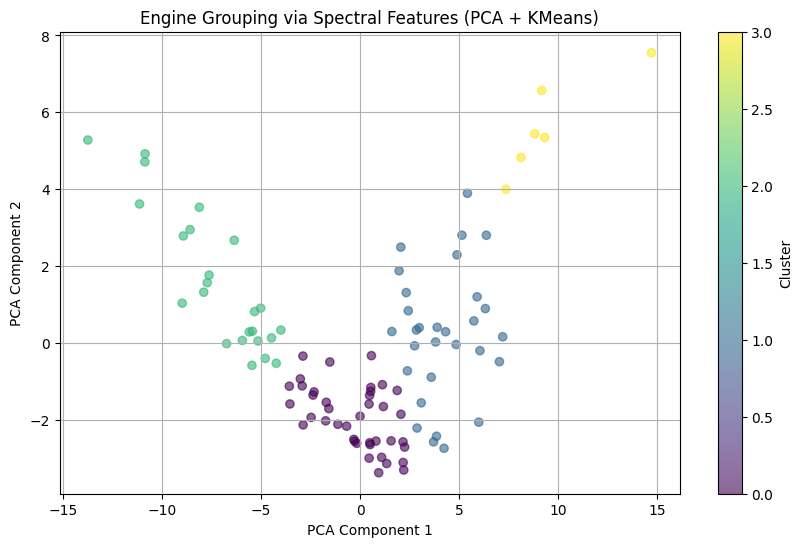

In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt



# Dropping 'engine' column for clustering
X = spectral_df1.drop(columns=['engine'])

# Standardizing features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Reducing to 2D for visualization using PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Apply KMeans clustering (choosing k=4)
kmeans = KMeans(n_clusters=4, random_state=42)
clusters = kmeans.fit_predict(X_scaled)


spectral_df1['cluster'] = clusters

# Plotting PCA-reduced data with clusters
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=clusters, cmap='viridis', alpha=0.6)
plt.title("Engine Grouping via Spectral Features (PCA + KMeans)")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.colorbar(label='Cluster')
plt.grid(True)
plt.show()

INFERENCES:

Sensor 2,21: behave differently all over.

Sensor 3: abnormalities in compressor,turbine

Engine 49 - sensor 2: flatness is 0.682 means noise and engine 1= 0.169 means good periodicity.


Conclusion For Spectral Energy Analysis:

Few outliers in the test set compared to train set.

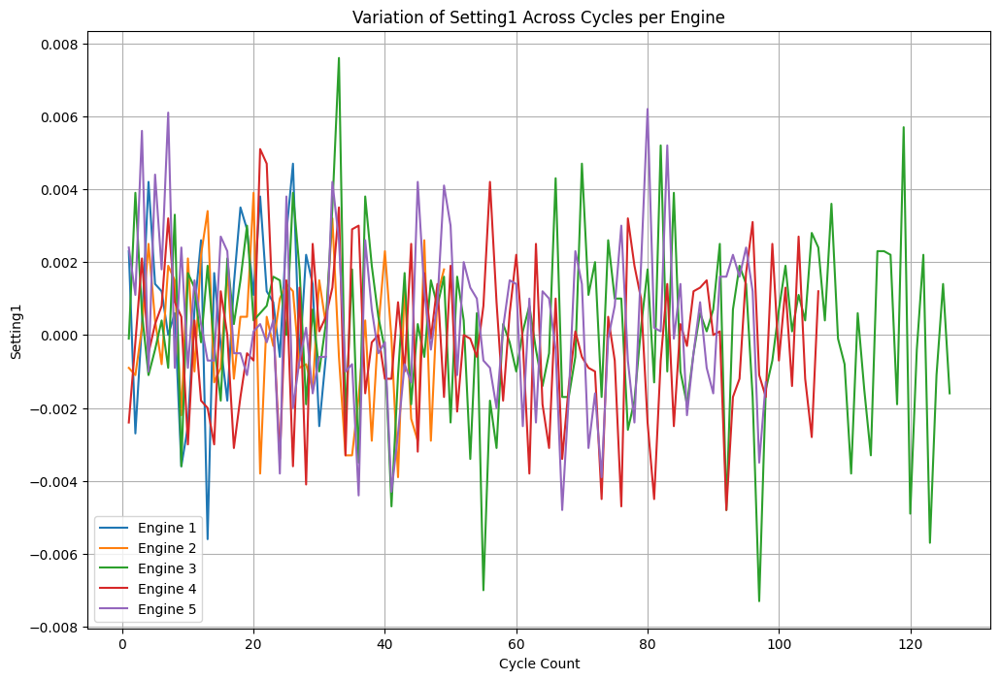

In [ ]:
# Selecting specific engine IDs to visualize
selected_engines = [1, 2, 3, 4, 5]


plt.figure(figsize=(12, 8))


for eid in selected_engines:
    subset = test_1.loc[test_1['engine'] == eid]
    plt.plot(subset['cycle'], subset['setting1'], label=f'Engine {eid}')


plt.title('Variation of Setting1 Across Cycles per Engine')
plt.xlabel('Cycle Count')
plt.ylabel('Setting1')
plt.legend()
plt.grid(True)


plt.show()


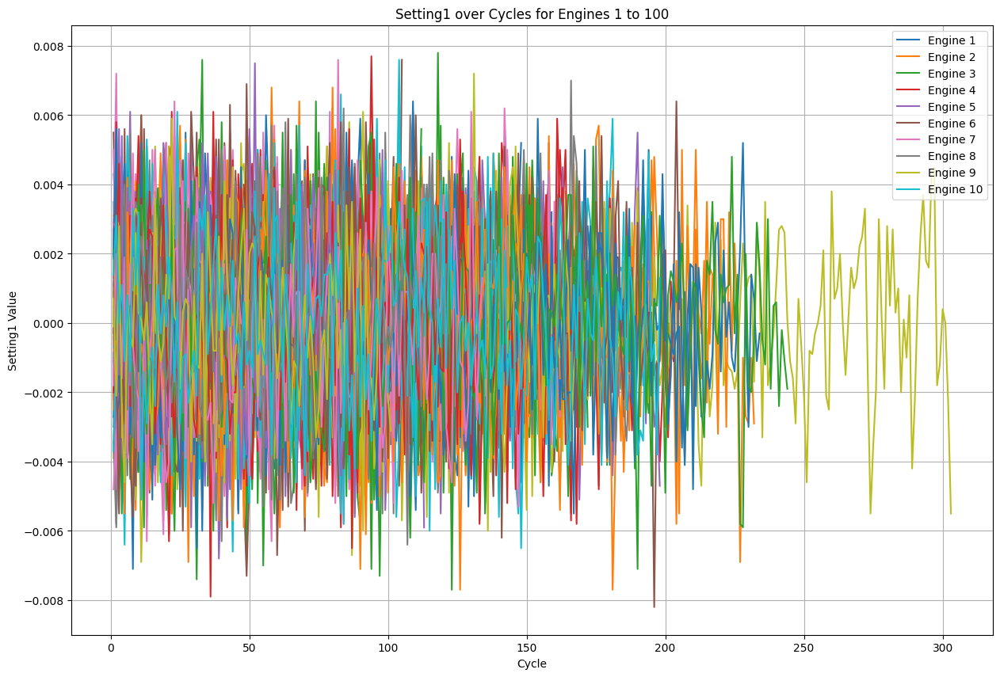

In [ ]:
engines_to_plot = range(1, 101)  # Engine numbers from 1 to 100


plt.figure(figsize=(15, 10))


for engine_number in engines_to_plot:
    engine_data = test_1[test_1['engine'] == engine_number]
    plt.plot(engine_data['cycle'], engine_data['setting1'], label=f'Engine {engine_number}')


plt.title('Setting1 over Cycles for Engines 1 to 100')
plt.xlabel('Cycle')
plt.ylabel('Setting1 Value')


handles, labels = plt.gca().get_legend_handles_labels()
plt.legend(handles[:10], labels[:10], loc='upper right')
plt.grid(True)

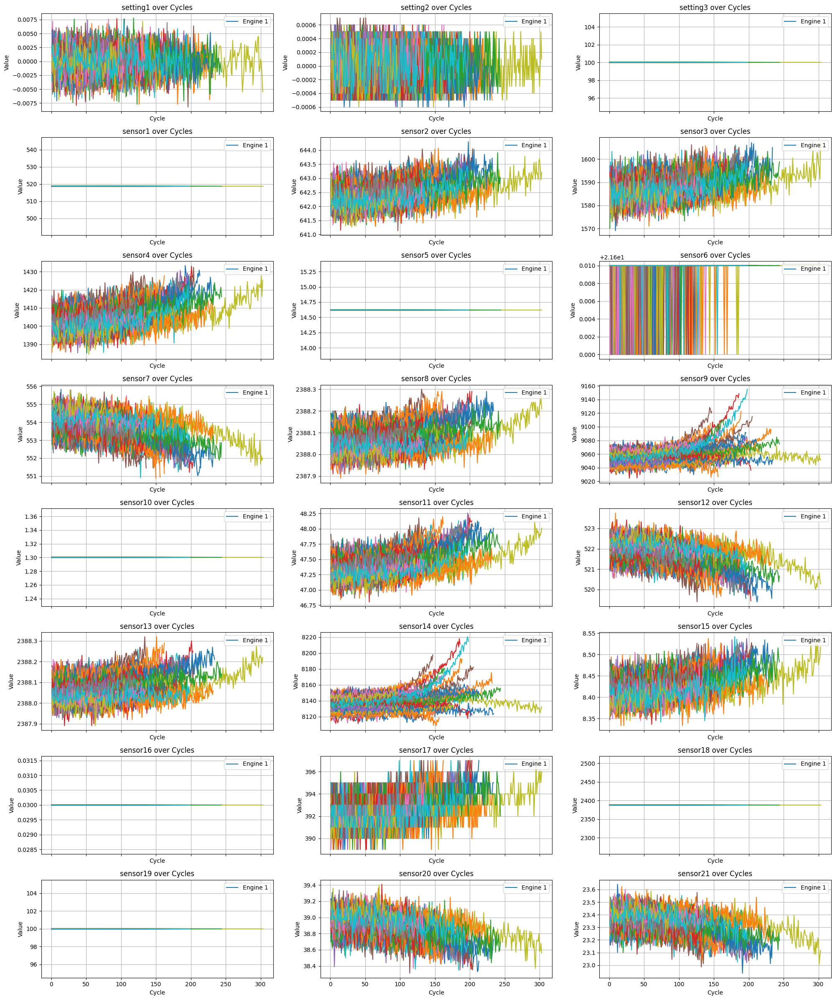

In [ ]:
engines_to_plot = range(1, 101)  # Engine numbers from 1 to 100


columns_to_plot = ['setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


num_columns = 3
num_rows = (len(columns_to_plot) + num_columns - 1) // num_columns
fig, axes = plt.subplots(num_rows, num_columns, figsize=(20, num_rows * 3), sharex=True)


for engine_number in engines_to_plot:
    engine_data = test_1[test_1['engine'] == engine_number]
    for ax, column in zip(axes.flatten(), columns_to_plot):
        ax.plot(engine_data['cycle'], engine_data[column], label=f'Engine {engine_number}' if engine_number == 1 else "")

for ax, column in zip(axes.flatten(), columns_to_plot):
    ax.set_title(f'{column} over Cycles')
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Value')
    ax.legend(loc='upper right')
    ax.grid(True)


plt.tight_layout()
plt.show()

Observations¶


*   setting1 / setting2: Random fluctuations (Varies mildly per engine, might be useful)
*   setting3: Flat line (Almost constant across all engines - will drop)
*   sensor1, sensor5, sensor6, sensor10, sensor16, sensor18, sensor19: Flat/identical lines (Constant - drop)
*   sensor2, sensor3, sensor4, sensor7, sensor12, sensor15, sensor20, sensor21: Clear trends over time (Great RUL indicators)
*   sensor9, sensor14: Increasing sharply with cycle (useful cause Strong degradation signature)

*   sensor17: Random oscillation (May need deeper analysis or smoothing)

# Feature Engineering

In [ ]:
# Identifing constant features across the training data
sens_const_values = []

# For train_1 and test_1
for feature in train_1.columns:
    if train_1[feature].nunique() == 1:
        sens_const_values.append(feature)


print(f"Constant features removed: {sens_const_values}")

# Dropping constant features from both training and test datasets
train_1.drop(columns=sens_const_values, inplace=True)
test_1.drop(columns=sens_const_values, inplace=True)


Constant features removed: ['setting3', 'sensor1', 'sensor5', 'sensor10', 'sensor16', 'sensor18', 'sensor19']


In [ ]:
# Identifing constant features in train_2
sens_const_values_2 = []

for feature in train_2.columns:
    if train_2[feature].nunique() == 1:
        sens_const_values_2.append(feature)


print(f"Constant features removed from train_2 and test_2: {sens_const_values_2}")

# Droping them from train_2 and test_2
train_2.drop(columns=sens_const_values_2, inplace=True)
test_2.drop(columns=sens_const_values_2, inplace=True)


Constant features removed from train_2 and test_2: []


In [ ]:
# Identifing constant features in train_3
sens_const_values_3 = []

for feature in train_3.columns:
    if train_3[feature].nunique() == 1:
        sens_const_values_3.append(feature)


print(f"Constant features removed from train_3 and test_3: {sens_const_values_3}")

# Dropping them from train_3 and test_3
train_3.drop(columns=sens_const_values_3, inplace=True)
test_3.drop(columns=sens_const_values_3, inplace=True)


Constant features removed from train_3 and test_3: ['setting3', 'sensor1', 'sensor5', 'sensor16', 'sensor18', 'sensor19']


In [ ]:
# Identify constant features in train_4
sens_const_values_4 = []

for feature in train_4.columns:
    if train_4[feature].nunique() == 1:
        sens_const_values_4.append(feature)


print(f"Constant features removed from train_4 and test_4: {sens_const_values_4}")

# Drop them from train_4 and test_4
train_4.drop(columns=sens_const_values_4, inplace=True)
test_4.drop(columns=sens_const_values_4, inplace=True)


Constant features removed from train_4 and test_4: []


In [ ]:
import pandas as pd
import numpy as np

# Computing correlation matrix
cor_matrix = train_1.corr().abs()


upper_tri = cor_matrix.where(np.triu(np.ones(cor_matrix.shape), k=1).astype(bool))


corr_features = [column for column in upper_tri.columns if any(upper_tri[column] > 0.95)]


train_1_filtered = train_1.drop(corr_features, axis=1)
test_1_filtered = test_1.drop(corr_features, axis=1)


print("Highly Correlated Features (correlation > 0.95):")
print(corr_features)


Highly Correlated Features (correlation > 0.95):
['sensor14']


In [ ]:
import pandas as pd
import numpy as np


cor_matrix = train_2.corr().abs()


upper_tri = cor_matrix.where(np.triu(np.ones(cor_matrix.shape), k=1).astype(bool))

corr_features_2 = [column for column in upper_tri.columns if any(upper_tri[column] > 0.95)]


train_2_filtered = train_2.drop(corr_features_2, axis=1)
test_2_filtered = test_2.drop(corr_features_2, axis=1)

# Displaying the correlated features
print("Highly Correlated Features in train_2 and test_2 (correlation > 0.95):")
print(corr_features_2)


Highly Correlated Features in train_2 and test_2 (correlation > 0.95):
['sensor1', 'sensor3', 'sensor4', 'sensor5', 'sensor6', 'sensor7', 'sensor9', 'sensor10', 'sensor11', 'sensor12', 'sensor13', 'sensor15', 'sensor17', 'sensor18', 'sensor19', 'sensor20', 'sensor21']


In [ ]:
import pandas as pd
import numpy as np

# Computing correlation matrix for train_3
cor_matrix = train_3.corr().abs()


upper_tri = cor_matrix.where(np.triu(np.ones(cor_matrix.shape), k=1).astype(bool))


corr_features_3 = [column for column in upper_tri.columns if any(upper_tri[column] > 0.95)]

# Dropping the highly correlated features
train_3_filtered = train_3.drop(corr_features_3, axis=1)
test_3_filtered = test_3.drop(corr_features_3, axis=1)

# Displaying the correlated features
print("Highly Correlated Features in train_3 and test_3 (correlation > 0.95):")
print(corr_features_3)


Highly Correlated Features in train_3 and test_3 (correlation > 0.95):
['sensor12', 'sensor13', 'sensor14']


In [ ]:
import pandas as pd
import numpy as np

# Compute correlation matrix for train_4
cor_matrix = train_4.corr().abs()


upper_tri = cor_matrix.where(np.triu(np.ones(cor_matrix.shape), k=1).astype(bool))


corr_features_4 = [column for column in upper_tri.columns if any(upper_tri[column] > 0.95)]

# Dropping the highly correlated features
train_4_filtered = train_4.drop(corr_features_4, axis=1)
test_4_filtered = test_4.drop(corr_features_4, axis=1)

# Displaying the correlated features
print("Highly Correlated Features in train_4 and test_4 (correlation > 0.95):")
print(corr_features_4)


Highly Correlated Features in train_4 and test_4 (correlation > 0.95):
['sensor1', 'sensor3', 'sensor4', 'sensor5', 'sensor6', 'sensor7', 'sensor9', 'sensor10', 'sensor11', 'sensor12', 'sensor13', 'sensor15', 'sensor17', 'sensor18', 'sensor19', 'sensor20', 'sensor21']


In [ ]:
import pandas as pd

def get_useful_features(df, threshold=1e-3):

    feature_variances = df.var()
    useful_features = feature_variances[feature_variances > threshold].index.tolist()
    return useful_features




In [ ]:
datasets = [train_1, train_2, train_3, train_4]
for i, df in enumerate(datasets, start=1):
    useful = get_useful_features(df)
    print(f"Useful features for Train {i}:", useful)


Useful features for Train 1: ['engine', 'cycle', 'sensor2', 'sensor3', 'sensor4', 'sensor7', 'sensor8', 'sensor9', 'sensor11', 'sensor12', 'sensor13', 'sensor14', 'sensor15', 'sensor17', 'sensor20', 'sensor21', 'max_cycle', 'RUL']
Useful features for Train 2: ['engine', 'cycle', 'setting1', 'setting2', 'setting3', 'sensor1', 'sensor2', 'sensor3', 'sensor4', 'sensor5', 'sensor6', 'sensor7', 'sensor8', 'sensor9', 'sensor10', 'sensor11', 'sensor12', 'sensor13', 'sensor14', 'sensor15', 'sensor17', 'sensor18', 'sensor19', 'sensor20', 'sensor21']
Useful features for Train 3: ['engine', 'cycle', 'sensor2', 'sensor3', 'sensor4', 'sensor7', 'sensor8', 'sensor9', 'sensor11', 'sensor12', 'sensor13', 'sensor14', 'sensor15', 'sensor17', 'sensor20', 'sensor21']
Useful features for Train 4: ['engine', 'cycle', 'setting1', 'setting2', 'setting3', 'sensor1', 'sensor2', 'sensor3', 'sensor4', 'sensor5', 'sensor6', 'sensor7', 'sensor8', 'sensor9', 'sensor10', 'sensor11', 'sensor12', 'sensor13', 'sensor14'

# Calculating RUL

In [ ]:

if 'max_cycle' in train_1.columns:
    train_1.drop(columns='max_cycle', inplace=True)

#  Computing max cycle per engine
rul_df = train_1.groupby('engine', as_index=False)['cycle'].max()
rul_df.columns = ['engine', 'max_cycle']

# Merging max_cycle with train_1
train_1 = pd.merge(train_1, rul_df, on='engine', how='left')

# Calculate RUL
train_1['RUL'] = train_1['max_cycle'] - train_1['cycle']
train_1['RUL'] = train_1['RUL'].clip(upper=125)


sensor_cols = [col for col in train_1.columns if col.startswith('sensor')]

# Displaying selected columns
columns_to_display = ['engine', 'cycle'] + sensor_cols + ['RUL']
print(train_1[columns_to_display].head(10))


   engine  cycle  sensor2  sensor3  sensor4  sensor6  sensor7  sensor8  \
0       1      1   641.82  1589.70  1400.60    21.61   554.36  2388.06   
1       1      2   642.15  1591.82  1403.14    21.61   553.75  2388.04   
2       1      3   642.35  1587.99  1404.20    21.61   554.26  2388.08   
3       1      4   642.35  1582.79  1401.87    21.61   554.45  2388.11   
4       1      5   642.37  1582.85  1406.22    21.61   554.00  2388.06   
5       1      6   642.10  1584.47  1398.37    21.61   554.67  2388.02   
6       1      7   642.48  1592.32  1397.77    21.61   554.34  2388.02   
7       1      8   642.56  1582.96  1400.97    21.61   553.85  2388.00   
8       1      9   642.12  1590.98  1394.80    21.61   553.69  2388.05   
9       1     10   641.71  1591.24  1400.46    21.61   553.59  2388.05   

   sensor9  sensor11  sensor12  sensor13  sensor14  sensor15  sensor17  \
0  9046.19     47.47    521.66   2388.02   8138.62    8.4195       392   
1  9044.07     47.49    522.28   2388

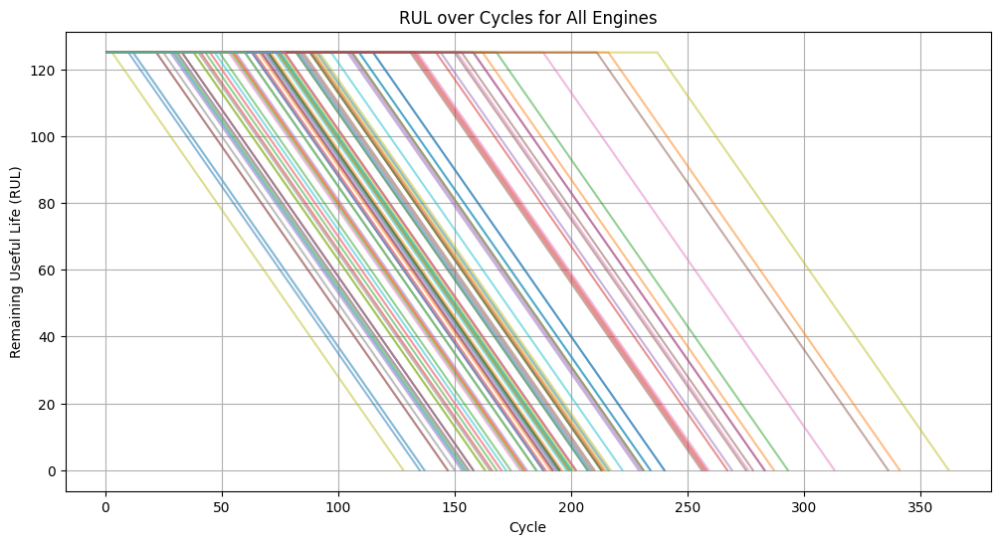

In [ ]:
# Plotting RUL over cycles for each engine
plt.figure(figsize=(12, 6))
for engine_id in train_1['engine'].unique():
    engine_data = train_1[train_1['engine'] == engine_id]
    plt.plot(engine_data['cycle'], engine_data['RUL'], alpha=0.5)

plt.title('RUL over Cycles for All Engines')
plt.xlabel('Cycle')
plt.ylabel('Remaining Useful Life (RUL)')
plt.grid(True)
plt.show()



*   Each colored line represents an individual engine.

*   RUL decreases linearly over time for each engine, starting from a capped maximum (125) and decreasing to 0 as the engine approaches failure.

*   This behavior is expected because RUL is computed as:

          RUL=min(max_cycle−current_cycle,125)






# Correlation of Features with RUL

In [ ]:
import pandas as pd

# List of training datasets
train_datasets = [train_1, train_2, train_3, train_4]
dataset_names = ['Train 1', 'Train 2', 'Train 3', 'Train 4']

# Defining settings and sensor columns to analyze
setting_cols = ['setting1', 'setting2', 'setting3']
sensor_cols = [f'sensor{i}' for i in range(1, 22)]
feature_cols = setting_cols + sensor_cols

# Function to calculate correlations for each dataset
def calculate_feature_correlations(train_data, label='RUL'):

    if label not in train_data.columns:

        rul_df = train_data.groupby('engine', as_index=False)['cycle'].max()
        rul_df.columns = ['engine', 'max_cycle']
        train_data = pd.merge(train_data, rul_df, on='engine', how='left')
        train_data[label] = train_data['max_cycle'] - train_data['cycle']
        train_data[label] = train_data[label].clip(upper=125)
        train_data.drop(columns=['max_cycle'], inplace=True)


    available_cols = list(set(feature_cols + [label]).intersection(train_data.columns))


    correlations = train_data[available_cols].corr()[label]
    return correlations.drop(label, errors='ignore')

# Store results
correlation_results = {}

# Compute and display correlations
for name, df in zip(dataset_names, train_datasets):
    corr = calculate_feature_correlations(df)
    correlation_results[name] = corr
    print(f"\n Correlation of Features with RUL - {name}")
    print(corr.sort_values(ascending=False))




📊 Correlation of Features with RUL - Train 1
sensor12    0.748870
sensor7     0.733021
sensor21    0.707334
sensor20    0.704626
setting1   -0.005556
setting2   -0.007091
sensor6    -0.108289
sensor14   -0.369753
sensor9    -0.462151
sensor13   -0.624034
sensor8    -0.624568
sensor3    -0.655030
sensor2    -0.678458
sensor17   -0.680829
sensor15   -0.720858
sensor4    -0.757157
sensor11   -0.775230
Name: RUL, dtype: float64

📊 Correlation of Features with RUL - Train 2
sensor20    0.006539
sensor21    0.006417
sensor10    0.003245
sensor19    0.002180
setting3    0.002180
sensor7     0.002110
sensor12    0.001897
sensor13    0.001566
sensor18    0.001563
sensor8     0.001047
setting1    0.000535
setting2   -0.000447
sensor1    -0.000571
sensor5    -0.000594
sensor6    -0.000658
sensor2    -0.007353
sensor9    -0.020981
sensor3    -0.032421
sensor17   -0.032691
sensor15   -0.039544
sensor4    -0.047688
sensor11   -0.055428
sensor14   -0.056143
sensor16   -0.087709
Name: RUL, dtype: flo

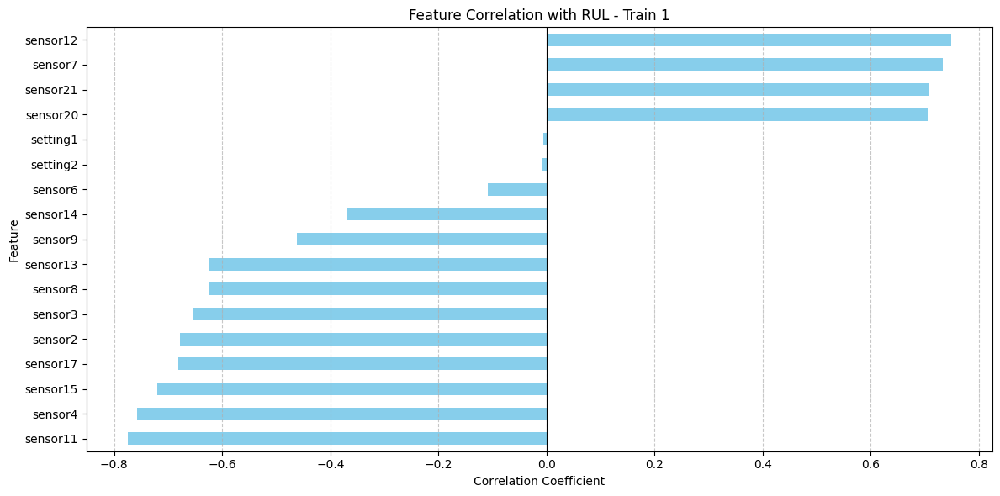

In [ ]:
import matplotlib.pyplot as plt


correlations = correlation_results['Train 1']

plt.figure(figsize=(12, 6))
correlations.sort_values().plot(kind='barh', color='skyblue')
plt.axvline(0, color='black', linewidth=0.8)
plt.title("Feature Correlation with RUL - Train 1")
plt.xlabel("Correlation Coefficient")
plt.ylabel("Feature")
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


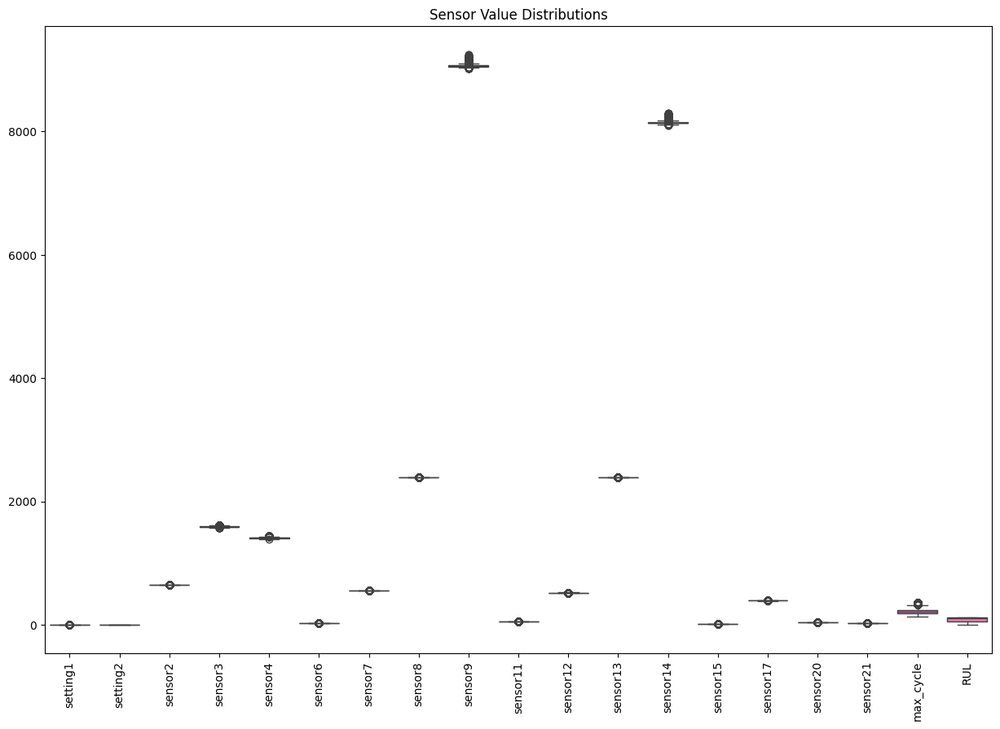

In [ ]:
plt.figure(figsize=(15,10))
sns.boxplot(data=train_1.iloc[:, 2:])
plt.xticks(rotation=90)
plt.title("Sensor Value Distributions")
plt.show()

Wide boxes/Long whiskers ( sensors like 8,11,14 etc ) are with high variability means degradation signals can be captured. Very tight boxes ( sensors like 1,5,10,16,18,19 ) are constant features. Outliers could be noise or cases of failure.

# Anamoly Detection

Saving train_FD001.txt to train_FD001 (1).txt
Classification Report (LOF vs Synthetic Anomalies):
              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95     19600
         1.0       0.04      0.04      0.04      1031

    accuracy                           0.90     20631
   macro avg       0.49      0.49      0.49     20631
weighted avg       0.90      0.90      0.90     20631


Top sensors contributing to anomalies based on variance difference:
['sensor9', 'sensor14', 'sensor4', 'sensor3', 'sensor17']


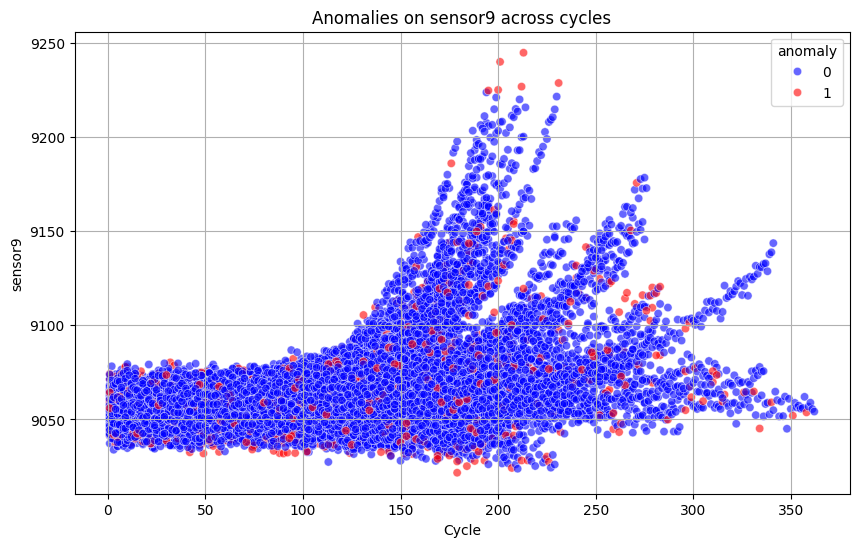

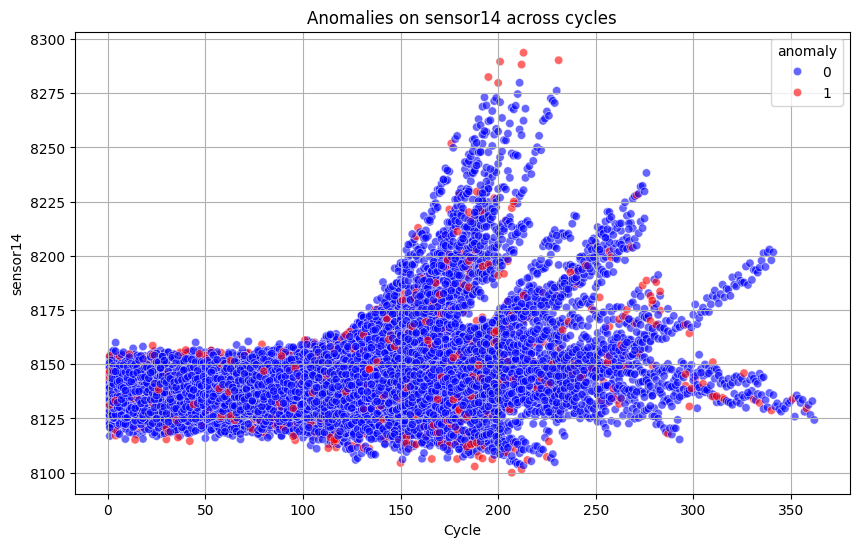

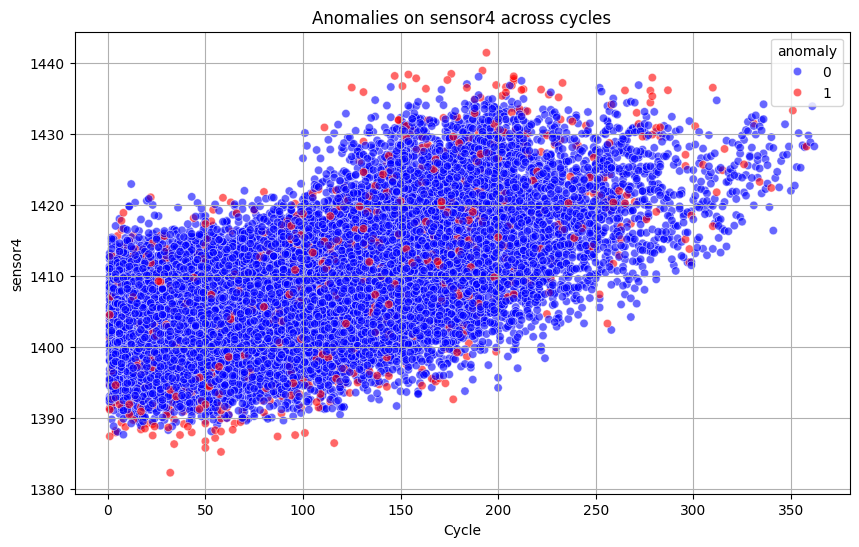

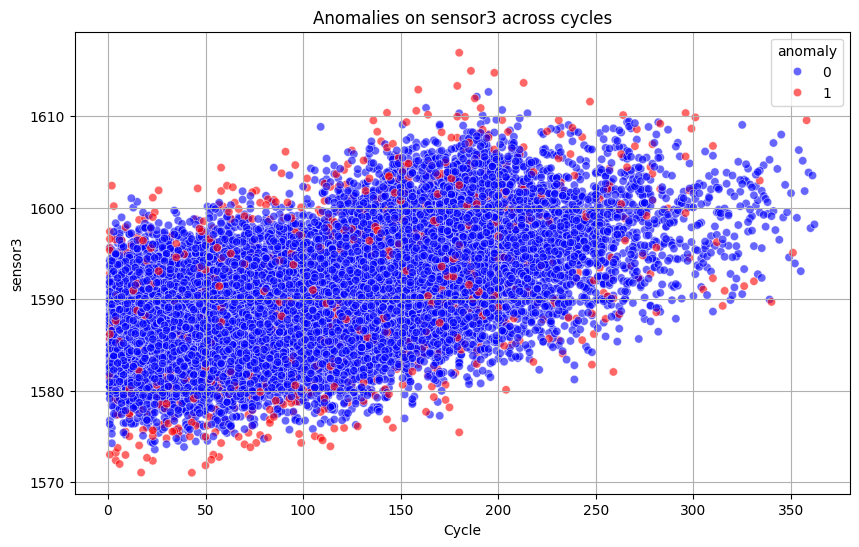

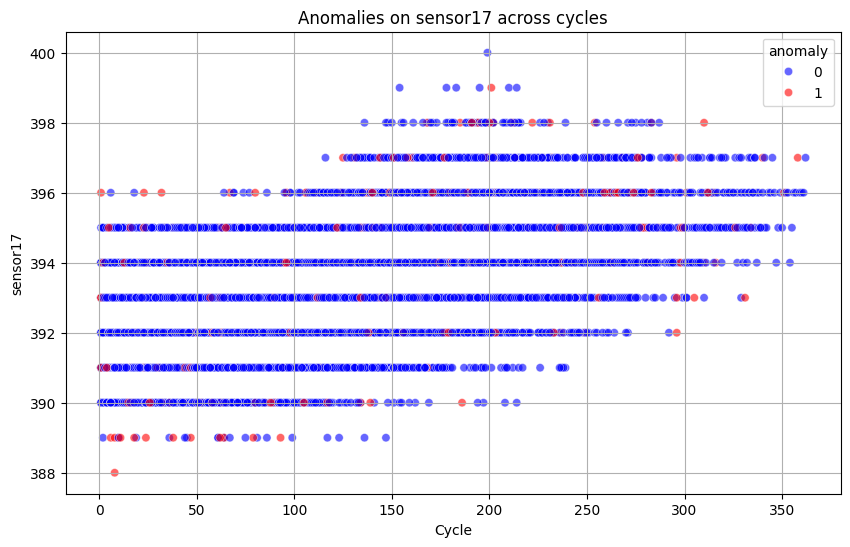

Shape after removing anomalies: (19599, 28)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files


uploaded = files.upload()
file_path = "train_FD001.txt"


df = pd.read_csv(file_path, sep=" ", header=None)
df.drop(columns=[26, 27], inplace=True)
df.columns = ['engine', 'cycle', 'setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


rul_df = df.groupby('engine', as_index=False)['cycle'].max()
rul_df.columns = ['engine', 'max_cycle']
df = pd.merge(df, rul_df, on='engine', how='left')
df['RUL'] = df['max_cycle'] - df['cycle']
df['RUL'] = df['RUL'].clip(upper=125)
df.drop(columns=['max_cycle'], inplace=True)

# Applying Local Outlier Factor (LOF)
sensor_cols = [col for col in df.columns if col.startswith('sensor')]
X = df[sensor_cols]

lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
y_pred = lof.fit_predict(X)
df['anomaly'] = np.where(y_pred == -1, 1, 0)

# Creating synthetic ground truth for evaluation
y_true = np.zeros(len(df))
anomaly_indices = np.random.choice(df.index, size=int(0.05 * len(df)), replace=False)
y_true[anomaly_indices] = 1


print("Classification Report (LOF vs Synthetic Anomalies):")
print(classification_report(y_true, df['anomaly']))

# Identifying top contributing sensors to anomalies
anomaly_df = df[df['anomaly'] == 1]
normal_df = df[df['anomaly'] == 0]

# Computing variance differences for each sensor between anomaly and normal
sensor_variances = {
    sensor: abs(anomaly_df[sensor].var() - normal_df[sensor].var())
    for sensor in sensor_cols
}
top_sensors = sorted(sensor_variances, key=sensor_variances.get, reverse=True)[:5]

print("\nTop sensors contributing to anomalies based on variance difference:")
print(top_sensors)

# Step 7: Plotting anomalies across top sensors
for sensor in top_sensors:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='cycle', y=sensor, data=df, hue='anomaly', palette={0: "blue", 1: "red"}, alpha=0.6)
    plt.title(f"Anomalies on {sensor} across cycles")
    plt.xlabel("Cycle")
    plt.ylabel(sensor)
    plt.grid(True)
    plt.show()


df_clean_train_1 = df[df['anomaly'] == 0].reset_index(drop=True)
print(f"Shape after removing anomalies: {df_clean_train_1.shape}")


Saving train_FD002.txt to train_FD002 (1).txt
Classification Report (LOF vs Synthetic Anomalies):
              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95     51072
         1.0       0.04      0.04      0.04      2687

    accuracy                           0.90     53759
   macro avg       0.50      0.50      0.50     53759
weighted avg       0.90      0.90      0.90     53759


Top sensors contributing to anomalies based on variance difference:
['sensor9', 'sensor18', 'sensor8', 'sensor13', 'sensor14']


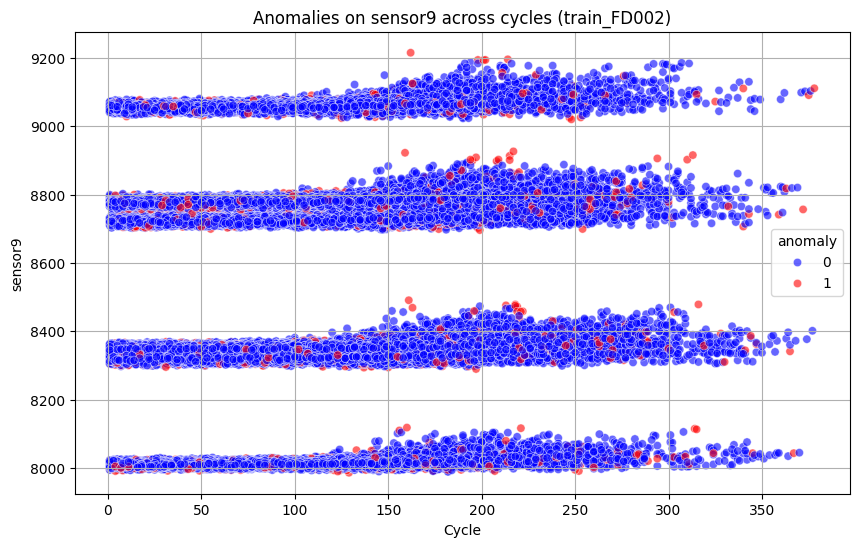

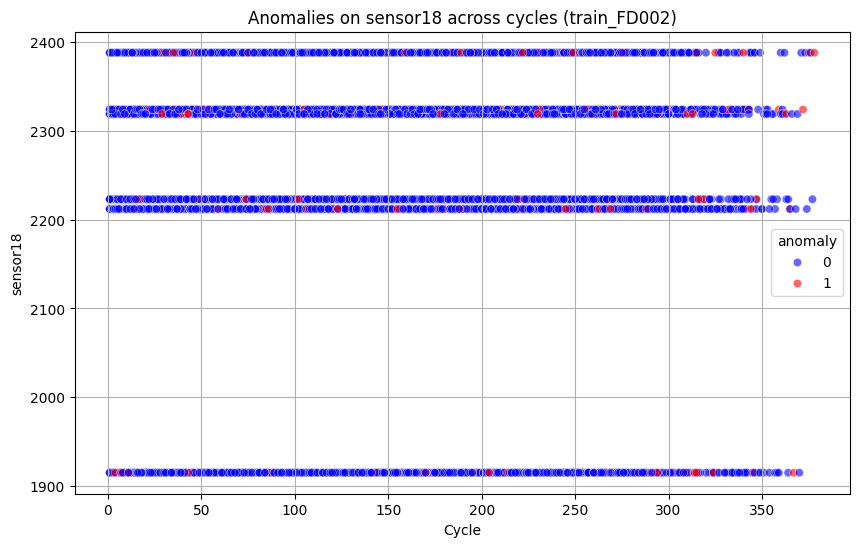

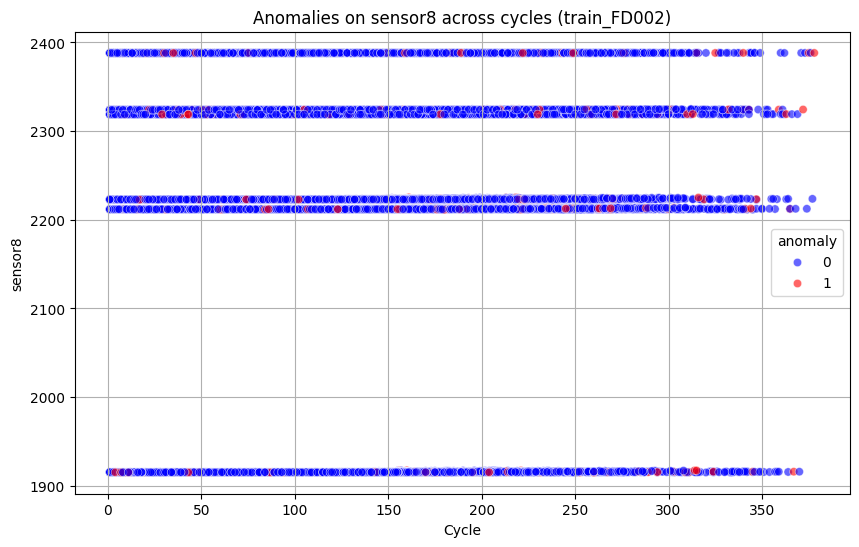

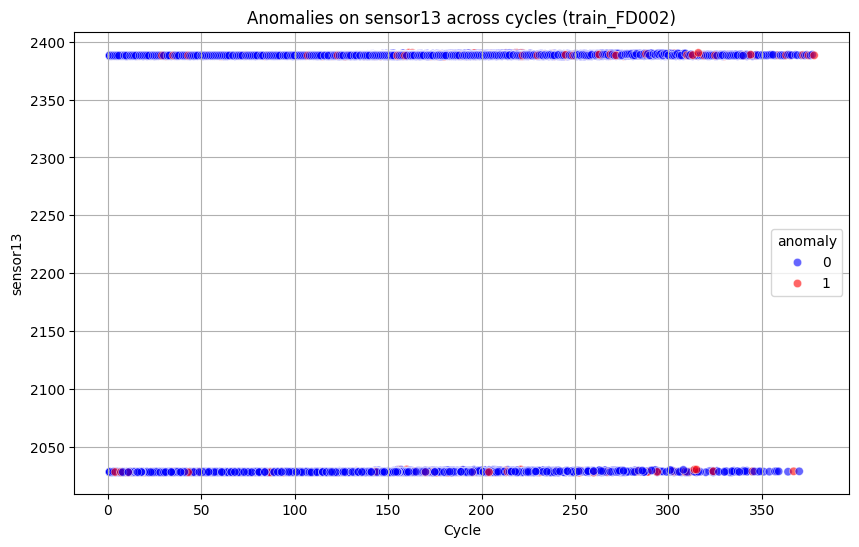

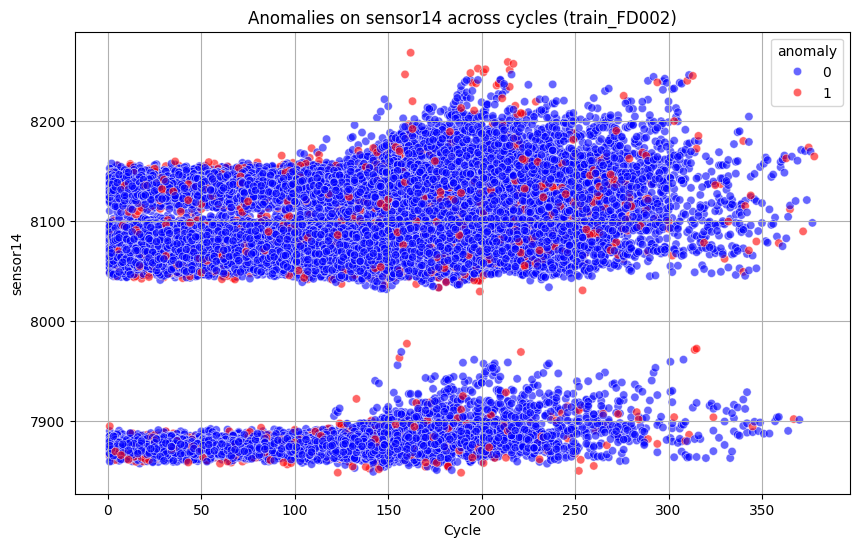

Shape after removing anomalies (train_FD002): (51071, 28)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files


uploaded = files.upload()
file_path = "train_FD002.txt"


df = pd.read_csv(file_path, sep=" ", header=None)
df.drop(columns=[26, 27], inplace=True)
df.columns = ['engine', 'cycle', 'setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


rul_df = df.groupby('engine', as_index=False)['cycle'].max()
rul_df.columns = ['engine', 'max_cycle']
df = pd.merge(df, rul_df, on='engine', how='left')
df['RUL'] = df['max_cycle'] - df['cycle']
df['RUL'] = df['RUL'].clip(upper=125)
df.drop(columns=['max_cycle'], inplace=True)


sensor_cols = [col for col in df.columns if col.startswith('sensor')]
X = df[sensor_cols]

# Fitting Local Outlier Factor
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
y_pred = lof.fit_predict(X)
df['anomaly'] = np.where(y_pred == -1, 1, 0)

# Creating synthetic ground truth
y_true = np.zeros(len(df))
anomaly_indices = np.random.choice(df.index, size=int(0.05 * len(df)), replace=False)
y_true[anomaly_indices] = 1

# Evaluation metrics
print("Classification Report (LOF vs Synthetic Anomalies):")
print(classification_report(y_true, df['anomaly']))

# Identifying top contributing sensors
anomaly_df = df[df['anomaly'] == 1]
normal_df = df[df['anomaly'] == 0]

sensor_variances = {
    sensor: abs(anomaly_df[sensor].var() - normal_df[sensor].var())
    for sensor in sensor_cols
}
top_sensors = sorted(sensor_variances, key=sensor_variances.get, reverse=True)[:5]

print("\nTop sensors contributing to anomalies based on variance difference:")
print(top_sensors)

# Step 8: Plotting anomalies for top 5 sensors
for sensor in top_sensors:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='cycle', y=sensor, data=df, hue='anomaly', palette={0: "blue", 1: "red"}, alpha=0.6)
    plt.title(f"Anomalies on {sensor} across cycles (train_FD002)")
    plt.xlabel("Cycle")
    plt.ylabel(sensor)
    plt.grid(True)
    plt.show()


df_clean_train_2 = df[df['anomaly'] == 0].reset_index(drop=True)
print(f"Shape after removing anomalies (train_FD002): {df_clean_train_2.shape}")



Classification Report (train_FD003):
              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95     23484
         1.0       0.05      0.05      0.05      1236

    accuracy                           0.91     24720
   macro avg       0.50      0.50      0.50     24720
weighted avg       0.91      0.91      0.91     24720


Top anomaly-contributing sensors (train_FD003): ['sensor9', 'sensor14', 'sensor4', 'sensor3', 'sensor7']


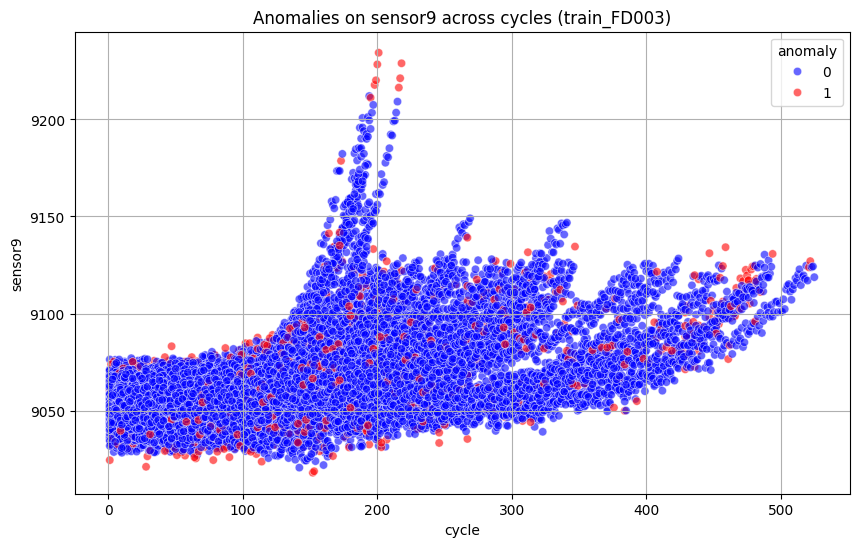

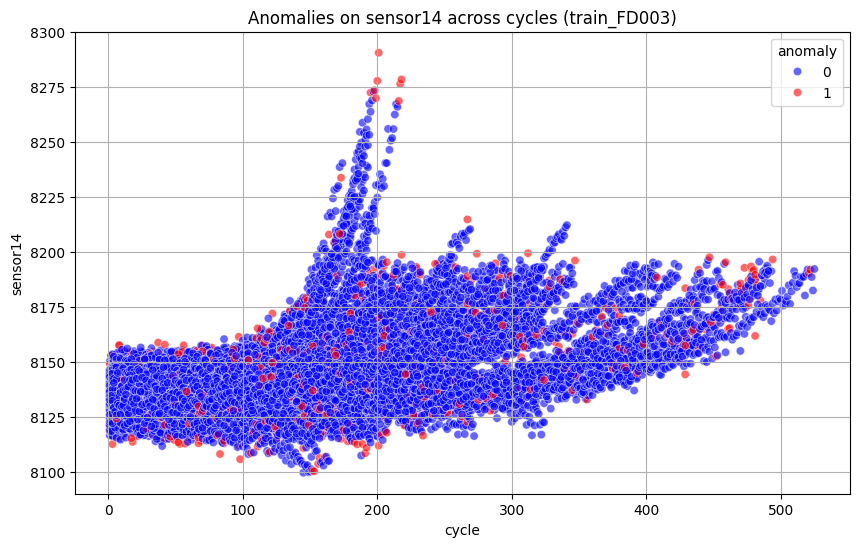

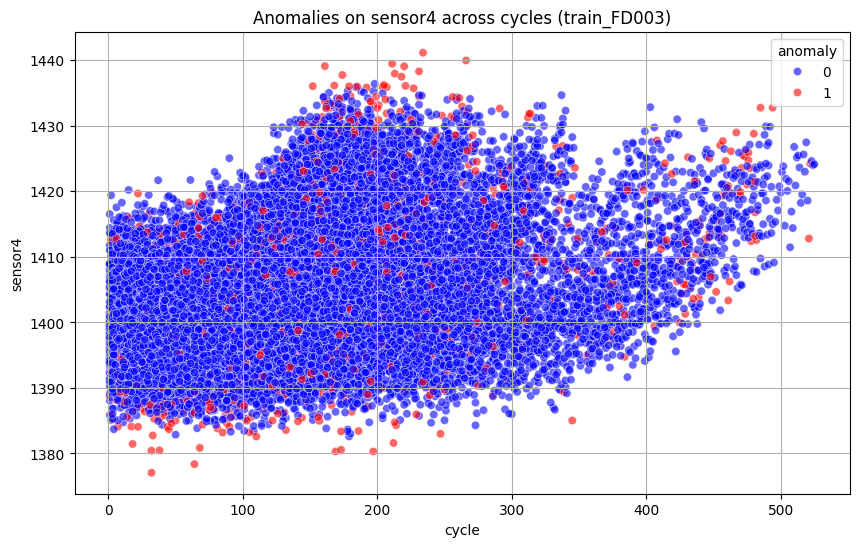

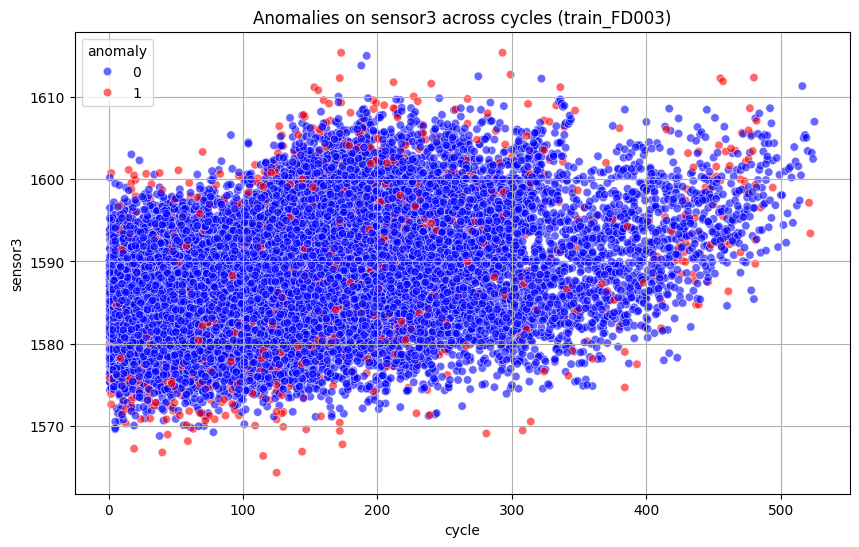

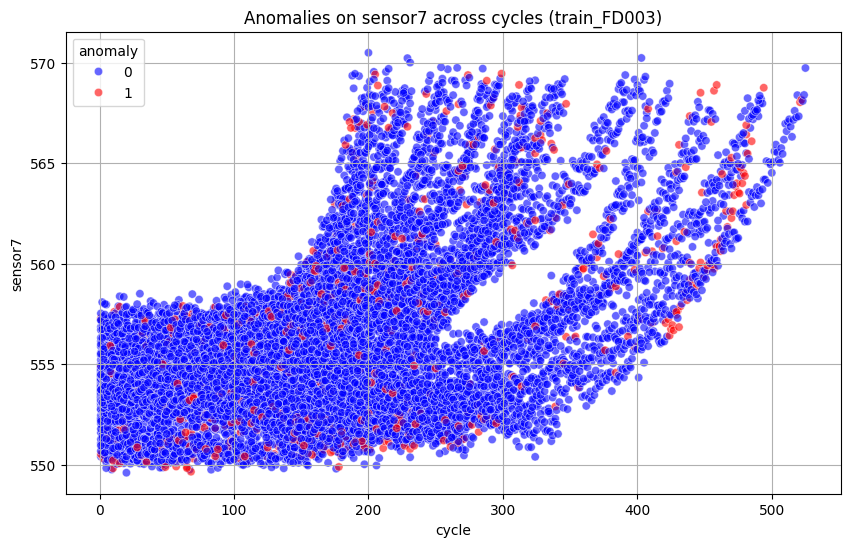

Shape after removing anomalies (train_FD003): (23484, 28)


In [ ]:
# ---- TRAIN FD003 ----
df = pd.read_csv("train_FD003.txt", sep=" ", header=None)
df.drop(columns=[26, 27], inplace=True)
df.columns = ['engine', 'cycle', 'setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]

rul_df = df.groupby('engine', as_index=False)['cycle'].max()
rul_df.columns = ['engine', 'max_cycle']
df = pd.merge(df, rul_df, on='engine', how='left')
df['RUL'] = df['max_cycle'] - df['cycle']
df['RUL'] = df['RUL'].clip(upper=125)
df.drop(columns=['max_cycle'], inplace=True)

sensor_cols = [col for col in df.columns if col.startswith('sensor')]
X = df[sensor_cols]

lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
y_pred = lof.fit_predict(X)
df['anomaly'] = np.where(y_pred == -1, 1, 0)

y_true = np.zeros(len(df))
anomaly_indices = np.random.choice(df.index, size=int(0.05 * len(df)), replace=False)
y_true[anomaly_indices] = 1

print("\nClassification Report (train_FD003):")
from sklearn.metrics import classification_report
print(classification_report(y_true, df['anomaly']))

# Top anomaly-contributing sensors
anomaly_df = df[df['anomaly'] == 1]
normal_df = df[df['anomaly'] == 0]
sensor_variances = {
    sensor: abs(anomaly_df[sensor].var() - normal_df[sensor].var())
    for sensor in sensor_cols
}
top_sensors = sorted(sensor_variances, key=sensor_variances.get, reverse=True)[:5]
print("\nTop anomaly-contributing sensors (train_FD003):", top_sensors)

for sensor in top_sensors:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='cycle', y=sensor, data=df, hue='anomaly', palette={0: "blue", 1: "red"}, alpha=0.6)
    plt.title(f"Anomalies on {sensor} across cycles (train_FD003)")
    plt.grid(True)
    plt.show()

df_clean_train_3 = df[df['anomaly'] == 0].reset_index(drop=True)
print(f"Shape after removing anomalies (train_FD003): {df_clean_train_3.shape}")



Classification Report (train_FD004):
              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95     58187
         1.0       0.05      0.05      0.05      3062

    accuracy                           0.91     61249
   macro avg       0.50      0.50      0.50     61249
weighted avg       0.91      0.91      0.91     61249


Top anomaly-contributing sensors (train_FD004): ['sensor7', 'sensor12', 'sensor9', 'sensor14', 'sensor4']


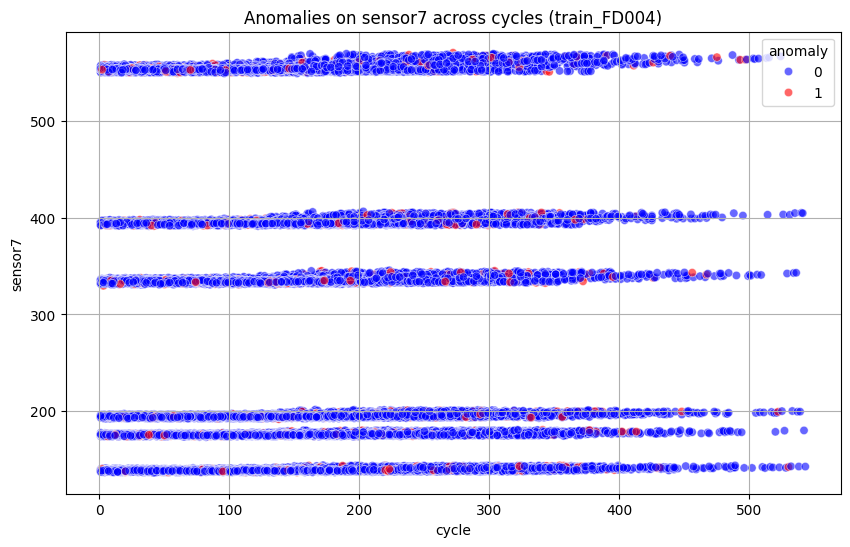

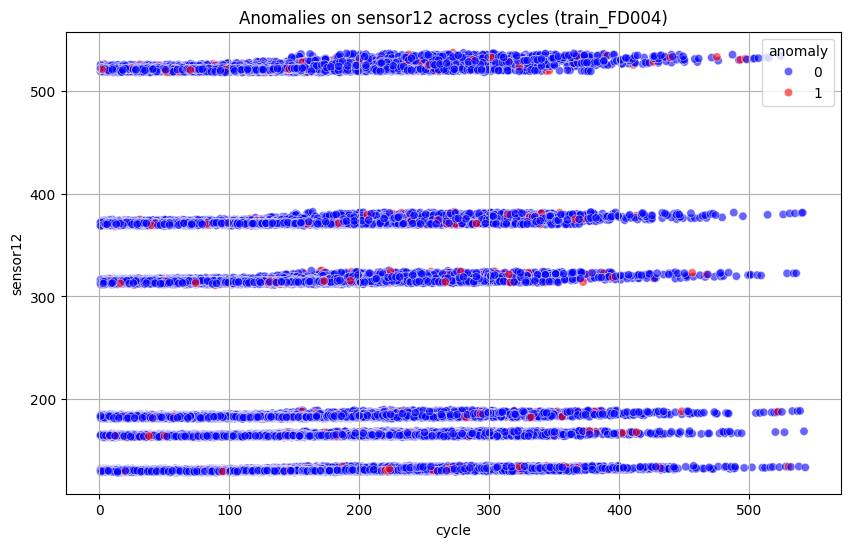

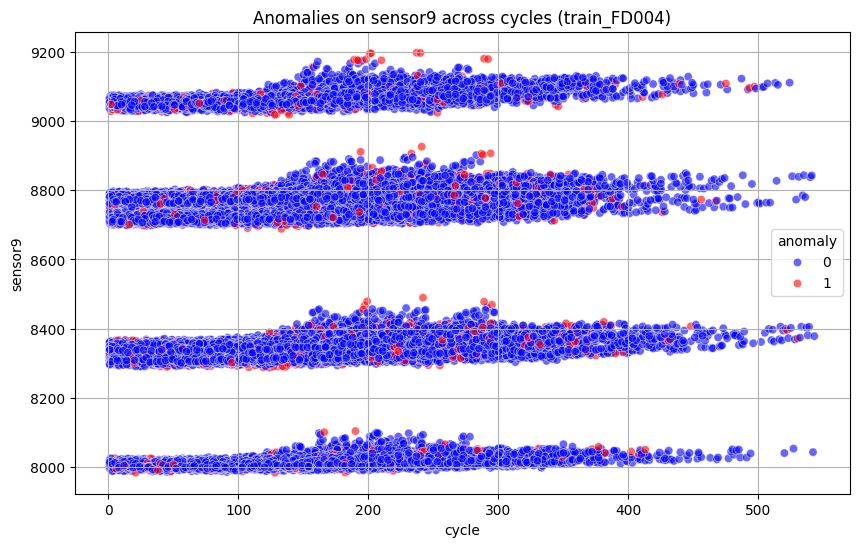

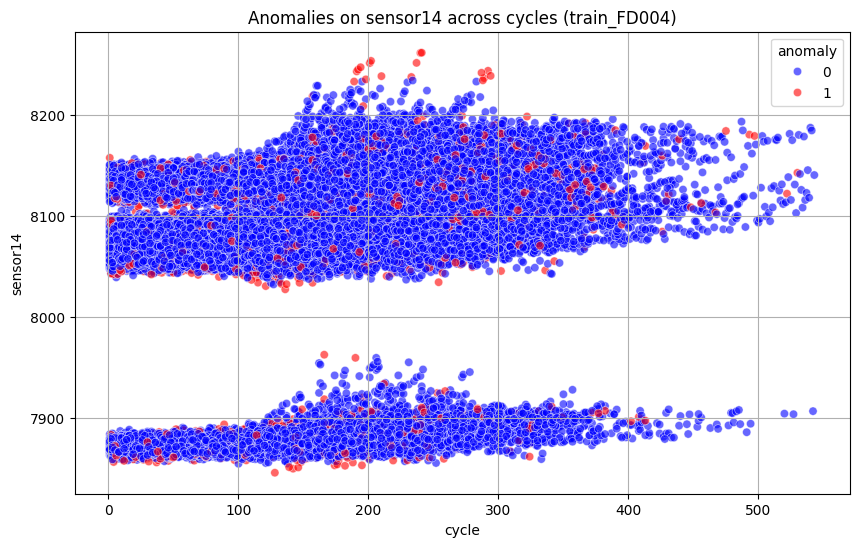

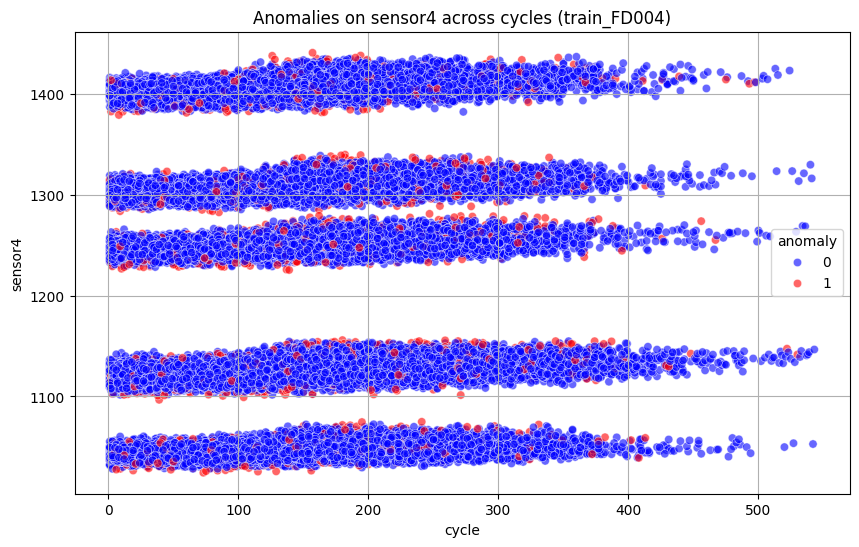

Shape after removing anomalies (train_FD004): (58186, 28)


In [ ]:
# ---- TRAIN FD004 ----
df = pd.read_csv("train_FD004.txt", sep=" ", header=None)
df.drop(columns=[26, 27], inplace=True)
df.columns = ['engine', 'cycle', 'setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]

rul_df = df.groupby('engine', as_index=False)['cycle'].max()
rul_df.columns = ['engine', 'max_cycle']
df = pd.merge(df, rul_df, on='engine', how='left')
df['RUL'] = df['max_cycle'] - df['cycle']
df['RUL'] = df['RUL'].clip(upper=125)
df.drop(columns=['max_cycle'], inplace=True)

sensor_cols = [col for col in df.columns if col.startswith('sensor')]
X = df[sensor_cols]

lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
y_pred = lof.fit_predict(X)
df['anomaly'] = np.where(y_pred == -1, 1, 0)

y_true = np.zeros(len(df))
anomaly_indices = np.random.choice(df.index, size=int(0.05 * len(df)), replace=False)
y_true[anomaly_indices] = 1

print("\nClassification Report (train_FD004):")
print(classification_report(y_true, df['anomaly']))

anomaly_df = df[df['anomaly'] == 1]
normal_df = df[df['anomaly'] == 0]
sensor_variances = {
    sensor: abs(anomaly_df[sensor].var() - normal_df[sensor].var())
    for sensor in sensor_cols
}
top_sensors = sorted(sensor_variances, key=sensor_variances.get, reverse=True)[:5]
print("\nTop anomaly-contributing sensors (train_FD004):", top_sensors)

for sensor in top_sensors:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='cycle', y=sensor, data=df, hue='anomaly', palette={0: "blue", 1: "red"}, alpha=0.6)
    plt.title(f"Anomalies on {sensor} across cycles (train_FD004)")
    plt.grid(True)
    plt.show()

df_clean_train_4 = df[df['anomaly'] == 0].reset_index(drop=True)
print(f"Shape after removing anomalies (train_FD004): {df_clean_train_4.shape}")


Saving test_FD001.txt to test_FD001 (1).txt
Classification Report (LOF vs Synthetic Anomalies):
              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95     12442
         1.0       0.05      0.05      0.05       654

    accuracy                           0.90     13096
   macro avg       0.50      0.50      0.50     13096
weighted avg       0.91      0.90      0.90     13096


Top sensors contributing to anomalies based on variance difference:
['sensor9', 'sensor14', 'sensor4', 'sensor3', 'sensor17']


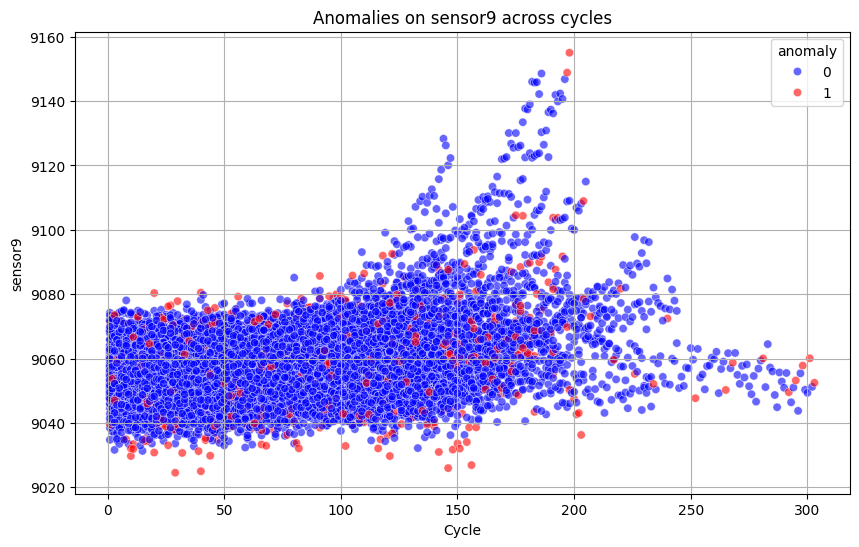

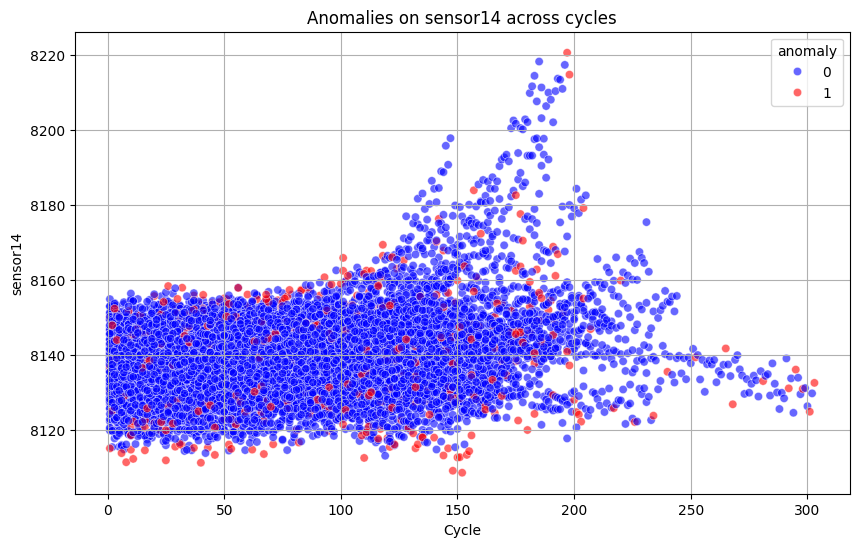

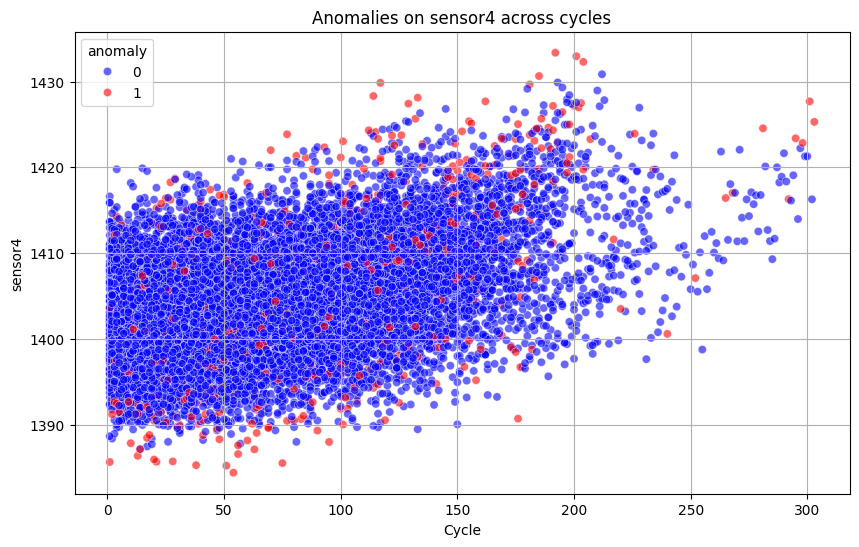

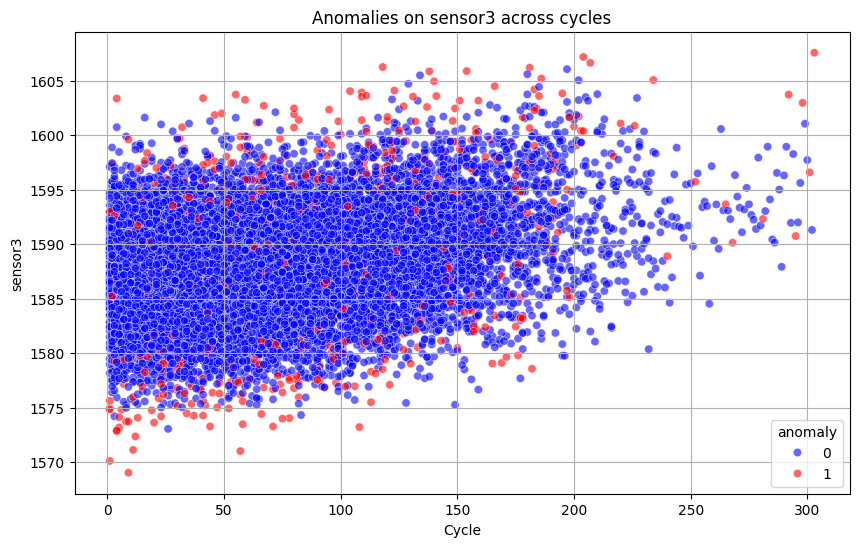

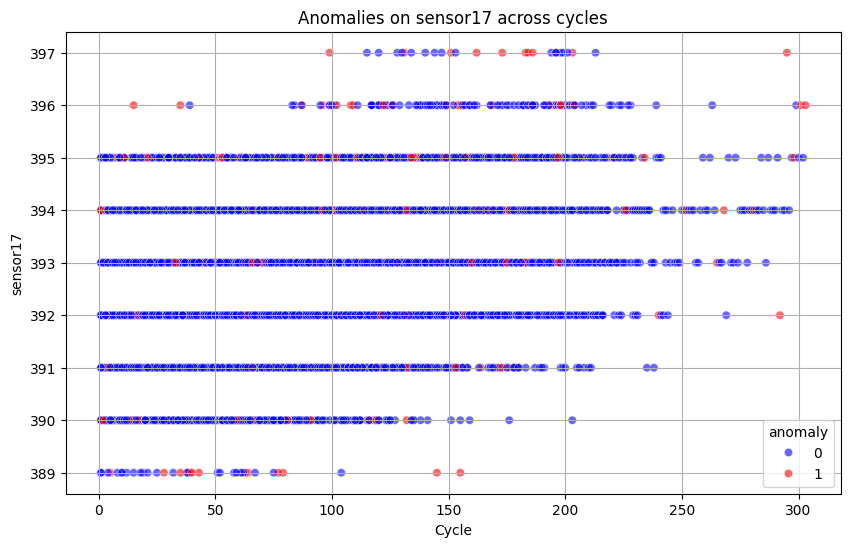

Shape after removing anomalies: (12441, 28)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files


uploaded = files.upload()
file_path = "test_FD001.txt"


df = pd.read_csv(file_path, sep=" ", header=None)
df.drop(columns=[26, 27], inplace=True)
df.columns = ['engine', 'cycle', 'setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


rul_df = df.groupby('engine', as_index=False)['cycle'].max()
rul_df.columns = ['engine', 'max_cycle']
df = pd.merge(df, rul_df, on='engine', how='left')
df['RUL'] = df['max_cycle'] - df['cycle']
df['RUL'] = df['RUL'].clip(upper=125)
df.drop(columns=['max_cycle'], inplace=True)

# Applying Local Outlier Factor (LOF)
sensor_cols = [col for col in df.columns if col.startswith('sensor')]
X = df[sensor_cols]

lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
y_pred = lof.fit_predict(X)
df['anomaly'] = np.where(y_pred == -1, 1, 0)

# Creating synthetic ground truth for evaluation
y_true = np.zeros(len(df))
anomaly_indices = np.random.choice(df.index, size=int(0.05 * len(df)), replace=False)
y_true[anomaly_indices] = 1


print("Classification Report (LOF vs Synthetic Anomalies):")
print(classification_report(y_true, df['anomaly']))

# Identifying top contributing sensors to anomalies
anomaly_df = df[df['anomaly'] == 1]
normal_df = df[df['anomaly'] == 0]

sensor_variances = {
    sensor: abs(anomaly_df[sensor].var() - normal_df[sensor].var())
    for sensor in sensor_cols
}
top_sensors = sorted(sensor_variances, key=sensor_variances.get, reverse=True)[:5]

print("\nTop sensors contributing to anomalies based on variance difference:")
print(top_sensors)

# Plotting anomalies across top sensors
for sensor in top_sensors:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='cycle', y=sensor, data=df, hue='anomaly', palette={0: "blue", 1: "red"}, alpha=0.6)
    plt.title(f"Anomalies on {sensor} across cycles")
    plt.xlabel("Cycle")
    plt.ylabel(sensor)
    plt.grid(True)
    plt.show()


df_clean_test_1 = df[df['anomaly'] == 0].reset_index(drop=True)
print(f"Shape after removing anomalies: {df_clean_test_1.shape}")


Saving test_FD002.txt to test_FD002 (1).txt
Classification Report (LOF vs Synthetic Anomalies):
              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95     32292
         1.0       0.04      0.04      0.04      1699

    accuracy                           0.90     33991
   macro avg       0.50      0.50      0.50     33991
weighted avg       0.90      0.90      0.90     33991


Top sensors contributing to anomalies based on variance difference:
['sensor9', 'sensor13', 'sensor7', 'sensor18', 'sensor8']


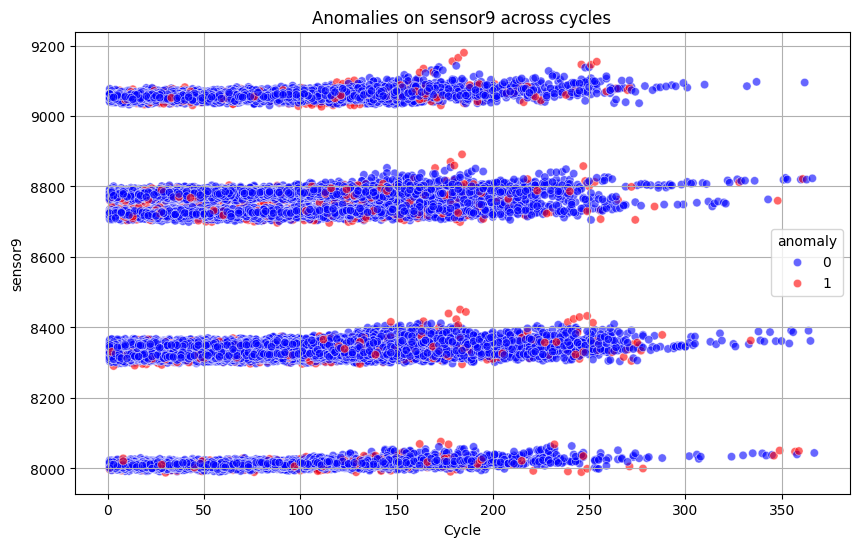

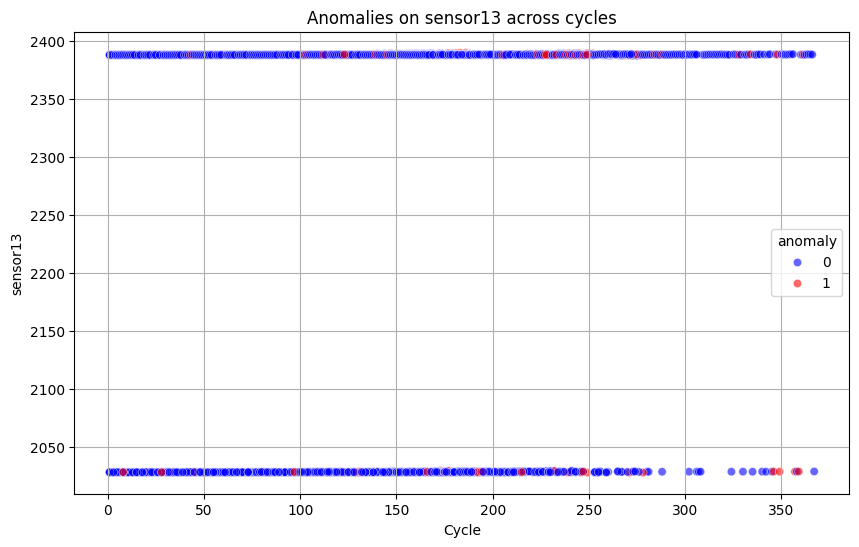

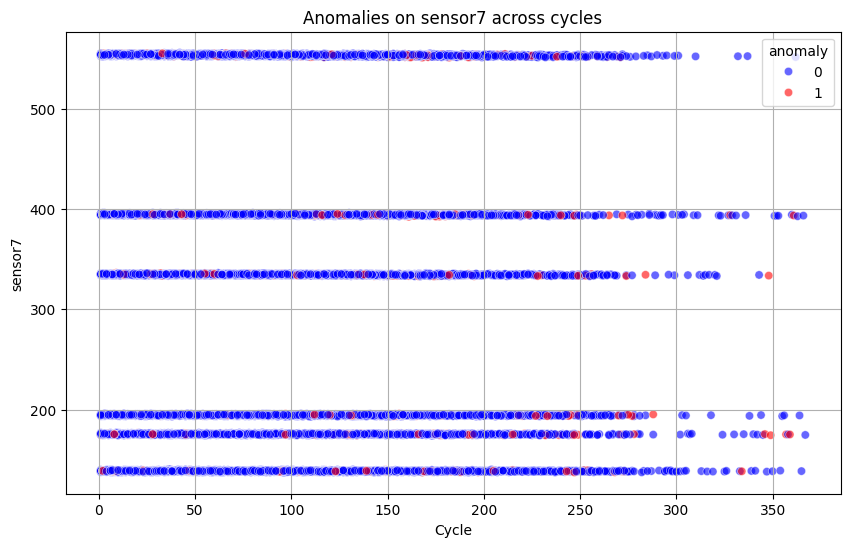

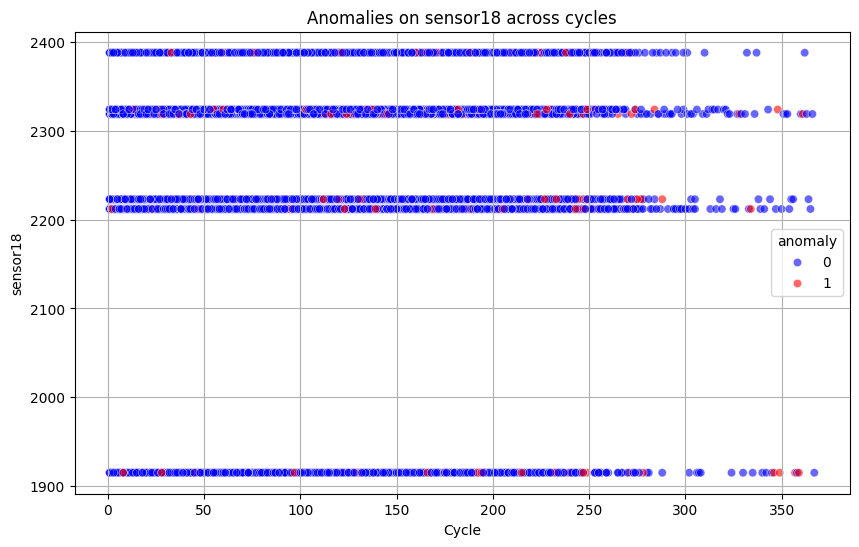

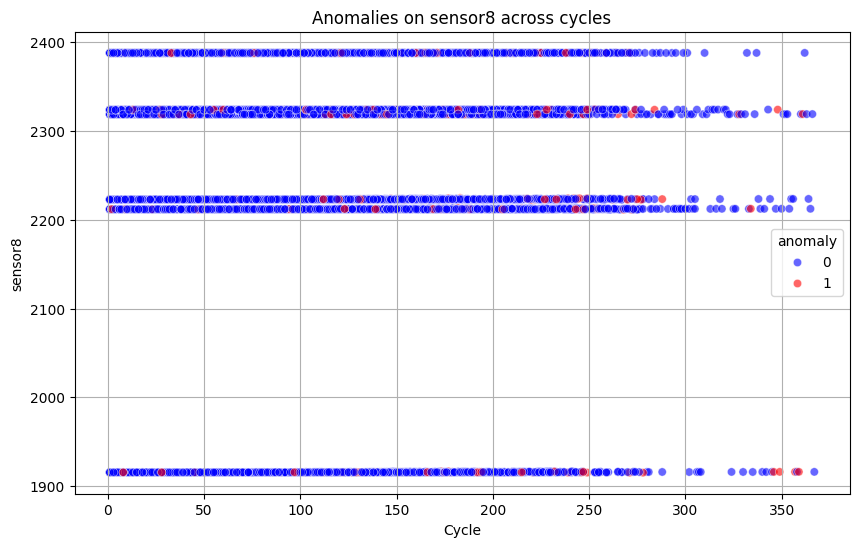

Shape after removing anomalies: (32291, 28)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files


uploaded = files.upload()
file_path = "test_FD002.txt"


df = pd.read_csv(file_path, sep=" ", header=None)
df.drop(columns=[26, 27], inplace=True)
df.columns = ['engine', 'cycle', 'setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


rul_df = df.groupby('engine', as_index=False)['cycle'].max()
rul_df.columns = ['engine', 'max_cycle']
df = pd.merge(df, rul_df, on='engine', how='left')
df['RUL'] = df['max_cycle'] - df['cycle']
df['RUL'] = df['RUL'].clip(upper=125)
df.drop(columns=['max_cycle'], inplace=True)

# Applying Local Outlier Factor (LOF)
sensor_cols = [col for col in df.columns if col.startswith('sensor')]
X = df[sensor_cols]

lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
y_pred = lof.fit_predict(X)
df['anomaly'] = np.where(y_pred == -1, 1, 0)

# Create synthetic ground truth for evaluation
y_true = np.zeros(len(df))
anomaly_indices = np.random.choice(df.index, size=int(0.05 * len(df)), replace=False)
y_true[anomaly_indices] = 1


print("Classification Report (LOF vs Synthetic Anomalies):")
print(classification_report(y_true, df['anomaly']))

# Identifying top contributing sensors to anomalies
anomaly_df = df[df['anomaly'] == 1]
normal_df = df[df['anomaly'] == 0]

sensor_variances = {
    sensor: abs(anomaly_df[sensor].var() - normal_df[sensor].var())
    for sensor in sensor_cols
}
top_sensors = sorted(sensor_variances, key=sensor_variances.get, reverse=True)[:5]

print("\nTop sensors contributing to anomalies based on variance difference:")
print(top_sensors)

# Plotting anomalies across top sensors
for sensor in top_sensors:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='cycle', y=sensor, data=df, hue='anomaly', palette={0: "blue", 1: "red"}, alpha=0.6)
    plt.title(f"Anomalies on {sensor} across cycles")
    plt.xlabel("Cycle")
    plt.ylabel(sensor)
    plt.grid(True)
    plt.show()


df_clean_test_2 = df[df['anomaly'] == 0].reset_index(drop=True)
print(f"Shape after removing anomalies: {df_clean_test_2.shape}")


Saving test_FD003.txt to test_FD003 (1).txt
Classification Report (LOF vs Synthetic Anomalies):
              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95     15767
         1.0       0.06      0.06      0.06       829

    accuracy                           0.91     16596
   macro avg       0.50      0.50      0.50     16596
weighted avg       0.91      0.91      0.91     16596


Top sensors contributing to anomalies based on variance difference:
['sensor9', 'sensor14', 'sensor4', 'sensor3', 'sensor7']


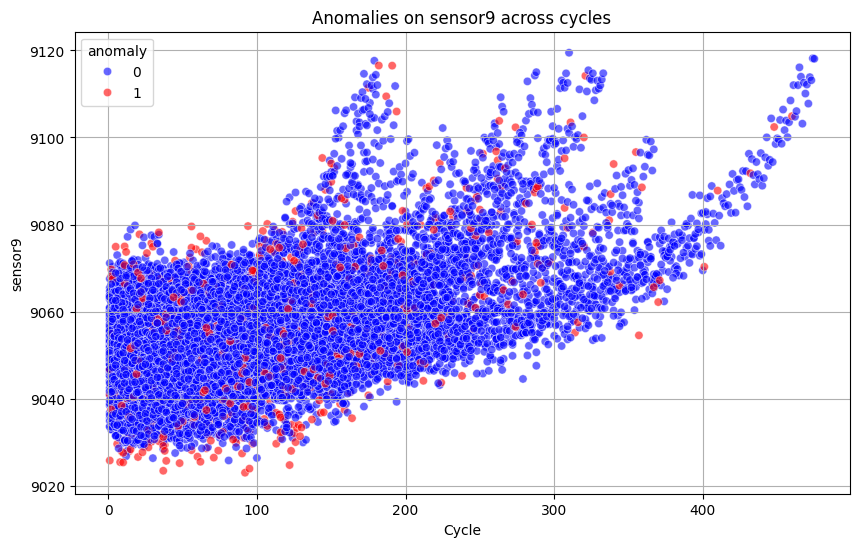

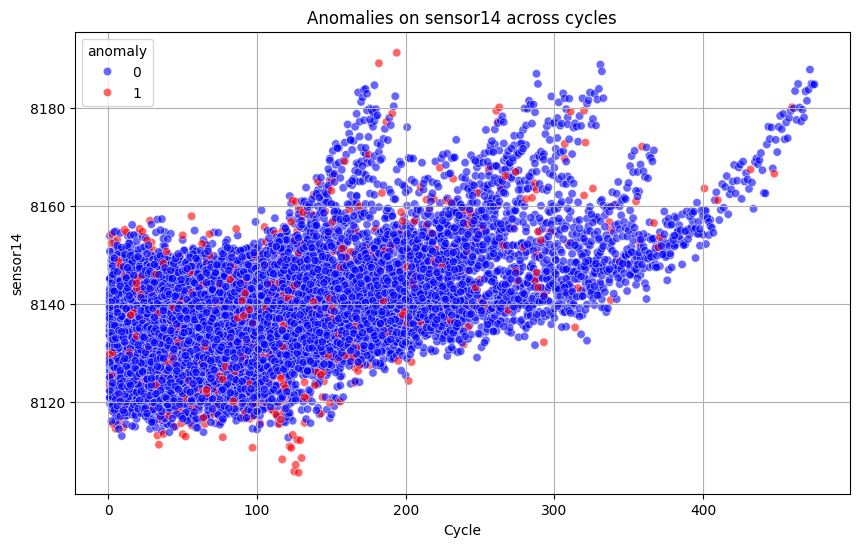

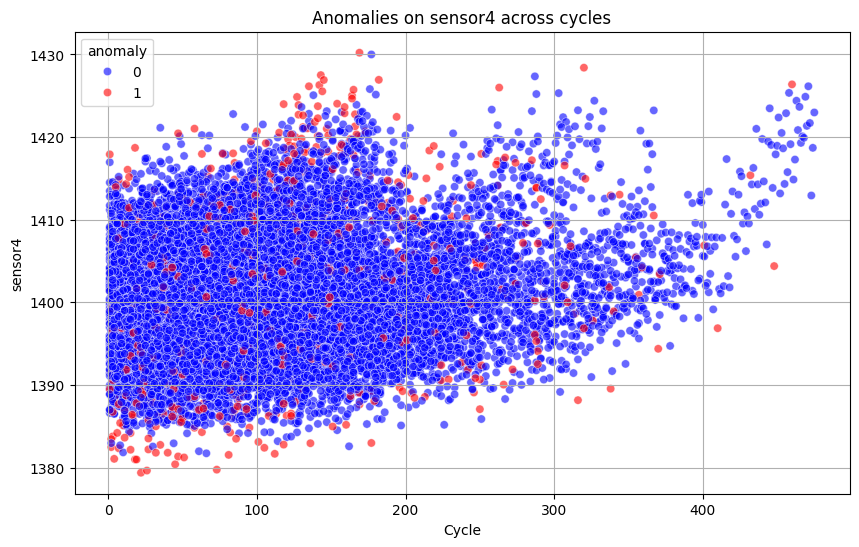

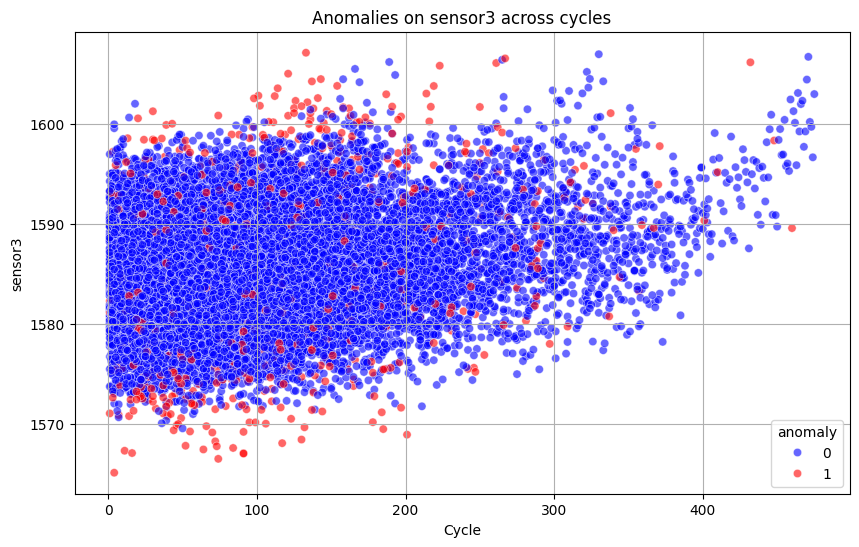

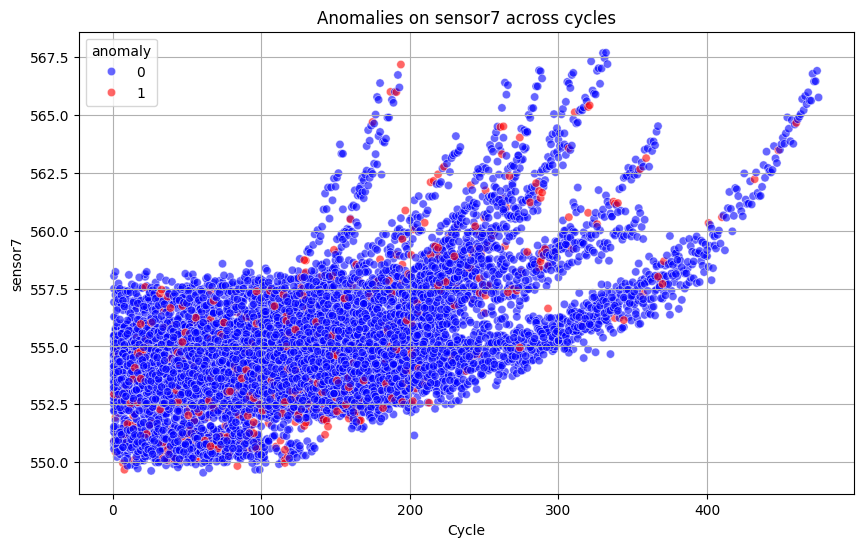

Shape after removing anomalies: (15766, 28)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files


uploaded = files.upload()
file_path = "test_FD003.txt"


df = pd.read_csv(file_path, sep=" ", header=None)
df.drop(columns=[26, 27], inplace=True)
df.columns = ['engine', 'cycle', 'setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


rul_df = df.groupby('engine', as_index=False)['cycle'].max()
rul_df.columns = ['engine', 'max_cycle']
df = pd.merge(df, rul_df, on='engine', how='left')
df['RUL'] = df['max_cycle'] - df['cycle']
df['RUL'] = df['RUL'].clip(upper=125)
df.drop(columns=['max_cycle'], inplace=True)

# Applying Local Outlier Factor (LOF)
sensor_cols = [col for col in df.columns if col.startswith('sensor')]
X = df[sensor_cols]

lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
y_pred = lof.fit_predict(X)
df['anomaly'] = np.where(y_pred == -1, 1, 0)

# Create synthetic ground truth for evaluation
y_true = np.zeros(len(df))
anomaly_indices = np.random.choice(df.index, size=int(0.05 * len(df)), replace=False)
y_true[anomaly_indices] = 1


print("Classification Report (LOF vs Synthetic Anomalies):")
print(classification_report(y_true, df['anomaly']))

# Identifying top contributing sensors to anomalies
anomaly_df = df[df['anomaly'] == 1]
normal_df = df[df['anomaly'] == 0]

sensor_variances = {
    sensor: abs(anomaly_df[sensor].var() - normal_df[sensor].var())
    for sensor in sensor_cols
}
top_sensors = sorted(sensor_variances, key=sensor_variances.get, reverse=True)[:5]

print("\nTop sensors contributing to anomalies based on variance difference:")
print(top_sensors)

# Plot anomalies across top sensors
for sensor in top_sensors:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='cycle', y=sensor, data=df, hue='anomaly', palette={0: "blue", 1: "red"}, alpha=0.6)
    plt.title(f"Anomalies on {sensor} across cycles")
    plt.xlabel("Cycle")
    plt.ylabel(sensor)
    plt.grid(True)
    plt.show()


df_clean_test_3 = df[df['anomaly'] == 0].reset_index(drop=True)
print(f"Shape after removing anomalies: {df_clean_test_3.shape}")


Saving test_FD004.txt to test_FD004 (1).txt
Classification Report (LOF vs Synthetic Anomalies):
              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95     39154
         1.0       0.05      0.05      0.05      2060

    accuracy                           0.90     41214
   macro avg       0.50      0.50      0.50     41214
weighted avg       0.90      0.90      0.90     41214


Top sensors contributing to anomalies based on variance difference:
['sensor13', 'sensor18', 'sensor8', 'sensor9', 'sensor14']


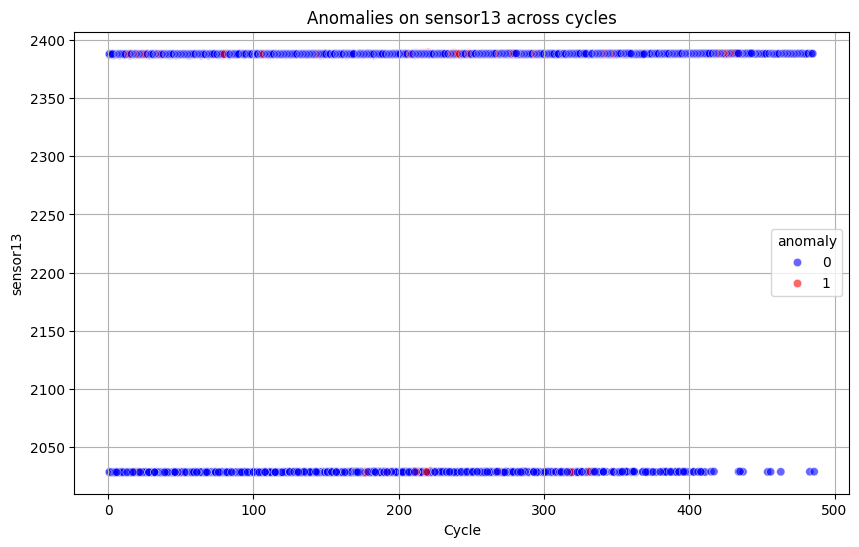

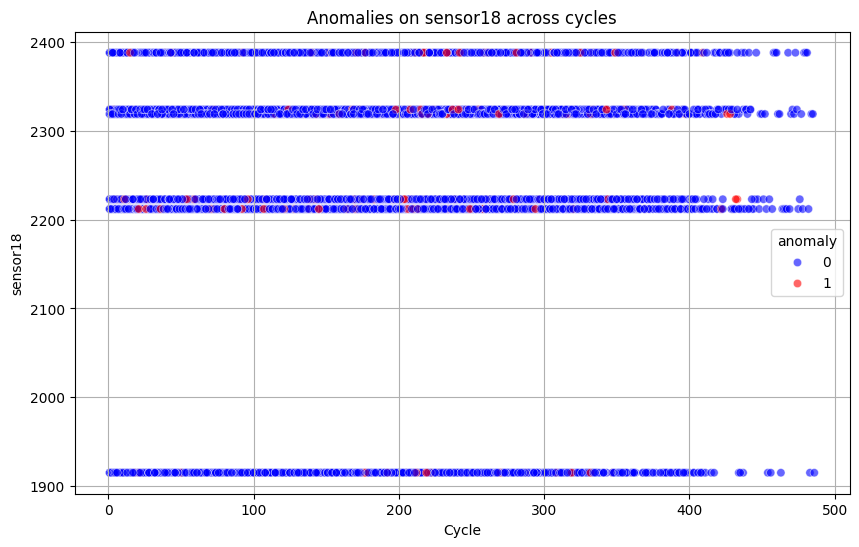

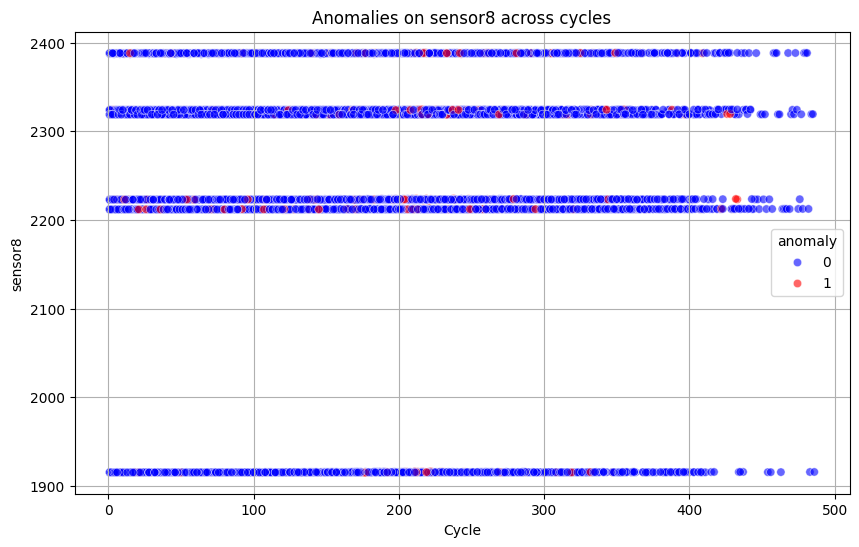

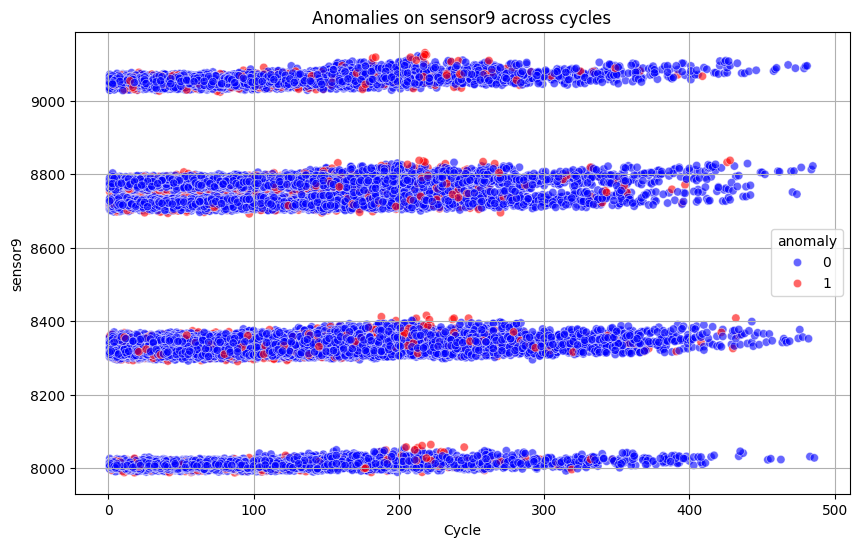

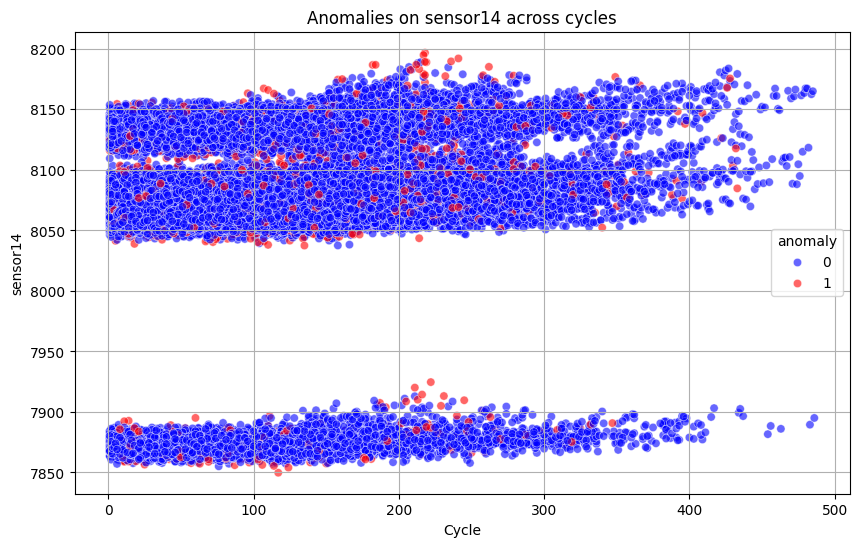

Shape after removing anomalies: (39153, 28)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files


uploaded = files.upload()
file_path = "test_FD004.txt"


df = pd.read_csv(file_path, sep=" ", header=None)
df.drop(columns=[26, 27], inplace=True)
df.columns = ['engine', 'cycle', 'setting1', 'setting2', 'setting3'] + [f'sensor{i}' for i in range(1, 22)]


rul_df = df.groupby('engine', as_index=False)['cycle'].max()
rul_df.columns = ['engine', 'max_cycle']
df = pd.merge(df, rul_df, on='engine', how='left')
df['RUL'] = df['max_cycle'] - df['cycle']
df['RUL'] = df['RUL'].clip(upper=125)
df.drop(columns=['max_cycle'], inplace=True)

# Applying Local Outlier Factor (LOF)
sensor_cols = [col for col in df.columns if col.startswith('sensor')]
X = df[sensor_cols]

lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
y_pred = lof.fit_predict(X)
df['anomaly'] = np.where(y_pred == -1, 1, 0)

# Creating synthetic ground truth for evaluation
y_true = np.zeros(len(df))
anomaly_indices = np.random.choice(df.index, size=int(0.05 * len(df)), replace=False)
y_true[anomaly_indices] = 1


print("Classification Report (LOF vs Synthetic Anomalies):")
print(classification_report(y_true, df['anomaly']))

# Identifying top contributing sensors to anomalies
anomaly_df = df[df['anomaly'] == 1]
normal_df = df[df['anomaly'] == 0]

sensor_variances = {
    sensor: abs(anomaly_df[sensor].var() - normal_df[sensor].var())
    for sensor in sensor_cols
}
top_sensors = sorted(sensor_variances, key=sensor_variances.get, reverse=True)[:5]

print("\nTop sensors contributing to anomalies based on variance difference:")
print(top_sensors)

# Plotting anomalies across top sensors
for sensor in top_sensors:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='cycle', y=sensor, data=df, hue='anomaly', palette={0: "blue", 1: "red"}, alpha=0.6)
    plt.title(f"Anomalies on {sensor} across cycles")
    plt.xlabel("Cycle")
    plt.ylabel(sensor)
    plt.grid(True)
    plt.show()


df_clean_test_4 = df[df['anomaly'] == 0].reset_index(drop=True)
print(f"Shape after removing anomalies: {df_clean_test_4.shape}")
